#  <center> Projet AAA </center>
##  <center> Predict CO2 Emissions in Rwanda </center>

Ce notebook est accessible sur [Github](https://github.com/Seb2509/Predict-CO2-Emissions-in-Rwanda)

Dans ce projet nous travaillerons avec la base de donnée [Predict CO2 Emissions in Rwanda](https://www.kaggle.com/competitions/playground-series-s3e20/data) disponible sur Kaggle. **L'objectif** sera de déterminer les **émissions de CO2** pour la période de Novembre 2022, c'est donc un problème de **régression**. Pour ce faire, nous disposons des données répartis sur 497 locations au Rwanda et receuillis durant les années 2019 à 2021. Ces données sont composées de mesures prises de manière hebdomadaire : dioxyde de sulfure, monoxyde de carbone, dioxydes d'azote, formaldéhyde, l'index d'aérosol UV, l'ozone et les nuages.

Faisons un rapide rappel des types de données que nous possédons :
    
- Dioxyde de sulfure (SO2) : il est présent dans l'atmosphère à la fois de manière naturelle et majoritairement de manière anthropique (70%). Ces émission affectent la santé humaine et la qualité d'air et perturbent le trafic aérien.
    
- Monoxyde de carbone (CO) : l'un des principaux polluants à certains endroits, qui provient majoritairement de la combustion des hydrocarbures, des biomasses et de l'oxydation du méthane. 
    
- Dioxydes d'azote (NO et NO2) : il est aussi présent à la fois de manière naturelle (feux de forêt, foudre...) et de manière anthropologique (combustion des carburants fossils et des biomasses).
    
- Formaldéhyde (HCHO) : il est majoritairement produit par l'oxydation du CH4 et ses variations de concentration dans l'atmosphère sont principalement dus aux changements de température et aux incendies. 
    
- L'index d'aérosol UV : L'AAI(Absorbing aerosol index) est basé sur les changements de diffusion Rayleigh dépendant de la longueur d'onde dans la plage spectrale UV pour une paire de longueurs d'onde. La différence entre la réflectance observée et modélisée résulte dans l'AAI. Lorsque l’AAI est positif, cela indique la présence d’aérosols absorbant les UV comme la poussière et la fumée. Il est utile pour suivre l’évolution des panaches d’aérosols épisodiques dus aux épidémies de poussière, aux cendres volcaniques et à la combustion de biomasse.
    
- L'ozone (O3) : dans l'atmosphère, les couches d'ozone protègent des dangereuses radiations UV, et dans la troposphère, il agit comme un excellent agent nettoyant mais si il est présent en de trop grandes concentrations, il est nocif pour les êtres vivants : humains, animaux et plantes.

Les données recueillis proviennent du satellite Sentinel-5 Precursor, qui est le premier satellite du programme Copernicus dédié à la surveillance de notre atmonsphère. Sa mission est de transporter le TROPOspheric Monitoring Instrument (TROPOMI), qui a pour objectif principal de prendre des mesures atmosphériques avec une grande précision sur la qualité de l'air, l'ozone, les radiations UV, et de manière plus générale, la surveillance du climat ainsi que sa prévision. 

Le Sentinel-5P résulte d'une étroite collaboration entre l'esa (agence spatiale européenne), la comission européenne, l'agence spatiale néerlandaise, les acteurs de l'industrie, les utilisateurs de données et les scientifiques. Il a été lancé avec succès le 13 octobre 2017 du comsodrome de Plesetsk en Russie. 

Ce jeu de données est composé de 77 champs, nous allons nous concentrer sur certains d'entre eux pour essayer de comprendre de quoi il s'agit. La plupart des champs correspondent aux mêmes types de mesure, mais sont déclinés en plusieurs fois selon la molécule étudié (SO2, CO, O3...) :

_ ***_column_number_density_*** : correspond simplement à la concentration dans l'air de la molécule gazeuse en question. 

Pour comprendre les champs suivants, il faut d'abord comprendre comment le satellite Sentinel 5P fonctionne pour prendre ses mesures, il utilise la méthode DOAS (Different Optical Absporption Spectroscopy) qui consiste en deux étapes. Cette méthode sert à adapter l'absorption différentielle au spectre de rayonnement terrestre normalisé par le soleil mesuré, pour obtenir la densité de la colonne inclinée (slant column density).

Ensuite, la densité de colonne inclinée sert à calculer la densité de colonne verticale en utilisant le facteur de masse d'air. Ce facteur de masse d'air peut inclure une correction des effets causés par les nuages afin de bien compter les quantités de traces de gaz cachées par les nuages. 

Plus d'informations sur le lien suivant : 
https://sentinels.copernicus.eu/web/sentinel/technical-guides/sentinel-5p/level-2/doas-method

Selon l'image du lien ci-dessus, on observe donc qu'on peut créer un repère expliquant l'observation selon la position du soleil et du satellite. L'origine du repère correspond à la position de l'endroit étudié, et les axes du repère x, y correspondent à la latitude et la longitude, là où l'axe z correspond au zenith. 

_ ***_slant_column_number_density_*** : c'est donc la densité inclinée calculée par le satellite avant le calcul de la densité réelle. 

_ ***_cloud_fraction_*** : il s'agit donc de la correction comprise dans le facteur de masse d'air permettant d'inclure les effets des nuages, cela correspond au pourcentage de chaque pixel d'image satellite couvert par un uage dans une image quadrillée d'un modèle cliamtique ou météorologique. 

_ ***_sensor_azimuth_angle_*** : cela correspond donc à l'angle entre l'axe x de la latitude et la projection du satellite sur le plan (x,y), (cf schéma site). 

_ ***_sensor_zenith_angle_*** : c'est l'angle entre le zenith (axe z) et la droite reliant le satellite à l'origine (notre position étudié). 

_ ***_solar_azimuth_angle_*** : à l'inverse il s'agit cette fois de l'angle entre l'axe x de la latitude et la projection du soleil sur le plan (x,y).

_ ***_solar_zenith_angle_*** : de même, c'est l'angle entre le zenith (axe z) et la droite reliant le soleil à l'origine (notre position étudié).

## Sommaire

#### Partie 1 : Téléchargement et observation des données:
- Téléchargement des données
- Observastion générale des données
- Target emission
- Données manquantes

#### Partie 2 : Exploration des données
- Détermination de la corrélation des données
- Visualisation des données
- Visualisation des emissions dans l'espace
- Visualisation des emissions dans le temps
- Le croisement des caractéristiques temporelle et spaciale
- Les caractéristiques temporelles et les semaines de surconsomations

#### Partie 3 : Transformation de la donnée - Pipeline
- Nettoyage des données
- Pipeline
- Séparation des données

#### Partie 4 : Les différents modèles prédictifs
- Sélectionner une mesure de performance
- Régression Linéaire
- K Nearest Neighbors
- Gradient Boosting 
- Random Forest
- Support Vector Regression
- Neural Network

#### Partie 5 : Recherche des hyperparamètres
- K Nearest Nieghbors
- Gradient Boosting  
- Random forest

#### Partie 6 : Comparaison des différents modèles
- Cross Validation
- Comparaison des modèles  
- Final Submission

## Source extérieur :

- S'inspirer des différents [notebook](https://www.kaggle.com/competitions/playground-series-s3e20/code) sur Kaggle
- S'inspirer des [notebook](https://docs.google.com/spreadsheets/d/1fkLohtPWsWb6248kjJif3oKdnhchyAibotulFd1HKoU/edit#gid=1313837007) des gens de la classe

##### Configuration de Kaggle

Installer la librerie de **Kaggle**

In [1]:
!pip install kaggle

In [2]:
!pip install geopandas folium 

## Partie 1 - Téléchargement et observation des données

### 1. Téléchargement des données

In [1]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import numpy as np

# Enable interactive mode in Jupyter Notebook or IPython
%matplotlib notebook

data_train = pd.read_csv("train.csv")
data_train.head()

,ID_LAT_LON_YEAR_WEEK,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,...,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission
0,ID_-0.510_29.290_2019_00,-0.51,29.29,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,...,3664.436218,61085.809570,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994
1,ID_-0.510_29.290_2019_01,-0.51,29.29,2019,1,0.000021,0.728214,0.000014,0.130988,16.592861,...,3651.190311,66969.478735,3174.572424,8.690601,0.256830,30.359375,39.557633,-145.183930,27.251779,4.025176
2,ID_-0.510_29.290_2019_02,-0.51,29.29,2019,2,0.000514,0.748199,0.000385,0.110018,72.795837,...,4216.986492,60068.894448,3516.282669,21.103410,0.251101,15.377883,30.401823,-142.519545,26.193296,4.231381
3,ID_-0.510_29.290_2019_03,-0.51,29.29,2019,3,NaN,NaN,NaN,NaN,NaN,...,5228.507736,51064.547339,4180.973322,15.386899,0.262043,-11.293399,24.380357,-132.665828,28.829155,4.305286
4,ID_-0.510_29.290_2019_04,-0.51,29.29,2019,4,-0.000079,0.676296,-0.000048,0.121164,4.121269,...,3980.598120,63751.125781,3355.710107,8.114694,0.235847,38.532263,37.392979,-141.509805,22.204612,4.347317


Pas besoin de spliter les données en train et test puisque le site fournit une base de donnée test

### 2. Observation générale des données

In [2]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79023 entries, 0 to 79022
Data columns (total 76 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   ID_LAT_LON_YEAR_WEEK                                      79023 non-null  object 
 1   latitude                                                  79023 non-null  float64
 2   longitude                                                 79023 non-null  float64
 3   year                                                      79023 non-null  int64  
 4   week_no                                                   79023 non-null  int64  
 5   SulphurDioxide_SO2_column_number_density                  64414 non-null  float64
 6   SulphurDioxide_SO2_column_number_density_amf              64414 non-null  float64
 7   SulphurDioxide_SO2_slant_column_number_density            64414 non-null  float64
 8   SulphurDioxide_c

In [2]:
# Supprimer la troncature des colonnes (afficher toutes les colonnes)
pd.set_option('display.max_columns', 76)

# Supprimer la troncature des lignes (afficher toutes les lignes)
pd.set_option('display.max_rows', 76)

A part ID_LAT_LON_YEAR_WEEK les données sont toutes numérique                  

In [4]:
data_train.describe()

,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,SulphurDioxide_solar_azimuth_angle,SulphurDioxide_solar_zenith_angle,SulphurDioxide_SO2_column_number_density_15km,CarbonMonoxide_CO_column_number_density,CarbonMonoxide_H2O_column_number_density,CarbonMonoxide_cloud_height,CarbonMonoxide_sensor_altitude,CarbonMonoxide_sensor_azimuth_angle,CarbonMonoxide_sensor_zenith_angle,CarbonMonoxide_solar_azimuth_angle,CarbonMonoxide_solar_zenith_angle,NitrogenDioxide_NO2_column_number_density,NitrogenDioxide_tropospheric_NO2_column_number_density,NitrogenDioxide_stratospheric_NO2_column_number_density,NitrogenDioxide_NO2_slant_column_number_density,NitrogenDioxide_tropopause_pressure,NitrogenDioxide_absorbing_aerosol_index,NitrogenDioxide_cloud_fraction,NitrogenDioxide_sensor_altitude,NitrogenDioxide_sensor_azimuth_angle,NitrogenDioxide_sensor_zenith_angle,NitrogenDioxide_solar_azimuth_angle,NitrogenDioxide_solar_zenith_angle,Formaldehyde_tropospheric_HCHO_column_number_density,Formaldehyde_tropospheric_HCHO_column_number_density_amf,Formaldehyde_HCHO_slant_column_number_density,Formaldehyde_cloud_fraction,Formaldehyde_solar_zenith_angle,Formaldehyde_solar_azimuth_angle,Formaldehyde_sensor_zenith_angle,Formaldehyde_sensor_azimuth_angle,UvAerosolIndex_absorbing_aerosol_index,UvAerosolIndex_sensor_altitude,UvAerosolIndex_sensor_azimuth_angle,UvAerosolIndex_sensor_zenith_angle,UvAerosolIndex_solar_azimuth_angle,UvAerosolIndex_solar_zenith_angle,Ozone_O3_column_number_density,Ozone_O3_column_number_density_amf,Ozone_O3_slant_column_number_density,Ozone_O3_effective_temperature,Ozone_cloud_fraction,Ozone_sensor_azimuth_angle,Ozone_sensor_zenith_angle,Ozone_solar_azimuth_angle,Ozone_solar_zenith_angle,UvAerosolLayerHeight_aerosol_height,UvAerosolLayerHeight_aerosol_pressure,UvAerosolLayerHeight_aerosol_optical_depth,UvAerosolLayerHeight_sensor_zenith_angle,UvAerosolLayerHeight_sensor_azimuth_angle,UvAerosolLayerHeight_solar_azimuth_angle,UvAerosolLayerHeight_solar_zenith_angle,Cloud_cloud_fraction,Cloud_cloud_top_pressure,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission
count,79023.000000,79023.000000,79023.000000,79023.000000,64414.000000,64414.000000,64414.000000,64414.000000,64414.000000,64414.000000,64414.000000,64414.000000,64414.000000,76901.000000,76901.000000,76901.000000,76901.000000,76901.000000,76901.000000,76901.000000,76901.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,60703.000000,71746.000000,71746.000000,71746.000000,71746.000000,71746.000000,71746.000000,71746.000000,71746.000000,78484.000000,78484.000000,78484.000000,78484.000000,78484.000000,78484.000000,78475.000000,78475.000000,78475.000000,78475.000000,78475.000000,78475.000000,78475.000000,78475.000000,78475.000000,439.000000,439.000000,439.000000,439.000000,439.000000,439.000000,439.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,78539.000000,79023.000000
mean,-1.891072,29.880155,2020.000000,26.000000,0.000048,0.834848,0.000035,0.158418,-7.925870,37.436189,-83.833174,27.722311,0.000015,0.033158,2113.906233,2821.590722,829938.633762,-7.331051,37.846794,-86.049580,27.767024,0.000044,0.000012,0.000032,0.000097,8922.568995,-1.812155,0.097008,829994.224471,-15.937696,36.852637,-84.260082,28.316388,0.000127,1.254134,0.000084,0.228801,27.887813,-84.605844,40.478057,-9.396089,-1.342787,829974.542096,-12.739997,39.962875,-86.548895,28.052553,0.117343,2.609890,0.310802,228.625917,0.569107,-13.1087

### 3. Target : emission

**Machine learning suppervisé** étant donnée qu'il existe une étiquette pour chaque ensemble de caractèritique.

In [5]:
count_emission = data_train['emission'].value_counts()

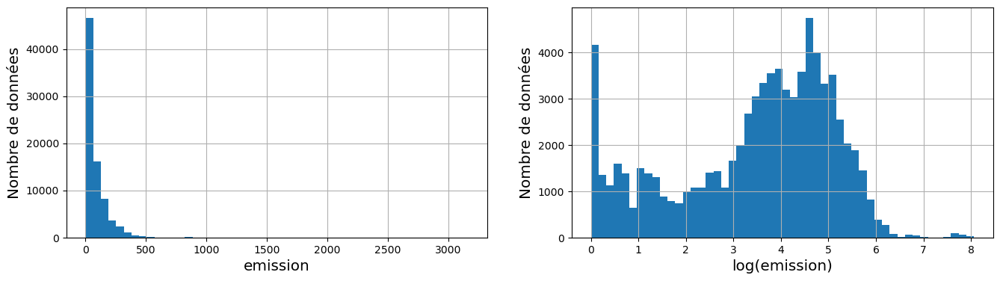

In [6]:
plt.figure(figsize=(16,4))
plt.subplot(1,2,1)
data_train['emission'].hist(bins=50)
plt.xlabel('emission',fontsize='x-large')
plt.ylabel('Nombre de données',fontsize='x-large')
plt.subplot(1,2,2)
np.log1p(data_train['emission']).hist(bins=50)
plt.xlabel('log(emission)',fontsize='x-large')
plt.ylabel('Nombre de données',fontsize='x-large')
plt.show()

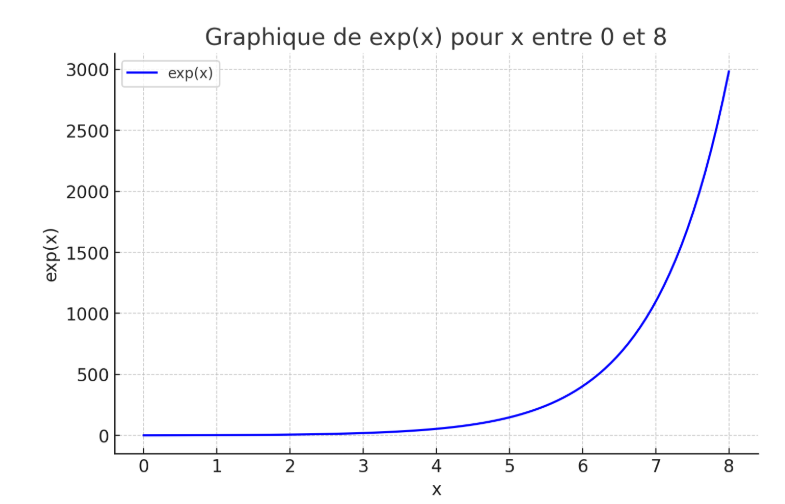

La target emission est une donnée continue donc la résolution se fera à l'aide d'une **regression univariée**.

La distribution de la target emission est asymétrique vers la droite, cela signifie que la majorité des valeurs sont concentrées du côté gauche de la distribution, avec quelques valeurs extrêmement élevées du côté droit. Une transformation logarithmique est une technique courante pour traiter ce type d'asymétrie.

En conséquence, cela peut aider à réduire l'impact des valeurs extrêmement élevées, rendant ainsi la distribution des étiquettes plus proche d'une distribution normale (ou gaussienne), qui est souvent souhaitable dans de nombreux modèles de machine learning.

### 4. Données manquantes

Il est important qu'il n'y ait pas de données manquante, sans quoi nous ne pourrons pas utilisés les données pour faire fonctionner notre modèle et prédire les prochaines émissions.

In [7]:
data_train.isna().sum()

ID_LAT_LON_YEAR_WEEK                                            0
latitude                                                        0
longitude                                                       0
year                                                            0
week_no                                                         0
SulphurDioxide_SO2_column_number_density                    14609
SulphurDioxide_SO2_column_number_density_amf                14609
SulphurDioxide_SO2_slant_column_number_density              14609
SulphurDioxide_cloud_fraction                               14609
SulphurDioxide_sensor_azimuth_angle                         14609
SulphurDioxide_sensor_zenith_angle                          14609
SulphurDioxide_solar_azimuth_angle                          14609
SulphurDioxide_solar_zenith_angle                           14609
SulphurDioxide_SO2_column_number_density_15km               14609
CarbonMonoxide_CO_column_number_density                      2122
CarbonMono

Il manque quelques données compte tenu de la quantité importante de donnée récolté on pourra soit:
- supprimer les colonnes trop incomplètes
- supprimer les lignes de données incomplètes
- compléter les données manquante à l'aide d'une pipeline

#### Observons visuellement cette donnée manquante

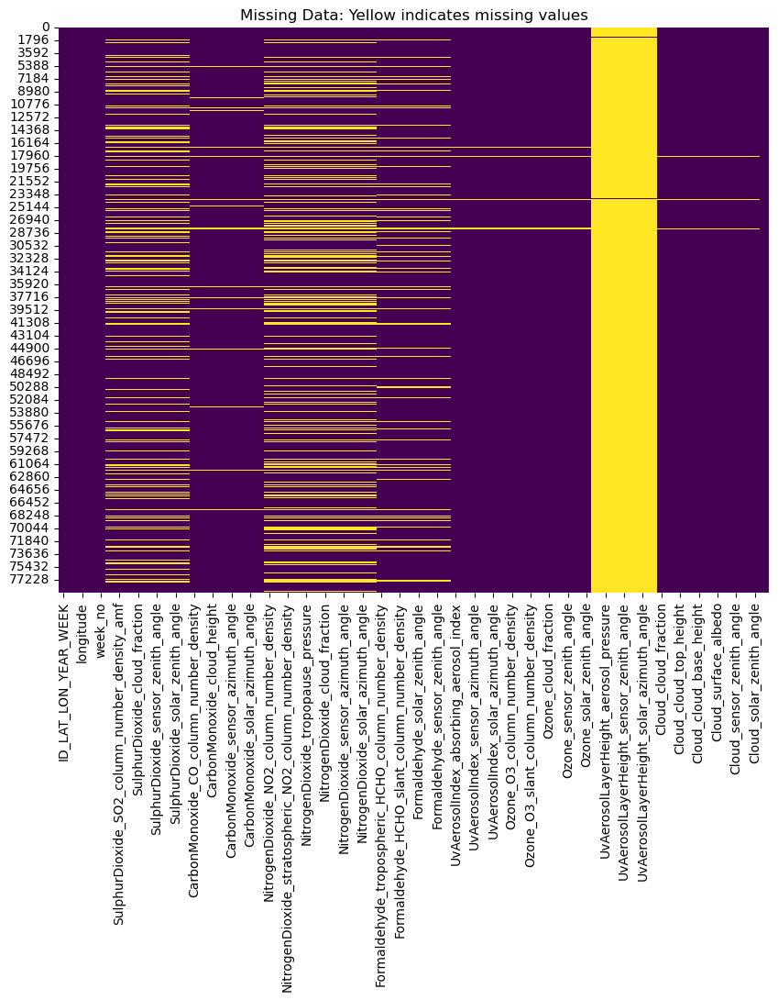

In [8]:
# Assuming data_train is your DataFrame
plt.figure(figsize=(10, 8))
sns.heatmap(data_train.isnull(), cmap='viridis', cbar=False)
plt.title('Missing Data: Yellow indicates missing values')
plt.show()

On observe que les données manquantes suivent des paternes réguliers. En effet lorsqu'il manque une donnée sur une caractéristique, celle ci manque à l'ensemble des caractéristique de ce même gaz. Peut être qu'il existe également un patterne liée à une periodicité temporelle, que l'on pourra repéré en déterminant une corrélation avec week_no. Peut être qu'il existe également une récurrence de donnée manquante sur une station particulière signalent un problème de prélèvement à une localisation particulière, ce que l'on pourra étudier en jettant un coup d'oeil aux lattitude et longitude des données manquantes.

#### Première possibilité : supprimer les colonnes trop incomplètes

En effet comme on peut le voir sur le graph des données manquante ou encore numériquement ci-dessous : les données liées à l'**UVAerosolLayerHeight** manque grandement 78 584/ 79 023. Il serait alors grandement tentant de s'en débarasser.

In [9]:
donnee_manquante = data_train.isna().sum()
donnee_manquante_sorted = donnee_manquante.sort_values(ascending=False)
print(donnee_manquante_sorted)

UvAerosolLayerHeight_aerosol_height                         78584
UvAerosolLayerHeight_solar_zenith_angle                     78584
UvAerosolLayerHeight_solar_azimuth_angle                    78584
UvAerosolLayerHeight_sensor_azimuth_angle                   78584
UvAerosolLayerHeight_aerosol_pressure                       78584
UvAerosolLayerHeight_aerosol_optical_depth                  78584
UvAerosolLayerHeight_sensor_zenith_angle                    78584
NitrogenDioxide_tropopause_pressure                         18320
NitrogenDioxide_stratospheric_NO2_column_number_density     18320
NitrogenDioxide_NO2_slant_column_number_density             18320
NitrogenDioxide_cloud_fraction                              18320
NitrogenDioxide_absorbing_aerosol_index                     18320
NitrogenDioxide_NO2_column_number_density                   18320
NitrogenDioxide_sensor_altitude                             18320
NitrogenDioxide_sensor_azimuth_angle                        18320
NitrogenDi

Cependant nous verrons plus tard que les données caractérisant l'**UVAerosolLayerHeight** ont une forte corrélation avec les emissions carbone ayant le 2e et 3e meilleur coefficient de correlation après la longitude (sans considérer de combinaison).

Ce n'est donc à priori **pas une bonne solution** de supprimer ces colones pour se débarasser des colones ayant des données manquante. 

#### Deuxième possibilité : supprimer les lignes de données incomplètes

Récuperons la liste du nom des colonnes

In [10]:
column_names = data_train.columns.to_list()

In [11]:
#On se débarasse des ligne telle que moyenne_classement = NaN
data_train_complet = data_train.dropna(subset=column_names)
data_train_complet 

,ID_LAT_LON_YEAR_WEEK,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,SulphurDioxide_solar_azimuth_angle,SulphurDioxide_solar_zenith_angle,SulphurDioxide_SO2_column_number_density_15km,CarbonMonoxide_CO_column_number_density,CarbonMonoxide_H2O_column_number_density,CarbonMonoxide_cloud_height,CarbonMonoxide_sensor_altitude,CarbonMonoxide_sensor_azimuth_angle,CarbonMonoxide_sensor_zenith_angle,CarbonMonoxide_solar_azimuth_angle,CarbonMonoxide_solar_zenith_angle,NitrogenDioxide_NO2_column_number_density,NitrogenDioxide_tropospheric_NO2_column_number_density,NitrogenDioxide_stratospheric_NO2_column_number_density,NitrogenDioxide_NO2_slant_column_number_density,NitrogenDioxide_tropopause_pressure,NitrogenDioxide_absorbing_aerosol_index,NitrogenDioxide_cloud_fraction,NitrogenDioxide_sensor_altitude,NitrogenDioxide_sensor_azimuth_angle,NitrogenDioxide_sensor_zenith_angle,NitrogenDioxide_solar_azimuth_angle,NitrogenDioxide_solar_zenith_angle,Formaldehyde_tropospheric_HCHO_column_number_density,Formaldehyde_tropospheric_HCHO_column_number_density_amf,Formaldehyde_HCHO_slant_column_number_density,Formaldehyde_cloud_fraction,Formaldehyde_solar_zenith_angle,Formaldehyde_solar_azimuth_angle,Formaldehyde_sensor_zenith_angle,Formaldehyde_sensor_azimuth_angle,UvAerosolIndex_absorbing_aerosol_index,UvAerosolIndex_sensor_altitude,UvAerosolIndex_sensor_azimuth_angle,UvAerosolIndex_sensor_zenith_angle,UvAerosolIndex_solar_azimuth_angle,UvAerosolIndex_solar_zenith_angle,Ozone_O3_column_number_density,Ozone_O3_column_number_density_amf,Ozone_O3_slant_column_number_density,Ozone_O3_effective_temperature,Ozone_cloud_fraction,Ozone_sensor_azimuth_angle,Ozone_sensor_zenith_angle,Ozone_solar_azimuth_angle,Ozone_solar_zenith_angle,UvAerosolLayerHeight_aerosol_height,UvAerosolLayerHeight_aerosol_pressure,UvAerosolLayerHeight_aerosol_optical_depth,UvAerosolLayerHeight_sensor_zenith_angle,UvAerosolLayerHeight_sensor_azimuth_angle,UvAerosolLayerHeight_solar_azimuth_angle,UvAerosolLayerHeight_solar_zenith_angle,Cloud_cloud_fraction,Cloud_cloud_top_pressure,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission
155,ID_-0.510_29.290_2021_49,-0.510,29.290,2021,49,0.000024,0.895098,0.000040,0.073222,-42.108062,26.770401,-132.844392,33.546160,0.000003,0.030970,2556.106652,3280.009332,829858.576154,-29.210793,36.801739,-134.264186,33.252706,0.000044,0.000002,0.000042,0.000099,8613.450610,-0.981609,0.033974,829937.068392,-42.107221,26.770407,-132.854077,33.550248,0.000070,1.462100,0.000071,0.189680,31.989110,-135.876684,33.465653,-13.398411,-0.575465,829928.555029,-41.603930,41.575903,-132.653003,34.679911,0.112337,2.699121,0.307100,227.663684,0.369818,-41.603930,41.575903,-132.653003,34.679911,4361.903364,59598.891226,1.489176,9.361630,-102.090004,-132.497574,33.436649,0.453529,58866.697087,5019.467594,66195.733910,4045.293055,29.389584,0.267237,-64.947208,44.180872,-131.574370,35.591652,4.687898
451,ID_-0.547_29.653_2021_27,-0.547,29.653,2021,27,0.000084,0.724555,0.000090,0.158538,4.135166,36.405689,-36.356835,30.201735,0.000050,0.045407,2299.506004,1480.778604,829796.507689,3.490167,36.533946,-36.361105,30.204257,0.000064,0.000027,0.000037,0.000118,10872.579892,-1.234751,0.082964,829821.819001,4.135166,36.405689,-36.356835,30.201735,0.000245,1.027666,0.000174,0.158538,30.201735,-36.356835,36.405689,4.135166,-1.017088,829884.388572,0.094461,34.335691,-38.947622,31.368917,0.118517,2.551222,0.306308,231.469340,0.399045,0.094461,34.335691,-38.947623,31.368917,2527.331130,75107.674126,0.179235,63.084564,71.699699,-22.821898,25.358990,0.432088,67202.468184,3786.135092,73589.75915

In [12]:
print("Quantité de date total : ", data_train.count().max())
print("Quantité de date complète : ", data_train_complet.count().max())

Quantité de date total :  79023
Quantité de date complète :  438


Supprimer les lignes de données incomplètes **n'est pas une solution** non plus

#### Troisième possibilité : compléter les données manquante à l'aide d'une pipeline

A priori c'est **la solution** qui s'y prête le mieux et elle sera aborder plus tard dans la **Partie 3 : Data transformation - Pipeline**

##  Partie 2 : Data exploration

### 1. Détermination de la corrélation des données

Determinons l'ensemble des coefficient de correlation entre les différentes caractéristique et la target emission.

**Remarque :** plus cette valeur est importante en valeur absolue et plus cette caractéristique est corrélé au emission carbone.

In [13]:
corr_matrix= data_train.corr()
corr_matrix["emission"].sort_values(ascending=False)

emission                                                    1.000000
longitude                                                   0.102746
UvAerosolLayerHeight_aerosol_height                         0.069008
Cloud_surface_albedo                                        0.046587
Formaldehyde_tropospheric_HCHO_column_number_density_amf    0.040263
UvAerosolLayerHeight_aerosol_optical_depth                  0.040156
UvAerosolLayerHeight_sensor_azimuth_angle                   0.035142
NitrogenDioxide_sensor_altitude                             0.027540
NitrogenDioxide_cloud_fraction                              0.022456
NitrogenDioxide_absorbing_aerosol_index                     0.020905
latitude                                                    0.017851
Ozone_O3_column_number_density                              0.013811
UvAerosolIndex_sensor_azimuth_angle                         0.008299
Ozone_sensor_azimuth_angle                                  0.007774
Cloud_sensor_azimuth_angle        

On observe que la longitude à une correlation importante avec les emissions carbone, mais on peut se demander si en la combinant avec la lattitude cette correlation ne serait pas plus imortante. Nous aborderons ce point dans la section : **3. Visualisation des emissions dans l'espace**

Comme nous avons déjà pu l'aborder les données lié à UvAerosolLayer sont plutôt corrélé aux emissions carbone bien que grandement manquante dans la base de donnée fournit.

On remarque que que les données temporelles week_no et year sont très peu corrélées au emission, mais on peut se demander si en la combinant avec les données spaciales leur correlations ne seront pas plus importante. Nous aborderons ce point dans la section : **4. Visualisation des emissions dans le temps**

#### Visualtion  de cette corrélation graphiquement

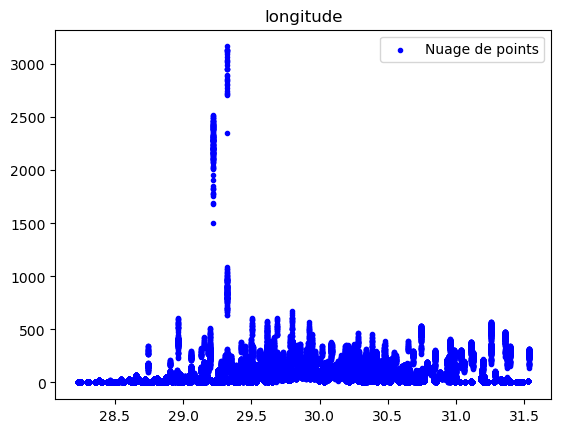

In [14]:
from matplotlib import pyplot as plt
#Hacemos histogramas de cada atributo para ver qué distribuciones tienen
for column in data_train.columns:
    if column=='longitude':
        x=data_train[column]
        y=data_train['emission']
        
        # Créer un nuage de points
        plt.scatter(x, y, label='Nuage de points', color='blue', marker='.')
        
        plt.title(column)
        plt.legend()
        plt.show()

On observe que globalement aucune caractéristique a une bonne corrélation avec les emissions carbone avec pour maximum la longitude qui a un coefficient de 0.10

#### Visualisons la corrélation enttre l'ensemble des attribus

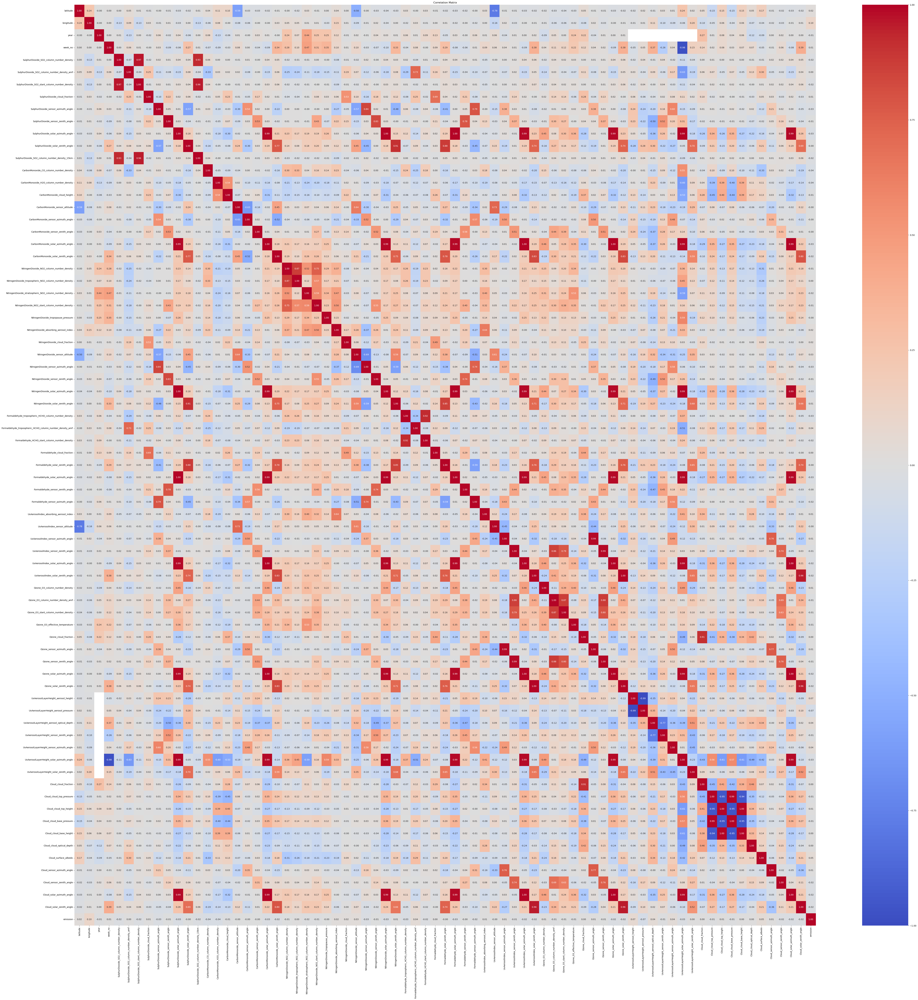

In [15]:
# Create a heatmap
plt.figure(figsize=(76,76))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title("Correlation Matrix")
plt.show()

Les caractéristiques de chaque gaz sont fortement corrélées entre elles.

### 2. Visualisation des données

Nous traiterons les données spacial et temporel à part. Traitons les autres données :

In [16]:
columns_to_remove = ['ID_LAT_LON_YEAR_WEEK', 'latitude', 'longitude', 'year', 'week_no', 'emission']

column_names_graph = [col for col in column_names if col not in columns_to_remove]
print(len(column_names_graph))

70


In [17]:
# Create a 5x14 grid of subplots
fig, axes = plt.subplots(nrows=14, ncols=5, figsize=(50, 150))

# Flatten the 2D array of subplots into a 1D array
axes = axes.flatten()

# Iterate through the column names and plot histograms
for i, column in enumerate(column_names_graph):
    ax = axes[i]
    data_train[column].hist(bins=100, ax=ax)
    ax.set_title(column)
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Adjust layout for better appearance
plt.tight_layout()

# Show the plot
plt.show()

Rien d'exploitable encore pour l'instant

### 3. Visualisation des emissions dans l'espace

Il y a 497 stations receuillant les données d'émission du Rwanda

#### Visualisons les émissions sur chacune de ces stations

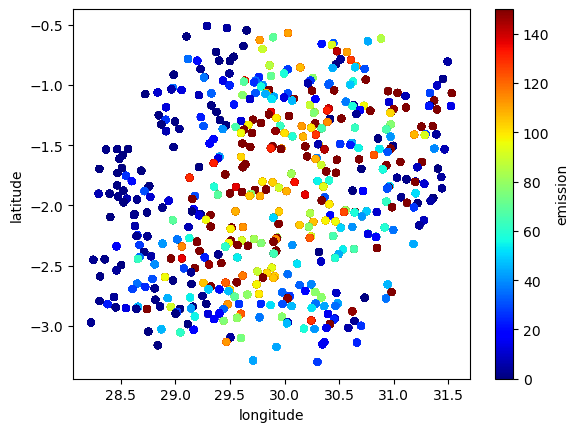

In [19]:
# You can adjust the number of bins for color sensitivity
data_train.plot(kind="scatter", x="longitude", y="latitude", c="emission", cmap= plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150)
plt.show()

Pour pouvoir bien différencier les points à forte emission on peut jouer avec la valeur vmax initialement à vmax=3000 et la descendre à vmax=150 afin de réduire la taille de fluctuation des valeurs et visualiser plus facilement les différences de valeurs d'émission.

Il faudrait calculer le coefficient de corrélation d'une donée combinant latitude et longitude

#### Le croisement des caractéristiques latitude et longitude

#### Première possibilité

Pour cela on pourrait se servir d'une **technique de binnage de la latitude et la longitude** en quadrillant la carte actuelle

- https://developers.google.com/machine-learning/crash-course/feature-crosses/programming-exercise?hl=fr
- https://colab.research.google.com/github/google/eng-edu/blob/main/ml/cc/exercises/representation_with_a_feature_cross.ipynb?utm_source=mlcc&utm_campaign=colab-external&utm_medium=referral&utm_content=representation_tf2-colab&hl=fr#scrollTo=WLTUFiaUyIpx


In [32]:
# Define resolution
resolution_in_degrees = 0.25

# Discretization for Latitude
latitude_data = np.array(data_train['latitude'])
latitude_buckets = np.digitize(latitude_data, bins=np.arange(int(min(data_train['latitude'])),
                                                              int(max(data_train['latitude'])),
                                                              resolution_in_degrees))

# Discretization for Longitude
longitude_data = np.array(data_train['longitude'])
longitude_buckets = np.digitize(longitude_data, bins=np.arange(int(min(data_train['longitude'])),
                                                                int(max(data_train['longitude'])),
                                                                resolution_in_degrees))

# Combine Latitude and Longitude into a single integer representation
concatenated_data = latitude_buckets * 1000 + longitude_buckets

print(concatenated_data)

[10006 10006 10006 ...    10    10    10]


In [33]:
data_train["concatenated_data"]= concatenated_data
data_train[["latitude", "longitude", "concatenated_data"]]

,latitude,longitude,concatenated_data
0,-0.510,29.290,10006
1,-0.510,29.290,10006
2,-0.510,29.290,10006
3,-0.510,29.290,10006
4,-0.510,29.290,10006
...,...,...,...
79018,-3.299,30.301,10
79019,-3.299,30.301,10
79020,-3.299,30.301,10
79021,-3.299,30.301,10


Visualisons ce que donne la carte avec la segmentation réalisé

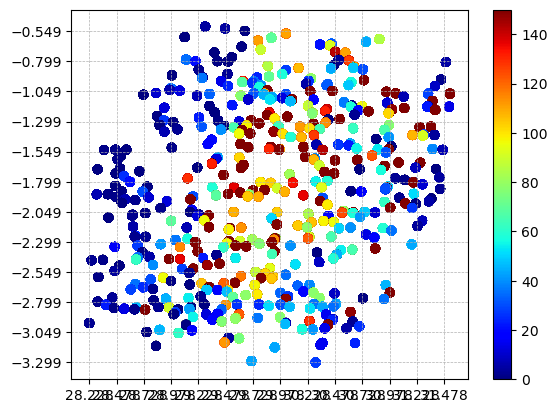

In [34]:
import matplotlib.pyplot as plt

# Supposons que data_train soit votre DataFrame pandas contenant les colonnes "longitude", "latitude" et "emission"

# Quadrillage tous les 0.25 degrés
latitude_step = 0.25
longitude_step = 0.25

# Tracé du nuage de points
plt.scatter(data_train["longitude"], data_train["latitude"], c=data_train["emission"], cmap=plt.get_cmap("jet"), vmin=0, vmax=150)
plt.colorbar()  # Ajoute une barre de couleur

# Quadrillage avec des lignes de grille tous les 0.25 degrés
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.xticks(np.arange(data_train["longitude"].min(), data_train["longitude"].max(), longitude_step))
plt.yticks(np.arange(data_train["latitude"].min(), data_train["latitude"].max(), latitude_step))

# Affichage du graphique
plt.show()

Verifions maintenant la corrélation entre cette caractéristique combinée et les emissions

In [35]:
corr_matrix= data_train.corr()
print("longitude : ", corr_matrix["emission"]["longitude"])
print("latitude : ", corr_matrix["emission"]["latitude"])
print("concatenated : ", corr_matrix["emission"]["concatenated_data"])

longitude :  0.1027464904365297
latitude :  0.017850558434491622
concatenated :  0.01735844117186969


On ne remarque aucune amélioration en concaténant les données. Pourtant visuellement on observe bien qu'il y a une corrélation entre emission carbonne et espace. Pour être plus précis les données d'emission semble suivre une **distribution circulaire**. En d'autre terme les valeurs d'un même cercle semble avoir des valeurs d'émission similaire.

#### Deuxième possibilité

Ainsi on pourrait combiner les caractéristique de latitude et de longitude en calculant **la distance R à laquel se situe chaque point du centre C=(x0,y0)**. Reste à determiner le centre de ce cercle C.

Cherchons le centre visuellement en réjustant progressivement

In [3]:
x0 = 29.75
y0 = -1.8

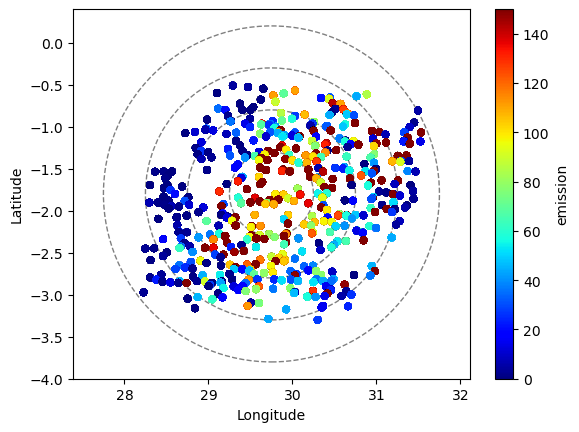

In [4]:
# Centre des coordonnées (exemple)
center_latitude = y0
center_longitude = x0

# Création des rayons avec un pas de 0.5 jusqu'à un certain maximum
max_radius = 2
radii = np.arange(0.5, max_radius + 0.5, 0.5)

# Création du graphique
fig, ax = plt.subplots()

# Dessiner les cercles
for radius in radii:
    circle = plt.Circle((center_longitude, center_latitude), radius, fill=False, color='grey', linestyle='dashed')
    ax.add_patch(circle)

# Ajouter les points de données
data_train.plot(kind="scatter", x="longitude", y="latitude", c="emission", cmap=plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150, ax=ax)

# Paramètres du graphique
ax.set_aspect('equal', adjustable='datalim')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Afficher le graphique
plt.show()

On observe bien sur ce graphique que le centre choisit est pertinent et que les données d'emissions suivent une distribution circulaire. On observe que plus le rayon est petit et plus les points ont une couleur chaude (rouge) et inverssement plus le rayon est grand et plus les point ont une couleur froide (bleu).

Calculons ce rayon avec la formule suivante :
$$R = \sqrt{\big(x - {x}_{0} \big)^2 + \big(y - {y}_{0} \big)^2}$$

In [5]:
radius = np.sqrt( (data_train['longitude']-x0)**2 + (data_train['latitude']-y0)**2 )
data_train["radius"]= radius
data_train[["latitude", "longitude", "radius"]]

,latitude,longitude,radius
0,-0.510,29.290,1.369562
1,-0.510,29.290,1.369562
2,-0.510,29.290,1.369562
3,-0.510,29.290,1.369562
4,-0.510,29.290,1.369562
...,...,...,...
79018,-3.299,30.301,1.597060
79019,-3.299,30.301,1.597060
79020,-3.299,30.301,1.597060
79021,-3.299,30.301,1.597060


Verifions maintenant la corrélation entre le rayon et les emissions

In [6]:
corr_matrix= data_train.corr()
print("longitude : ", corr_matrix["emission"]["longitude"])
print("latitude : ", corr_matrix["emission"]["latitude"])
print("radius : ", corr_matrix["emission"]["radius"])

longitude :  0.1027464904365297
latitude :  0.017850558434491622
radius :  -0.2147589784077126


Le rayon a un meilleur coefficient de corrélation et ce **croisement de caractéristique est satisfaisant**

### Visualisation des emissions dans le temps

Créer une donnée datetime du type datetime combinant la donnée year et week number

In [8]:
from datetime import datetime, timedelta

def get_datetime_from_year_week(year, week_no):
    year = int(year)
    week_no = int(week_no)
    # Créer une date correspondant au premier jour de la première semaine de l'année
    first_day_of_year = datetime(year, 1, 1)

    # Calculer le décalage nécessaire pour atteindre le début de la semaine spécifiée
    days_to_add = (week_no - 1) * 7

    # Créer la date finale en ajoutant le décalage à la première journée de l'année
    result_datetime = first_day_of_year + timedelta(days=days_to_add)

    return result_datetime


# Appliquer la fonction à chaque ligne du DataFrame
data_train["datetime"] = data_train.apply(lambda row: get_datetime_from_year_week(row["year"], row["week_no"]), axis=1)

In [9]:
data_train.loc[15:,["emission","datetime"]]

,emission,datetime
15,4.328390,2019-04-09
16,4.418508,2019-04-16
17,4.494962,2019-04-23
18,4.477078,2019-04-30
19,4.520477,2019-05-07
...,...,...
79018,29.404171,2021-11-26
79019,29.186497,2021-12-03
79020,29.131205,2021-12-10
79021,28.125792,2021-12-17


Visualisons des emission dans le temps sur 3 ans

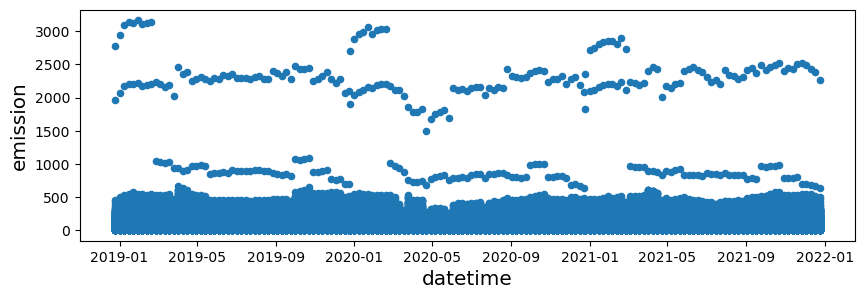

In [10]:
data_train.plot(x='datetime', y='emission', figsize=[10,3],kind='scatter',color='tab:blue')
plt.xlabel('datetime',fontsize='x-large')
plt.ylabel('emission',fontsize='x-large')
plt.show()

In [11]:
data_train.loc[(data_train['week_no'] == 15) & (data_train['year']==2019)]

,ID_LAT_LON_YEAR_WEEK,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,SulphurDioxide_solar_azimuth_angle,SulphurDioxide_solar_zenith_angle,SulphurDioxide_SO2_column_number_density_15km,CarbonMonoxide_CO_column_number_density,CarbonMonoxide_H2O_column_number_density,CarbonMonoxide_cloud_height,CarbonMonoxide_sensor_altitude,CarbonMonoxide_sensor_azimuth_angle,CarbonMonoxide_sensor_zenith_angle,CarbonMonoxide_solar_azimuth_angle,CarbonMonoxide_solar_zenith_angle,NitrogenDioxide_NO2_column_number_density,NitrogenDioxide_tropospheric_NO2_column_number_density,NitrogenDioxide_stratospheric_NO2_column_number_density,NitrogenDioxide_NO2_slant_column_number_density,NitrogenDioxide_tropopause_pressure,NitrogenDioxide_absorbing_aerosol_index,NitrogenDioxide_cloud_fraction,NitrogenDioxide_sensor_altitude,NitrogenDioxide_sensor_azimuth_angle,NitrogenDioxide_sensor_zenith_angle,NitrogenDioxide_solar_azimuth_angle,NitrogenDioxide_solar_zenith_angle,Formaldehyde_tropospheric_HCHO_column_number_density,Formaldehyde_tropospheric_HCHO_column_number_density_amf,Formaldehyde_HCHO_slant_column_number_density,Formaldehyde_cloud_fraction,...,Formaldehyde_sensor_zenith_angle,Formaldehyde_sensor_azimuth_angle,UvAerosolIndex_absorbing_aerosol_index,UvAerosolIndex_sensor_altitude,UvAerosolIndex_sensor_azimuth_angle,UvAerosolIndex_sensor_zenith_angle,UvAerosolIndex_solar_azimuth_angle,UvAerosolIndex_solar_zenith_angle,Ozone_O3_column_number_density,Ozone_O3_column_number_density_amf,Ozone_O3_slant_column_number_density,Ozone_O3_effective_temperature,Ozone_cloud_fraction,Ozone_sensor_azimuth_angle,Ozone_sensor_zenith_angle,Ozone_solar_azimuth_angle,Ozone_solar_zenith_angle,UvAerosolLayerHeight_aerosol_height,UvAerosolLayerHeight_aerosol_pressure,UvAerosolLayerHeight_aerosol_optical_depth,UvAerosolLayerHeight_sensor_zenith_angle,UvAerosolLayerHeight_sensor_azimuth_angle,UvAerosolLayerHeight_solar_azimuth_angle,UvAerosolLayerHeight_solar_zenith_angle,Cloud_cloud_fraction,Cloud_cloud_top_pressure,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission,radius,datetime
15,ID_-0.510_29.290_2019_15,-0.510,29.290,2019,15,-0.000127,0.746807,-0.000089,0.105745,16.261560,52.753243,-58.115946,24.547491,-0.000033,0.029252,2143.427608,3102.802185,829854.600640,9.735644,34.167981,-63.276972,27.007792,0.000043,0.000011,0.000033,0.000109,7311.869141,-1.790281,0.066564,829749.809610,16.261560,52.753243,-58.115946,24.547491,0.000175,1.091100,0.000113,0.204606,...,40.748930,5.385517,-1.525181,829872.061055,-11.861164,43.401323,-62.507434,27.087291,0.124006,2.670680,0.335797,229.504254,0.288561,-11.861164,43.401323,-62.507434,27.087291,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.205133,49405.320731,6080.379192,56090.435911,5080.378996,5.066660,0.272516,5.385456,40.748903,-60.748285,25.893368,4.328390,1.369562,2019-04-09
174,ID_-0.528_29.472_2019_15,-0.528,29.472,2019,15,0.000160,0.698935,0.000093,0.073897,31.852095,39.414809,-59.692035,24.771604,0.000033,0.030657,2107.205008,2199.635054,829859.937500,-0.552781,33.404921,-63.403458,27.113637,0.000047,0.000015,0.000032,0.000108,7878.969766,-1.496043,0.038174,829789.281250,31.852095,39.414809,-59.692035,24.771604,0.000174,1.057308,0.000090,0.191174,...,43.184590,-11.639713,-1.318109,829878.739583,-11.639713,43.184590,-62.705514,27.272268,0.123871,2.682148,0.337291,229.557246,0.190535,-11.639713,43.184590,-62.705514,27.272268,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.261988,47364.750488,6777.426025,51664.829590,5978.595215,5.121228,0.248522,-55.655930,55.521913,-63.836358,29.417596,4.422039,1.302025,2019-04-09
333,ID_-0.547_29.653_2019_15,-0.547,29.653,2019,15,0.00008

Les points excentrés sur le graphique sont des points plutôt au centre de la carte géographiquement, et donc ayant une emission importante. 

Pour que ces données soit exploitable il faudrait soit:
- faire varier la temporalité en fixant la localisation (lat, long)
- faire la moyenne global en faisant des groupby("datetime")

#### Week variation of carbone emissions

Etant donnée qu'il y a 497 stations de localisation différentes il parrait plus pertinent de faire la moyenne global des emission en faisant des groupby("datetime"), contre la second idée qui était de faire varier la temporalité en fixant la localisation (lat, long).

On fait donc la moyenne des différentes emissions d'une même semaine à géolocalisation différente

In [12]:
# Group by date, year, and week number, and calculate the mean for each group
mean_by_group = data_train.groupby(['year', 'week_no'])['emission'].mean()

# Convert the result back to a DataFrame if needed
mean_by_group = mean_by_group.reset_index()
mean_by_group

,year,week_no,emission
0,2019,0,76.739149
1,2019,1,82.376350
2,2019,2,86.008823
3,2019,3,87.903964
4,2019,4,89.595095
...,...,...,...
154,2021,48,83.616881
155,2021,49,82.938555
156,2021,50,82.788301
157,2021,51,79.704971


Visualisons les emissions en fonctions des semaines de l'année

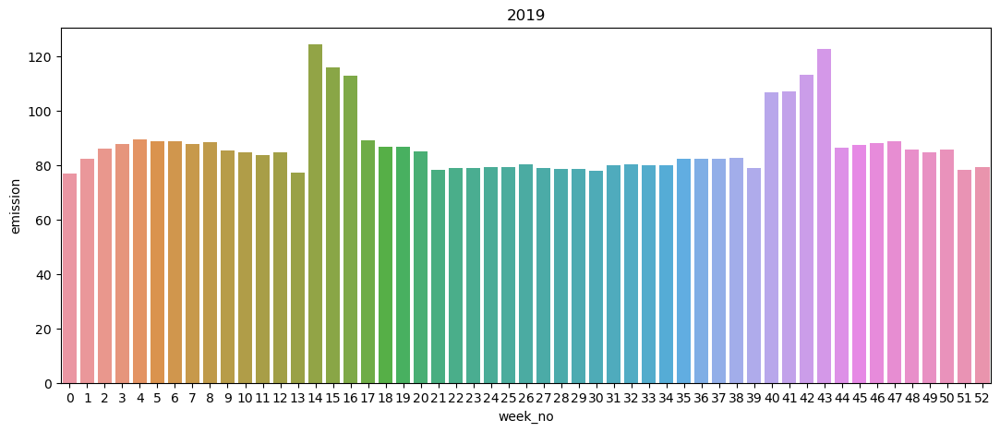

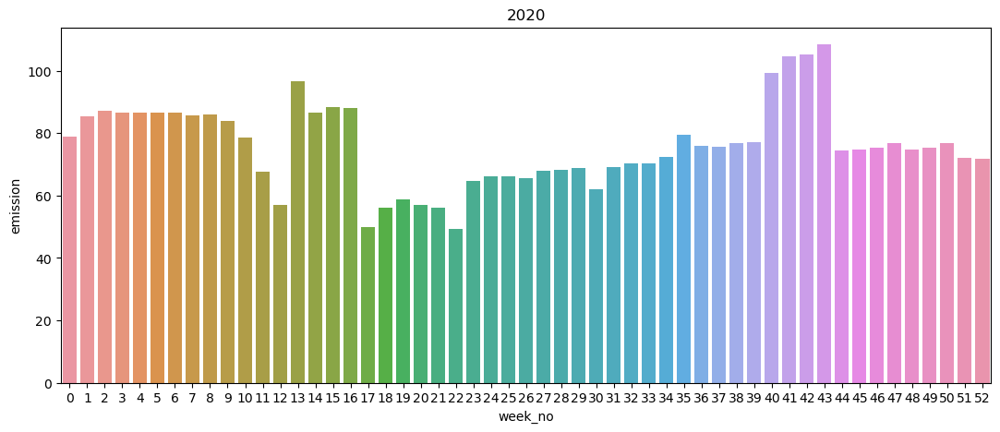

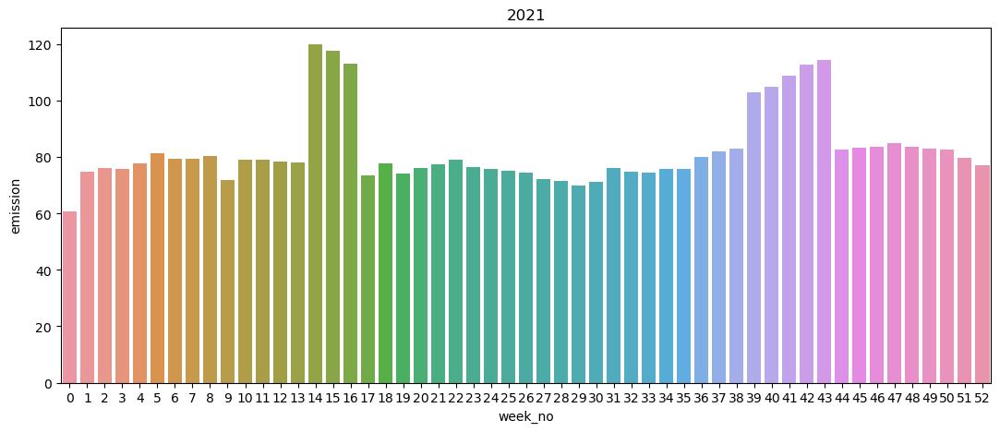

In [13]:
import seaborn as sns

years =[2019,2020,2021]

for year in years:
    # Set the size of the figure using figsize
    plt.figure(figsize=(13, 5))  # Change the values as needed
    sns.barplot(data=mean_by_group.loc[(mean_by_group['year'] == year)], x="week_no", y="emission")
    plt.title(str(year))

On observe deux pics d'émission. Un premier les semaines 14,15,16 et un second les semaines 40,41,42,43 et ceux quelque soit l'année choisit, à l'exception qu'en 2021 ce pique commence une semaine plus tôt la semaine 13 et qu'en 2022 ce pic commence une semaine plus tôt en semaine 39.

Le premier pic commence entre le 26 mars et le 1er avril pour se terminer autour du 22 avril ce qui pourra ce traduire par un pic en avril.

Le second pic commence entre le 23 septembre et le 30 septembre pour se terminer autour du 28 octobre ce qui pourra ce traduire apr un pic en octobre.

#### Month variation of carbone emissions

On fait donc la moyenne des différentes emissions d'un même mois à géolocalisation et semaine différente

In [14]:
# Assurez-vous que la colonne 'date' est de type datetime
data_train['datetime'] = pd.to_datetime(data_train['datetime'])

# Créez une nouvelle colonne 'mois'
data_train['month'] = data_train['datetime'].dt.month

In [15]:
# Group by date, year, and week number, and calculate the mean for each group
mean_by_group2 = data_train.groupby(['year', 'month'])['emission'].mean()

# Convert the result back to a DataFrame if needed
mean_by_group2 = mean_by_group2.reset_index()
mean_by_group2

,year,month,emission
0,2019,1,86.959291
1,2019,2,87.629167
2,2019,3,82.526222
3,2019,4,105.800416
4,2019,5,82.226752
5,2019,6,79.446480
6,2019,7,78.861237
7,2019,8,80.614066
8,2019,9,81.537859
9,2019,10,107.242248


Visualisons les emissions en fonctions des mois de l'année

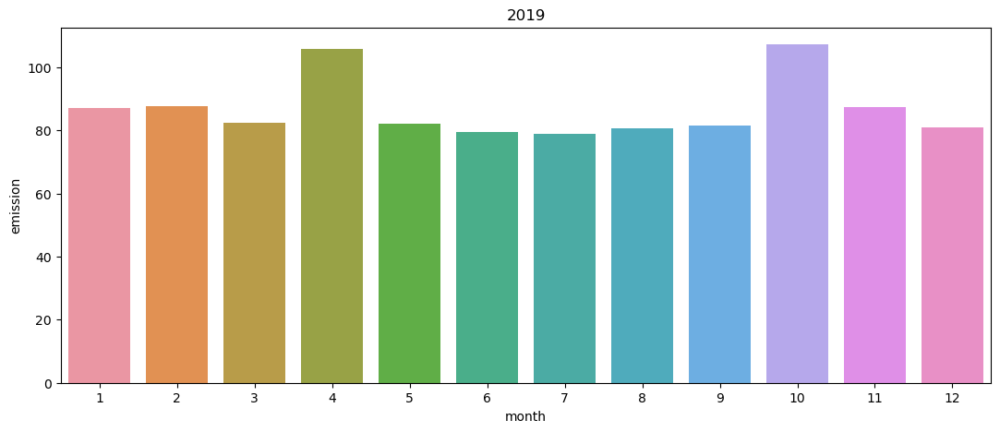

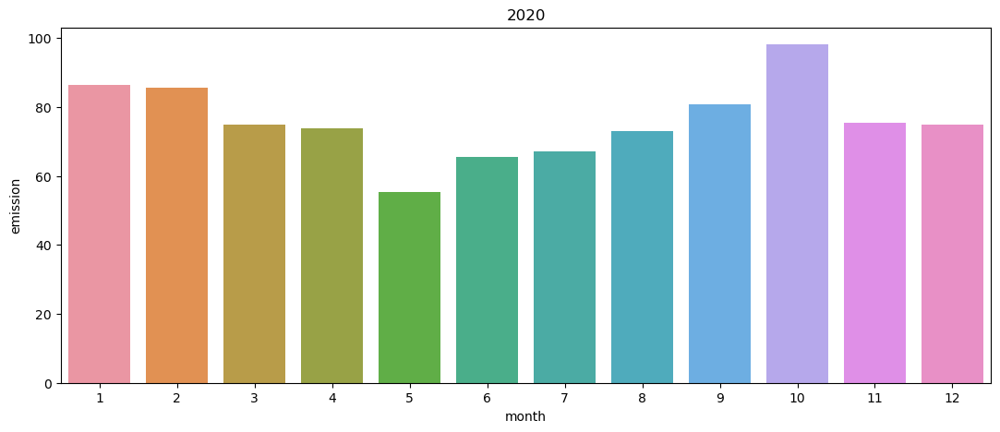

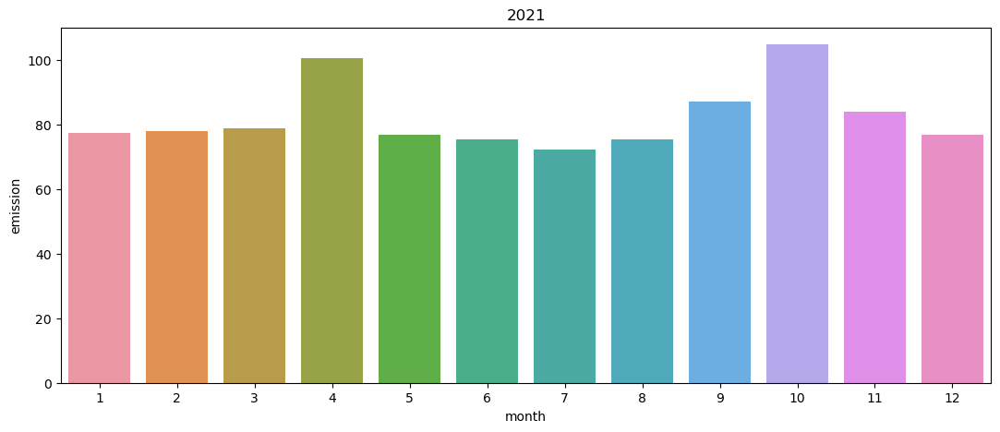

In [16]:
import seaborn as sns

years =[2019,2020,2021]

for year in years:
    # Set the size of the figure using figsize
    plt.figure(figsize=(13, 5))  # Change the values as needed
    sns.barplot(data=mean_by_group2.loc[(mean_by_group2['year'] == year)], x="month", y="emission")
    plt.title(str(year))

On retrouve plus ou moins ce que l'on avait prédit à savoir que les pics d'émission était en avril et en octobre sauf pour l'année 2021 ou ce n'est pas flagrant en avril. Il faudrait comprendre cette corrélation entre temporalité et emission dans **les activité au Rwanda qui pourrait expliquer cette variation à ces périodes**.

#### Year variation of carbone emissions

On fait donc la moyenne des différentes emissions d'une même année à géolocalisation et semaine différente

In [17]:
# Group by date, year, and week number, and calculate the mean for each group
mean_by_group3 = data_train.groupby(['year'])['emission'].mean()

# Convert the result back to a DataFrame if needed
mean_by_group3 = mean_by_group3.reset_index()
mean_by_group3

,year,emission
0,2019,87.255317
1,2020,75.992122
2,2021,82.574217


Visualisons les emissions en fonctions de l'année choisit

<AxesSubplot:xlabel='year', ylabel='emission'>

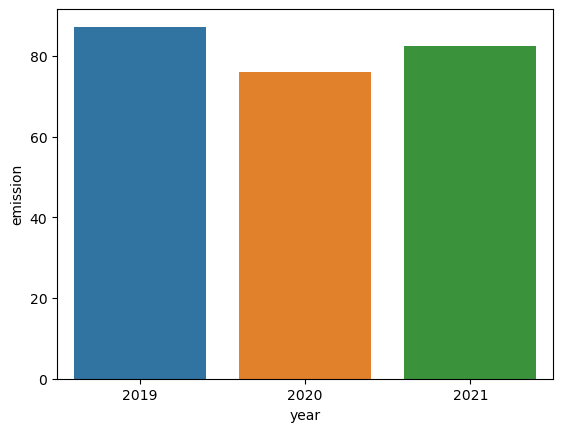

In [18]:
plt.figure()
sns.barplot(data=mean_by_group3, x="year", y="emission")

Il ne semble pas y avoir de corrélation entre l'année choisit et les emissions carbone puisqu'elle ne semble pas vraiment évolué dans le temps.

Il semble tout de même qu'il existe une correlation entre temporalité et emissions carbonne et plus spécifiquement en fonction de la semaine choisit. Pourtant leur coefficient de corrélation est mauvais. 

Cela peut s'expliquer du fait qu'à priori cette corrélation est visible à localisation fixé. Ainsi elle serait pleinement exploitable si on **croisait le numéro de la semaine avec la caractéristique spaciale** que l'on vient de trouver : **le rayon**.

### 5.  Le croisement des caractéristiques temporelle et spaciale

#### Visualisons l'ensemble des données d'émission carbone récolté en 2019 sur un graphique 3D selon les dimensions spacial et temporelle

<IPython.core.display.Javascript object>


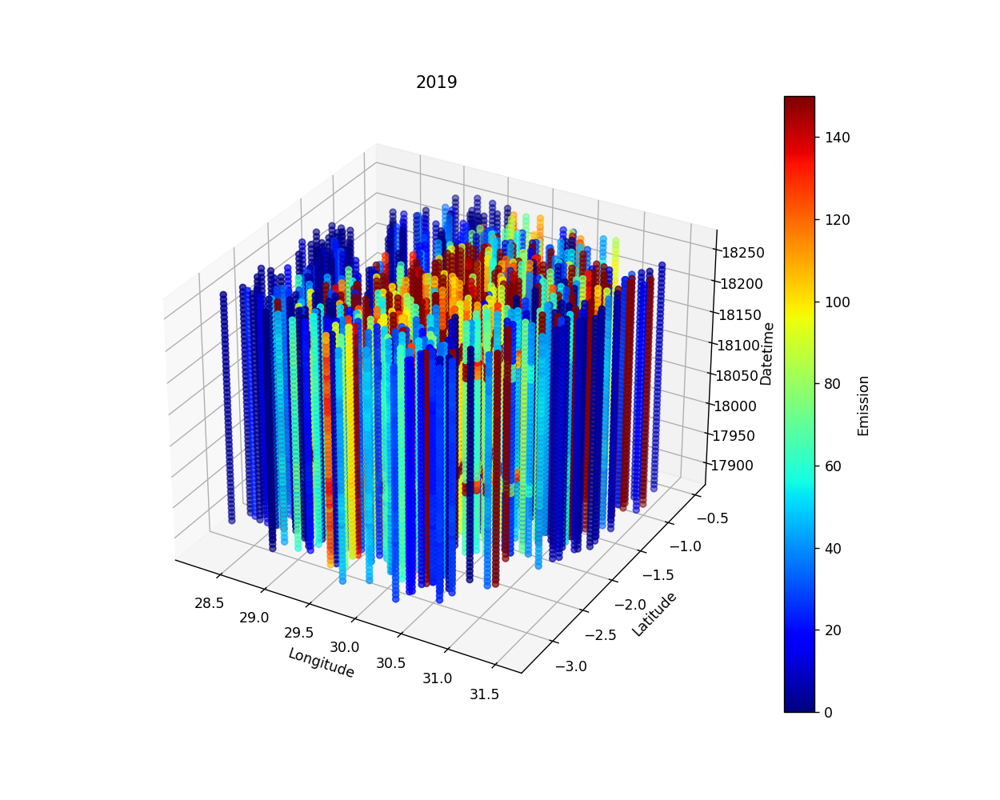

In [19]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.dates as mdates

data_train2019 = data_train.loc[(data_train["year"]==2019)]

# Créez une figure 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot 3D avec la couleur basée sur la colonne 'emission'
scatter = ax.scatter(data_train2019['longitude'], data_train2019['latitude'], data_train2019['datetime'].map(mdates.date2num),
                     c=data_train2019['emission'], cmap=plt.get_cmap("jet"), vmin=0, vmax=150)


# Ajoutez une barre de couleur
cbar = fig.colorbar(scatter, ax=ax)
cbar.set_label('Emission')

# Ajoutez des étiquettes d'axe
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Datetime')

plt.title("2019")

# Affichez le graphique
plt.show()

Pour le visualiser en 2D on peut se servir de la donnée de rayon regroupant la lattitude et la longitude

<IPython.core.display.Javascript object>


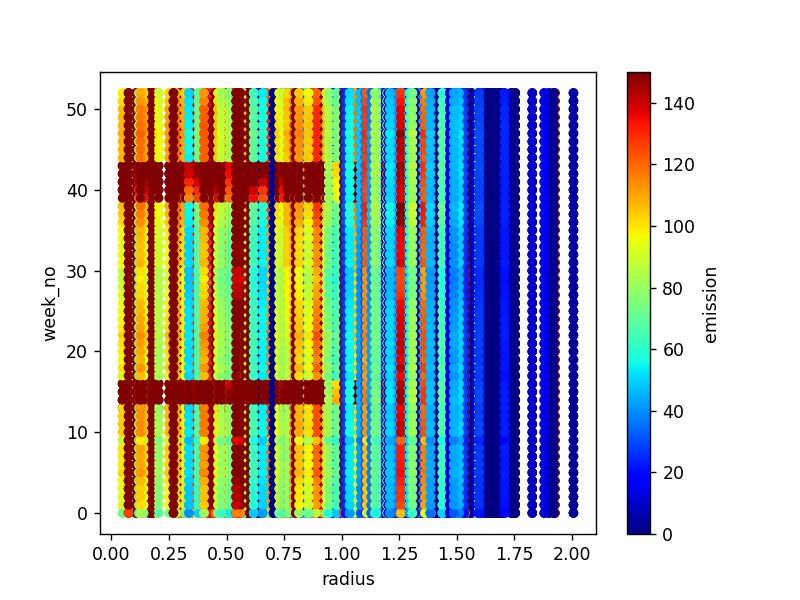

In [20]:
# You can adjust the number of bins for color sensitivity
data_train.plot(kind="scatter", x="radius", y="week_no", c="emission", cmap= plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150)
plt.show()

On observe que la donnée est régulière sauf autour de la semaine 15 et 40 où les emissions sont anormalements plus importante sur un plus grand rayon qu'habituel.

On retrouve les observations que l'on a pu faire sur le graph des emissions en fonction de la semaine de l'année concernant les deux pics d'émission les semaines 14,15,16 et 39,40,41,42,43.

#### Trouvons une stratégie pour relier la semaine de l'année et le rayon

Ressayons la **technique de binnage sur le rayon et week_no** en quadrillant le graph actuelle 

Visualisons ce que donne la carte avec la segmentation choisit, à savoir :
- un pas de 0.1 pour le rayon
- un pas de 2 semaines

In [20]:
pas_rayon = 0.1
pas_week = 2

<IPython.core.display.Javascript object>


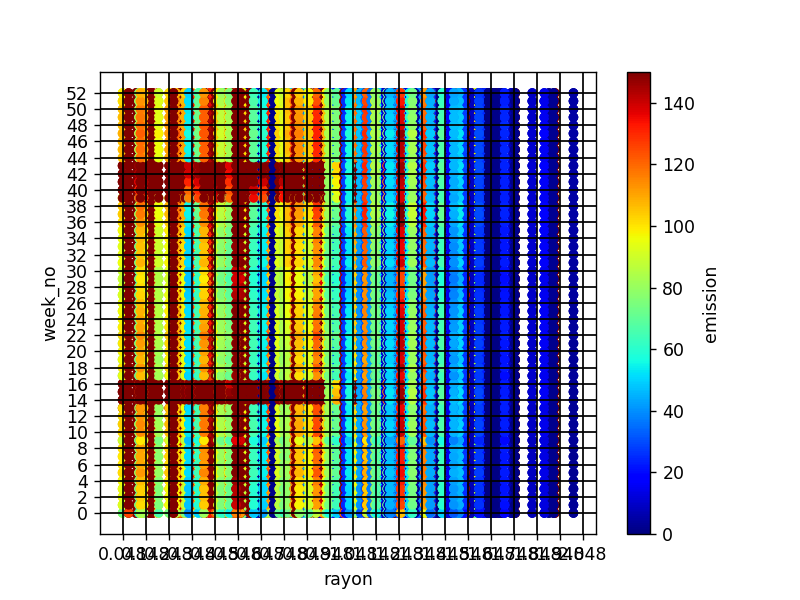

In [21]:
import matplotlib.pyplot as plt
import numpy as np

# Your scatter plot code
scatter_plot = data_train.plot(kind="scatter", x="radius", y="week_no", c="emission", cmap=plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150)

# Specify the grid with a step of 0.10 along the x-axis and 2 along the y-axis
plt.xticks(np.arange(min(data_train['radius']), max(data_train['radius']) + pas_rayon, pas_rayon))
plt.yticks(np.arange(min(data_train['week_no']), max(data_train['week_no']) + pas_week, pas_week))

# Set the zorder for the grid higher than the scatter plot
scatter_plot.set_zorder(1)

# Set grid properties (black color, solid line, and major ticks only)
plt.grid(True, linestyle='-', linewidth=1, color='black', which='major', zorder=0)

# Show the plot
plt.show()

On voit visuellement que la stratégie s'y prette mieux étant donnée que cette fois les données d'emission semble suivre une **distribution linéaire**

In [24]:
# Define resolution
resolution_in_degrees_x = pas_rayon
resolution_in_degrees_y = pas_week

# Discretization for rayon
rayon_data = np.array(data_train['radius'])
rayon_buckets = np.digitize(rayon_data, bins=np.arange(int(min(data_train['radius'])),
                                                              int(max(data_train['radius'])),
                                                              resolution_in_degrees_x))

# Discretization for week
week_data = np.array(data_train['week_no'])
week_buckets = np.digitize(week_data, bins=np.arange(int(min(data_train['week_no'])),
                                                                int(max(data_train['week_no'])),
                                                                resolution_in_degrees_y))

# Combine rayon and week into a single integer representation
# 26 = nombre de groupe de semaine différente
spaciotemporelle = rayon_buckets*26 + week_buckets
print(spaciotemporelle)

[365 365 366 ... 442 442 442]


In [25]:
data_train["spaciotemporelle"]= spaciotemporelle
data_train[["latitude", "longitude", "spaciotemporelle","emission"]]

,latitude,longitude,spaciotemporelle,emission
0,-0.510,29.290,365,3.750994
1,-0.510,29.290,365,4.025176
2,-0.510,29.290,366,4.231381
3,-0.510,29.290,366,4.305286
4,-0.510,29.290,367,4.347317
...,...,...,...,...
79018,-3.299,30.301,441,29.404171
79019,-3.299,30.301,441,29.186497
79020,-3.299,30.301,442,29.131205
79021,-3.299,30.301,442,28.125792


Vérifions la corrélation entre notre donnée spaciotemporelle et les emissions carbone

In [26]:
corr_matrix= data_train.corr()
print("longitude : ", corr_matrix["emission"]["longitude"])
print("latitude : ", corr_matrix["emission"]["latitude"])
print("radius : ", corr_matrix["emission"]["radius"])
print("spaciotemporelle : ", corr_matrix["emission"]["spaciotemporelle"])

longitude :  0.1027464904365297
latitude :  0.017850558434491622
rayon :  -0.2147589784077126
spaciotemporelle :  -0.21166365967975706


**Remarque :** Il est préférable d'incrémenter les valeurs verticalement (et non horizontalement) pour que les valeurs d'emission ne change pas d'une incrémentation à l'autre.

**Ca n'améliore pas la corrélation de la donnée rayon.** Il faudrait continuer d'investiguer pour voir si on ne peut pas améliorer cette donnée en faisant varier les pas **pas_rayon** et **pas_week**.

In [27]:
pas_rayons= [0.1, 0.2, 0.3]
pas_weeks= [1, 2, 3, 4, 5, 7]

max_corr = 0
r_opt = 0
w_opt = 0

for pas_rayon in pas_rayons:
    for pas_week in pas_weeks:
        # Define resolution
        resolution_in_degrees_x = pas_rayon
        resolution_in_degrees_y = pas_week
        
        # Discretization for rayon
        rayon_data = np.array(data_train['rayon'])
        rayon_buckets = np.digitize(rayon_data, bins=np.arange(int(min(data_train['radius'])),
                                                              int(max(data_train['radius'])),
                                                              resolution_in_degrees_x))
        
        # Discretization for week
        week_data = np.array(data_train['week_no'])
        week_buckets = np.digitize(week_data, bins=np.arange(int(min(data_train['week_no'])),
                                                                int(max(data_train['week_no'])),
                                                                resolution_in_degrees_y))
        
        # Combine rayon and week into a single integer representation
        nb_col = int(52/pas_week)

        spaciotemporelle = rayon_buckets*nb_col+ week_buckets
        data_train["spaciotemporelle"]= spaciotemporelle
        corr_matrix= data_train.corr()
        
        if max_corr < abs(corr_matrix["emission"]["spaciotemporelle"]) :
            max_corr  = abs(corr_matrix["emission"]["spaciotemporelle"])
            r_opt = pas_rayon
            w_opt = pas_week
            
        
        print("pas_rayon: ", pas_rayon)
        print("pas_week: ", pas_week)
        print("spaciotemporelle : ", corr_matrix["emission"]["spaciotemporelle"])
        
print("pas_rayon optimal: ", r_opt)
print("pas_week optimal: ", w_opt)
print("spaciotemporelle optimal: ", max_corr)

pas_rayon:  0.1
pas_week:  1
spaciotemporelle :  -0.2116655433762069
pas_rayon:  0.1
pas_week:  2
spaciotemporelle :  -0.21166365967975706
pas_rayon:  0.1
pas_week:  3
spaciotemporelle :  -0.21164395751714365
pas_rayon:  0.1
pas_week:  4
spaciotemporelle :  -0.2117054327300933
pas_rayon:  0.1
pas_week:  5
spaciotemporelle :  -0.2115777723009995
pas_rayon:  0.1
pas_week:  7
spaciotemporelle :  -0.2114394611944861
pas_rayon:  0.2
pas_week:  1
spaciotemporelle :  -0.21636530861534475
pas_rayon:  0.2
pas_week:  2
spaciotemporelle :  -0.21636535909450288
pas_rayon:  0.2
pas_week:  3
spaciotemporelle :  -0.21626725757435647
pas_rayon:  0.2
pas_week:  4
spaciotemporelle :  -0.21645749117983587
pas_rayon:  0.2
pas_week:  5
spaciotemporelle :  -0.21608183721426713
pas_rayon:  0.2
pas_week:  7
spaciotemporelle :  -0.215749578939305
pas_rayon:  0.3
pas_week:  1
spaciotemporelle :  -0.2063820059169161
pas_rayon:  0.3
pas_week:  2
spaciotemporelle :  -0.206386244466053
pas_rayon:  0.3
pas_week:  3


Pour un pas pas_rayon = 0.2 et un pas pas_week = 4 on obtient un coefficient de corrélation = 2.16 soit un peu meilleur que celui du rayon

In [28]:
pas_rayon = 0.2
pas_week = 4

Visualisons ce que cela donne graphiquement

<IPython.core.display.Javascript object>


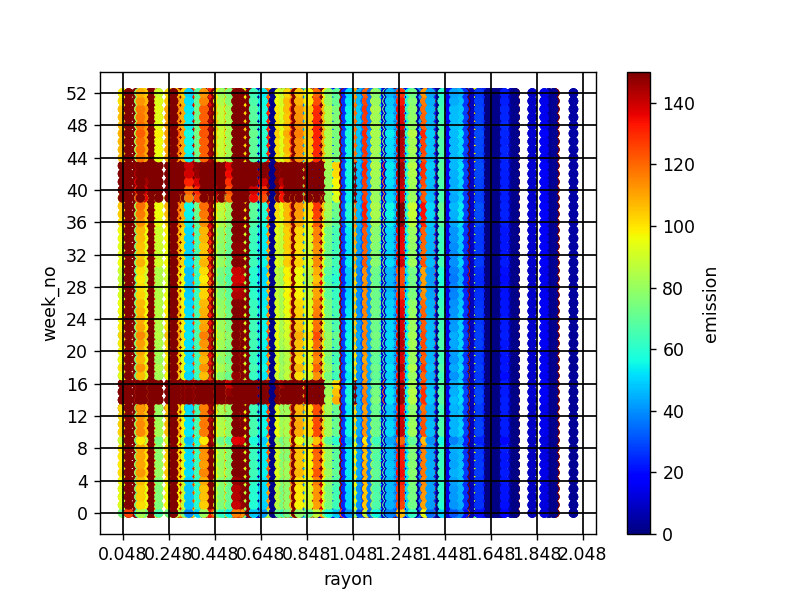

In [29]:
import matplotlib.pyplot as plt
import numpy as np

# Your scatter plot code
scatter_plot = data_train.plot(kind="scatter", x="radius", y="week_no", c="emission", cmap=plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150)

# Specify the grid with a step of 0.10 along the x-axis and 2 along the y-axis
plt.xticks(np.arange(min(data_train['radius']), max(data_train['radius']) + pas_rayon, pas_rayon))
plt.yticks(np.arange(min(data_train['week_no']), max(data_train['week_no']) + pas_week, pas_week))

# Set the zorder for the grid higher than the scatter plot
scatter_plot.set_zorder(1)

# Set grid properties (black color, solid line, and major ticks only)
plt.grid(True, linestyle='-', linewidth=1, color='black', which='major', zorder=0)

# Show the plot
plt.show()

Gardons cette donnée avec les pas optimum

In [30]:
# Define resolution
resolution_in_degrees_x = pas_rayon
resolution_in_degrees_y = pas_week
        
# Discretization for rayon
rayon_data = np.array(data_train['radius'])
rayon_buckets = np.digitize(rayon_data, bins=np.arange(int(min(data_train['radius'])),
                                                              int(max(data_train['radius'])),
                                                              resolution_in_degrees_x))
        
# Discretization for week
week_data = np.array(data_train['week_no'])
week_buckets = np.digitize(week_data, bins=np.arange(int(min(data_train['week_no'])),
                                                                int(max(data_train['week_no'])),
                                                                resolution_in_degrees_y))
        
# Combine rayon and week into a single integer representation
nb_col = int(52/pas_week)

spaciotemporelle = rayon_buckets*nb_col+ week_buckets
data_train["spaciotemporelle"]= spaciotemporelle

### 6.  Les caractéristiques temporelles et les semaines de surconsomations

**Revenons à un modèle plus simple**
- Nous avons identifié un bon modèle spaciale en l'exprimant avec un paramètre rayon. 
- Nous avons identifié que les semaines de surconsomation était 14-16 et 39-43

Créons un paramètre qui renvoie 1 si c'est l'une de ses semaines de fortes consomation et 0 autrement.

In [7]:
data_train['high_emission_week']= ((data_train['week_no']>=14) * (data_train['week_no']<=16) + (data_train['week_no']>=39) * (data_train['week_no']<=43))*1 

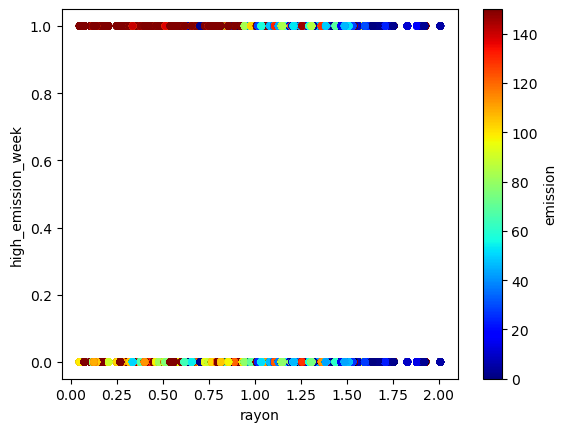

In [28]:
# You can adjust the number of bins for color sensitivity
data_train.plot(kind="scatter", x="rayon", y="high_emission_week", c="emission", cmap= plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150)
plt.show()

In [25]:
data_regrouped = data_train.groupby(['radius', 'high_emission_week'])['emission'].mean()

# Convert the result back to a DataFrame if needed
data_regrouped = data_regrouped.reset_index()
data_regrouped

,rayon,high_emission_week,emission
0,0.048042,0,97.826053
1,0.048042,1,184.499173
2,0.074041,0,178.568174
3,0.074041,1,239.669725
4,0.106527,0,208.659127
...,...,...,...
983,1.920955,1,2.398903
984,1.926486,0,262.124199
985,1.926486,1,260.668514
986,2.007379,0,5.005962


In [26]:
high_emission_weeks = data_regrouped[(data_regrouped['high_emission_week'] >= 0.5)].set_index("radius")
low_emission_weeks = data_regrouped[(data_regrouped['high_emission_week'] <= 0.5)].set_index("radius")
low_emission_weeks

,high_emission_week,emission
rayon,,
0.048042,0,97.826053
0.074041,0,178.568174
0.106527,0,208.659127
0.119883,0,75.953796
0.125929,0,109.081283
...,...,...
1.880546,0,14.415113
1.900658,0,2.143855
1.920955,0,2.479520


In [27]:
data_regrouped_emission_weeks = pd.DataFrame(index=high_emission_weeks.index)
data_regrouped_emission_weeks['high_emission_weeks'] = high_emission_weeks['emission']
data_regrouped_emission_weeks['low_emission_weeks'] = low_emission_weeks['emission']
data_regrouped_emission_weeks['difference'] = data_regrouped_emission_weeks['high_emission_weeks'] - data_regrouped_emission_weeks['low_emission_weeks']

data_regrouped_emission_weeks#[data_regrouped_emission_weeks.isna().any(axis=1)]

,high_emission_weeks,low_emission_weeks,difference
rayon,,,
0.048042,184.499173,97.826053,86.673119
0.074041,239.669725,178.568174,61.101551
0.106527,294.274836,208.659127,85.615709
0.119883,134.911680,75.953796,58.957885
0.125929,233.439815,109.081283,124.358532
...,...,...,...
1.880546,15.386619,14.415113,0.971507
1.900658,2.879717,2.143855,0.735863
1.920955,2.398903,2.479520,-0.080617


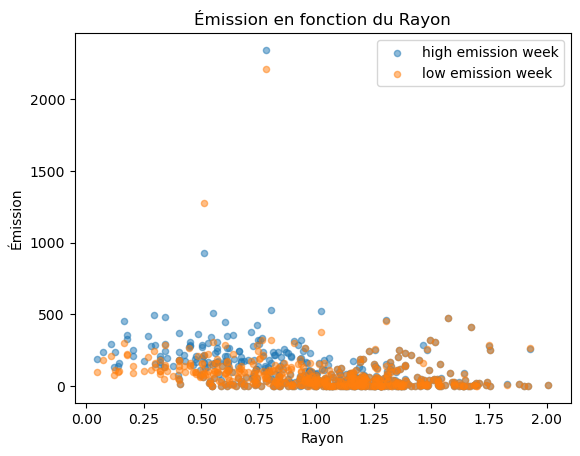

In [28]:
plt.figure()

# Tracer le graphique
plt.scatter(data_regrouped_emission_weeks.index, data_regrouped_emission_weeks['high_emission_weeks'], alpha=0.5, s=20, label="high emission week")
plt.scatter(data_regrouped_emission_weeks.index, data_regrouped_emission_weeks['low_emission_weeks'], alpha=0.5, s=20, label="low emission week")
# Ajouter les titres et labels
plt.xlabel("Rayon")
plt.ylabel("Émission")
plt.title("Émission en fonction du Rayon")
plt.legend()

# Afficher le graphique
plt.show()

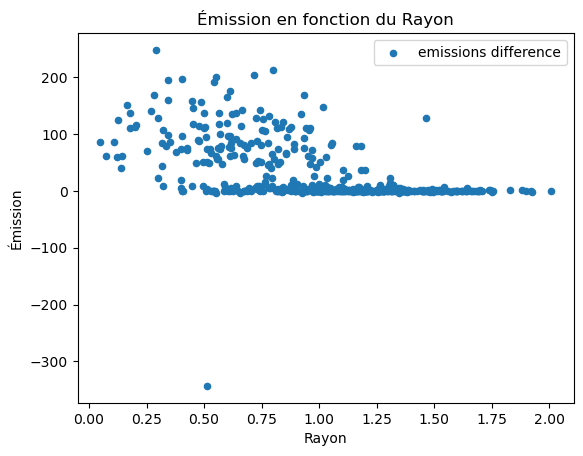

In [29]:
plt.figure()

# Tracer le graphique
plt.scatter(data_regrouped_emission_weeks.index, data_regrouped_emission_weeks['difference'], s=20, label="emissions difference")

# Ajouter les titres et labels
plt.xlabel("Rayon")
plt.ylabel("Émission")
plt.title("Émission en fonction du Rayon")
plt.legend()

# Afficher le graphique
plt.show()

In [30]:
data_regrouped_emission_weeks['binary_difference'] = 1*(data_regrouped_emission_weeks['difference']>30)
data_regrouped_emission_weeks

,high_emission_weeks,low_emission_weeks,difference,binary_difference
rayon,,,,
0.048042,184.499173,97.826053,86.673119,1
0.074041,239.669725,178.568174,61.101551,1
0.106527,294.274836,208.659127,85.615709,1
0.119883,134.911680,75.953796,58.957885,1
0.125929,233.439815,109.081283,124.358532,1
...,...,...,...,...
1.880546,15.386619,14.415113,0.971507,0
1.900658,2.879717,2.143855,0.735863,0
1.920955,2.398903,2.479520,-0.080617,0


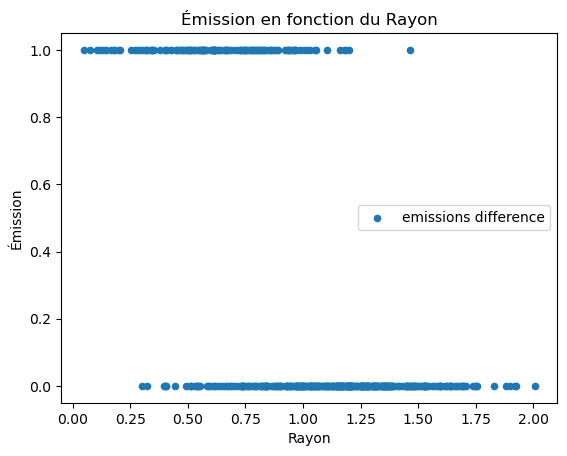

In [31]:
plt.figure()

# Tracer le graphique
plt.scatter(data_regrouped_emission_weeks.index, data_regrouped_emission_weeks['binary_difference'], s=20, label="emissions difference")

# Ajouter les titres et labels
plt.xlabel("Rayon")
plt.ylabel("Émission")
plt.title("Émission en fonction du Rayon")
plt.legend()

# Afficher le graphique
plt.show()

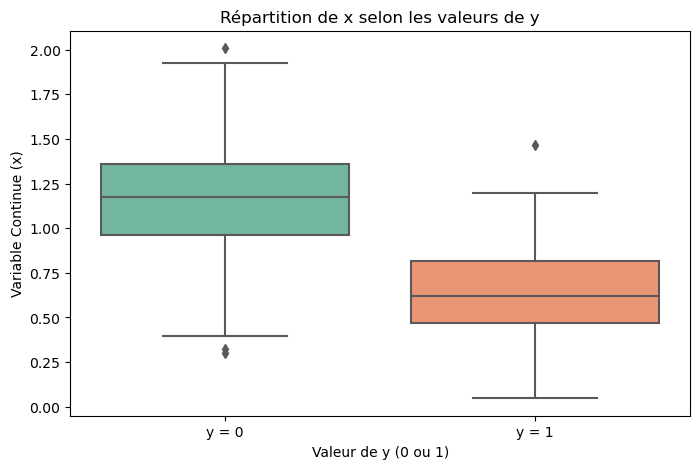

In [32]:
# Tracer le boxplot
plt.figure(figsize=(8, 5))
sns.boxplot(x='binary_difference', y=data_regrouped_emission_weeks.index, data=data_regrouped_emission_weeks, palette='Set2')

# Ajouter des labels et un titre
plt.xlabel("Valeur de y (0 ou 1)")
plt.ylabel("Variable Continue (x)")
plt.title("Répartition de x selon les valeurs de y")
plt.xticks([0, 1], ['y = 0', 'y = 1'])

# Afficher le graphique
plt.show()

In [37]:
data_train['high_emission_week']

0        0
1        0
2        0
3        0
4        0
        ..
79018    0
79019    0
79020    0
79021    0
79022    0
Name: high_emission_week, Length: 79023, dtype: int32

In [38]:
corr_matrix= data_train.corr()
print("longitude : ", corr_matrix["emission"]["longitude"])
print("latitude : ", corr_matrix["emission"]["latitude"])
print("radius : ", corr_matrix["emission"]["radius"])
print()
print("week_no : ", corr_matrix["emission"]["week_no"])
print("high_emission_week : ", corr_matrix["emission"]["high_emission_week"])

longitude :  0.1027464904365297
latitude :  0.017850558434491622
rayon :  -0.2147589784077126

week_no :  0.00708597027721469
high_emission_week :  0.0691597035649037


## Partie 3 : Transformation des données - Pipeline

### 1. Nettoyage des données

Les cellules ci-dessous sont à éxecuter si on à sauter les parties 1 et 2 (partie 1.1 exclu):

In [2]:
x0 = 29.75
y0 = -1.8
radius = np.sqrt( (data_train['longitude']-x0)**2 + (data_train['latitude']-y0)**2 )
data_train["radius"]= radius

data_train['high_emission_week']= ((data_train['week_no']>=14) * (data_train['week_no']<=16) + (data_train['week_no']>=39) * (data_train['week_no']<=43))*1 

In [3]:
#data_train.columns

On se débarasse des colones inutiles

In [4]:
data_train = data_train.drop(["ID_LAT_LON_YEAR_WEEK"] , axis=1)

In [5]:
#data_train = data_train.drop(["concatenated_data", "datetime"] , axis=1)

Pas de data catégorique, data train est constituer uniquement de data numérique, donc pas besoin de hot encoder dans la pipeline

### 2. Pipeline

In [6]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler


# Créer le pipeline
num_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),#pour les donées manquantes
    ('std_scaler', StandardScaler())
])

### 3. Séparation des données

Séparation des données d'entrainement 80% et de validation 20%

#### 3.1 Séparation aléatoire

Nous utliserons une répartition aléatoire des données d'entrainement et de validation dans la **partie 4** où l'on testera les différent modèle puisque l'objectif sera de voir le comportement des données sur l'ensemble des caractéristiques et comprendre davantage sont comportement.

De plus cela permettra de mieux comprendre les caractéristiques qu'il faut priviliégé pour entrainer le modèle

In [7]:
from sklearn.model_selection import train_test_split

In [8]:
features_list = ['radius', 'high_emission_week']

In [9]:
y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [12]:
X_train, X_val, y_train, y_val = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

La graine aléatoire (seed) est un nombre que l'on spécifie pour initialiser le générateur de nombres aléatoires, de sorte que chaque fois qu'on exécutez votre code, les résultats aléatoires soient les mêmes.Ici on prend random_state = 42

In [13]:
print(f"X_train size = {len(X_train)}")
print(f"X_test size = {len(X_val)}")
print(f"y_train size = {len(y_train)}")
print(f"y_test size = {len(y_val)}")

X_train size = 63218
X_test size = 15805
y_train size = 63218
y_test size = 15805


#### 3.2 Séparation chronologique 

Cependant dans la **partie 5** pour mieux adapter les modèles et éviter un surapprentissage nous pourrons aussi esayer de séparer les données de facon chronologique.

En effet cela permettra :
- d'être cohérent avec notre objectif finale qui est de prédire les futurs émission
- de vérifier notre modèle sur des données qui "ressemble moins" au donnée avec lequel il a été entrainé afin de vérifier si celui-ci fait du surapprentissage (overfitting)

#### 3.3 Ranger les données par chronologie croissante

In [14]:
data_train

,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,...,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission,radius,high_emission_week
0,-0.510,29.290,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,50.843559,...,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994,1.369562,0
1,-0.510,29.290,2019,1,0.000021,0.728214,0.000014,0.130988,16.592861,39.137194,...,3174.572424,8.690601,0.256830,30.359375,39.557633,-145.183930,27.251779,4.025176,1.369562,0
2,-0.510,29.290,2019,2,0.000514,0.748199,0.000385,0.110018,72.795837,52.868816,...,3516.282669,21.103410,0.251101,15.377883,30.401823,-142.519545,26.193296,4.231381,1.369562,0
3,-0.510,29.290,2019,3,NaN,NaN,NaN,NaN,NaN,NaN,...,4180.973322,15.386899,0.262043,-11.293399,24.380357,-132.665828,28.829155,4.305286,1.369562,0
4,-0.510,29.290,2019,4,-0.000079,0.676296,-0.000048,0.121164,4.121269,35.515587,...,3355.710107,8.114694,0.235847,38.532263,37.392979,-141.509805,22.204612,4.347317,1.369562,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79018,-3.299,30.301,2021,48,0.000284,1.195643,0.000340,0.191313,72.820518,55.988022,...,4590.879504,20.245954,0.304797,-35.140368,40.113533,-129.935508,32.095214,29.404171,1.597060,0
79019,-3.299,30.301,2021,49,0.000083,1.130868,0.000063,0.177222,-12.856753,19.435339,...,4659.130378,6.104610,0.314015,4.667058,47.528435,-134.252871,30.771469,29.186497,1.597060,0
79020,-3.299,30.301,2021,50,NaN,NaN,NaN,NaN,NaN,NaN,...,5222.646823,14.817885,0.288058,-0.340922,35.328098,-134.731723,30.716166,29.131205,1.597060,0
79021,-3.299,30.301,2021,51,-0.000034,0.879397,-0.000028,0.184209,-100.344827,32.599393,...,6946.858022,32.594768,0.274047,8.427699,48.295652,-139.447849,29.112868,28.125792,1.597060,0


In [15]:
data_train = data_train.sort_values(by=['year','week_no'], ascending=True)
data_train

,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,...,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission,radius,high_emission_week
0,-0.510,29.290,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,50.843559,...,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994,1.369562,0
159,-0.528,29.472,2019,0,0.000019,0.709144,0.000014,0.134741,-98.501511,51.844101,...,3213.283931,18.926705,0.214483,-12.516482,35.564368,-138.523453,30.907505,3.857115,1.302025,0
318,-0.547,29.653,2019,0,-0.000003,0.644523,0.000002,0.159232,-98.442759,52.516869,...,3757.115933,14.942300,0.218611,-12.424014,35.551288,-138.308677,31.027002,0.500023,1.256749,0
477,-0.569,30.031,2019,0,-0.000084,0.707230,-0.000059,0.150600,73.134705,49.526180,...,3735.628591,20.669712,0.287372,4.514736,41.459575,-141.751064,29.854191,100.382980,1.262665,0
636,-0.598,29.102,2019,0,-0.000019,0.841109,-0.000016,0.235381,76.165604,15.930818,...,2678.920405,14.724678,0.260578,-12.673878,35.704096,-138.924499,30.708915,0.076542,1.365543,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78386,-3.153,30.347,2021,52,NaN,NaN,NaN,NaN,NaN,NaN,...,7304.606675,18.224324,0.277713,-12.399953,42.415103,-135.301261,30.723483,15.040095,1.478857,0
78545,-3.161,28.839,2021,52,NaN,NaN,NaN,NaN,NaN,NaN,...,4170.912578,37.968482,0.264768,-0.663527,43.450906,-138.239880,29.048600,0.122683,1.637755,0
78704,-3.174,29.926,2021,52,0.000309,0.829102,0.000256,0.247684,-98.795246,52.183567,...,4187.148334,44.321738,0.297716,16.267426,43.023911,-138.206532,28.862485,42.904007,1.385226,0
78863,-3.287,29.713,2021,52,-0.000034,1.192366,-0.000039,0.241045,54.679320,45.486462,...,3046.182580,31.927611,0.240412,33.954968,43.726954,-139.879667,27.811693,43.260082,1.487460,0


In [16]:
def train_test_chrono_split(X, y, train_size=0.8):
    #X is an np.array
    #y is a serie
    
    separation_index = int(train_size * len(X))
    X_train = X[:separation_index]
    X_val = X[separation_index:]
    y_train = y[:separation_index]
    y_val = y[separation_index:]
    
    return X_train, X_val, y_train, y_val

In [17]:
features_list = ['radius', 'high_emission_week']

In [18]:
#y_train=np.log1p(data_train['emission'].copy())
y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [19]:
X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [20]:
print(f"X_train size = {len(X_train)}")
print(f"X_test size = {len(X_val)}")
print(f"y_train size = {len(y_train)}")
print(f"y_test size = {len(y_val)}")

X_train size = 63218
X_test size = 15805
y_train size = 63218
y_test size = 15805


#### Avec Timeseries

Utilisation de timeseries pour prendre en compte la périodicité des emissions au cours de l'année

Regarder aussi le taller 8 pour retrouver la notion de périodicité

Pour cette partie nous utiliseron la fonction [keras.preprocessing.timeseries_dataset_from_array()](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/timeseries_dataset_from_array).

In [7]:
import tensorflow as tf
from tensorflow import keras

## Partie 4 : Les différents modèles prédictifs

In [21]:
from sklearn.metrics import mean_squared_error, r2_score

### 1. Selectionner une Mesure de performance

Root Mean Squared Error (RMSE)
$$\sqrt{\frac{1}{n}\sum_{i}^{n}\big(y_{i} - \hat{y}_{i} \big)^2}$$

Kaggle suggère d'utilisé **Root Mean Squared Error (RMSE)** ce qui est :
- plus sensible aux erreurs
- fonctionne bien quand les outliers sont rares

- CV(RMSE) < 25 : indique que le modèle est précis, indépendamment de l'échelle des données.
- R² > 0.75 : indique que le modèle intègre bien les variations de la donnée à prédire.

CV est le coefficient de variation, soit l'écart type (RMSE) divisé par la moyenne des valeurs observées

La valeur moyenne des emissions est :

In [22]:
data_train["emission"].mean()

81.94055161320311

On cherchera à avoir RMSE < 20.5

### 2. Regression linéaire

In [23]:
from sklearn.linear_model import LinearRegression

#### Fit 1

In [24]:
features_list = ['radius', 'high_emission_week']

In [81]:
y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [82]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [83]:
# Créer et entraîner le modèle
linear_regressor = LinearRegression()
linear_regressor.fit(X_train, y_train)

# Prédire sur l'ensemble de test
y_pred = linear_regressor.predict(X_test)

In [84]:
# Afficher les coefficients
print(f"Coefficient (pente) : {linear_regressor.coef_}")
print(f"Ordonnée à l'origine : {linear_regressor.intercept_}")

# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Coefficient (pente) : [-30.98083772   9.63537029]
Ordonnée à l'origine : 81.83055334241855
Erreur quadratique moyenne (RMSE) : 146.27
Score R² : 0.05


In [85]:
def result_df(data_train, X ,y_test ,y_pred):
    result = pd.DataFrame(index = y_test.index)
    result['latitude'] = data_train["latitude"]
    result['longitude'] = data_train["longitude"]
    result['week_no'] = data_train["week_no"]

    result['radius'] = X['radius']
    result['high_emission_week'] = X['high_emission_week']

    result["test"] = y_test.copy()
    result["pred"] = y_pred.copy()
    result["error"]= result["test"] - result["pred"]
    return result

In [86]:
def check_model(result):
    high_emission_result = result[result['high_emission_week']>=0.5]
    low_emission_result = result[result['high_emission_week']<=0.5]
    
    fig,ax = plt.subplots(3,sharex = True, figsize=(10,11))
    
    ax[0].scatter(high_emission_result.index, high_emission_result["test"], alpha=0.5, s=20, label= "réel")
    ax[0].scatter(high_emission_result.index, high_emission_result["pred"], alpha=0.5, s=20, c='orange', label="prédit")
    ax[0].set_title('High emission week fit', fontsize=20)
    ax[0].set_ylabel('Emission', fontsize=15)
    #ax[0].set_xlabel('Index', fontsize=15)
    ax[0].legend(loc='best', fontsize=17)
    
    ax[1].scatter(low_emission_result.index, low_emission_result["test"], alpha=0.5, s=20, label= "réel")
    ax[1].scatter(low_emission_result.index, low_emission_result["pred"], alpha=0.5, s=20, c='orange', label="prédit")
    ax[1].set_title('Low emission week fit', fontsize=20)
    ax[1].set_ylabel('Emission', fontsize=15)
    #ax[1].set_xlabel('Index', fontsize=15)
    ax[1].legend(loc='best', fontsize=17)
    
    ax[2].scatter(high_emission_result.index, high_emission_result["error"], alpha=0.1, c='red', s=20, label= "High emission week")  
    ax[2].scatter(low_emission_result.index, low_emission_result["error"], alpha=0.1, c='purple', s=20, label= "Low emission week")
    ax[2].set_title('Models errors', fontsize=20)
    ax[2].set_ylabel('Error', fontsize=15)
    ax[2].set_xlabel('Index', fontsize=15)
    ax[2].legend(loc='best', fontsize=17)
    
    

In [87]:
result_lin_reg = result_df(data_train, X ,y_test ,y_pred)
result_lin_reg

,latitude,longitude,week_no,radius,high_emission_week,test,pred,error
8149,-0.986,30.214,40,0.936959,1,7.227828,110.344755,-103.116927
38890,-1.877,28.523,41,1.229414,1,0.396765,86.884351,-86.487587
12297,-1.085,29.215,1,0.893001,0,7.973012,86.956130,-78.983118
54040,-2.300,29.200,33,0.743303,0,268.629640,98.964670,169.664970
41073,-1.922,29.178,51,0.584866,0,33.479927,111.674366,-78.194439
...,...,...,...,...,...,...,...,...
952,-0.604,29.896,51,1.204878,0,71.287040,61.937628,9.349412
9044,-1.003,29.497,34,0.836193,0,22.029990,91.513206,-69.483216
9033,-1.003,29.497,23,0.836193,0,22.685100,91.513206,-68.828106
48338,-2.133,30.467,2,0.790556,0,100.311020,95.174161,5.136859


<IPython.core.display.Javascript object>


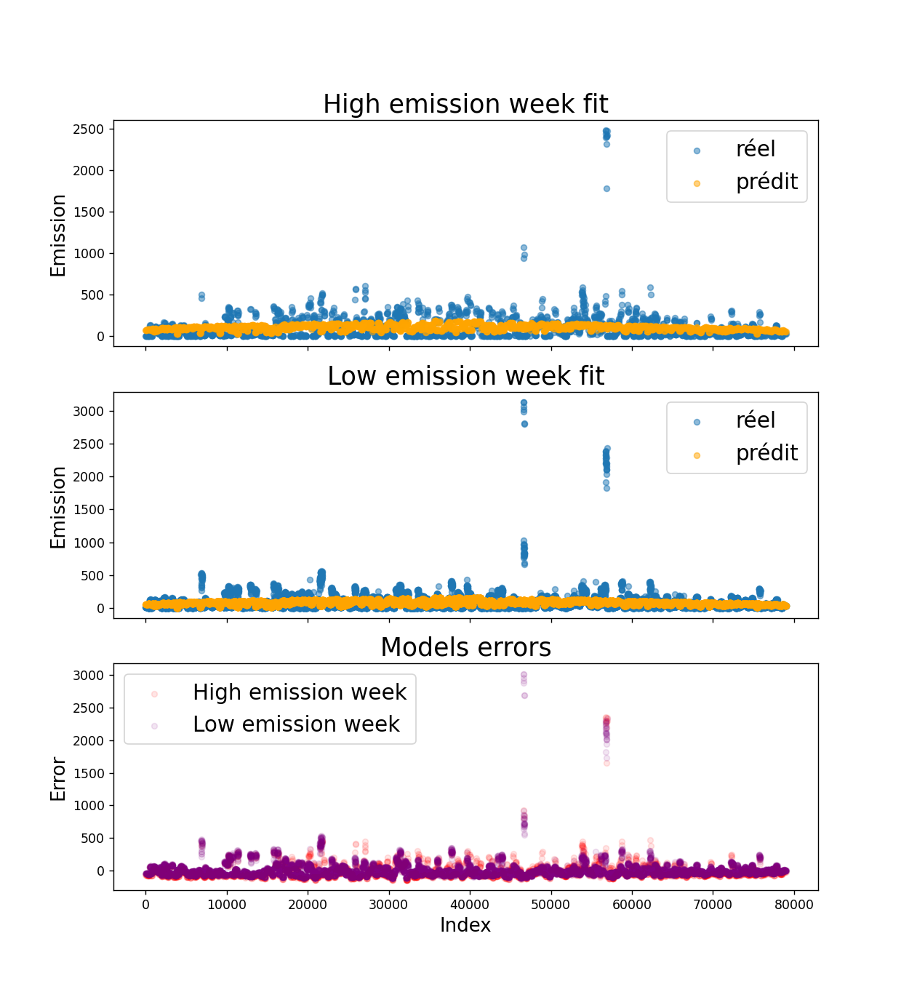

In [88]:
check_model(result_lin_reg)

In [90]:
def geographical_emission_error(result):
    # Centre des coordonnées (exemple)
    center_latitude = y0
    center_longitude = x0
    
    # Création des rayons avec un pas de 0.5 jusqu'à un certain maximum
    max_radius = 2
    radii = np.arange(0.5, max_radius + 0.5, 0.5)
    
    # Création du graphique
    fig, ax = plt.subplots()
    
    # Dessiner les cercles
    for radius in radii:
        circle = plt.Circle((center_longitude, center_latitude), radius, fill=False, color='grey', linestyle='dashed')
        ax.add_patch(circle)
    
    # Ajouter les points de données
    result.plot(kind="scatter", x="longitude", y="latitude", c="error", cmap=plt.get_cmap("jet"), colorbar=True, 
                vmin=-150, vmax=150, ax=ax, alpha=0.1)
    
    # Paramètres du graphique
    ax.set_aspect('equal', adjustable='datalim')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Models geographical errors', fontsize=12)
    
    # Afficher le graphique
    plt.show()

In [91]:
def emission_error_correlation(result):
    fig, ax = plt.subplots()
    result.plot(kind="scatter", x="radius", y="week_no", c="error", cmap= plt.get_cmap("jet"), 
                colorbar=True, vmin=-150, vmax=150, ax=ax, alpha=0.2)
    ax.set_title('Model errors correlation to radius and week_no', fontsize=12)
    plt.show()

<IPython.core.display.Javascript object>


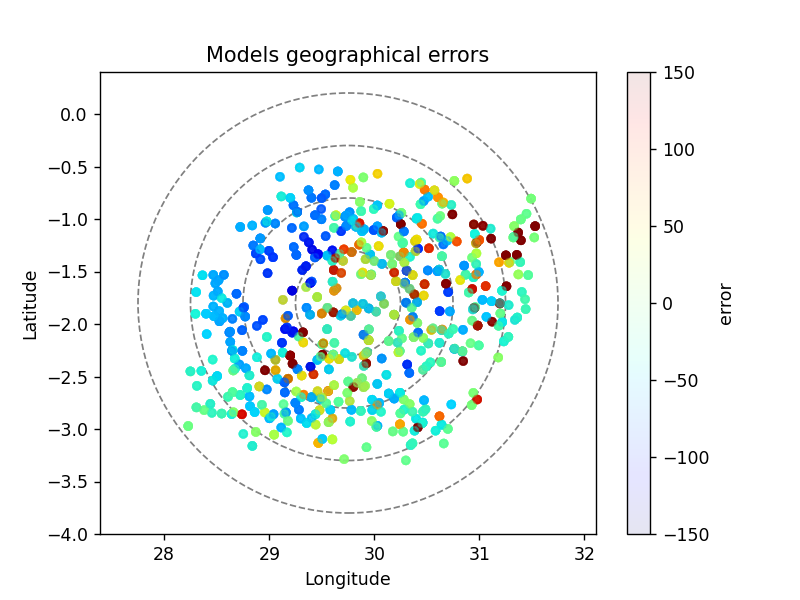

In [92]:
geographical_emission_error(result_lin_reg)

<IPython.core.display.Javascript object>


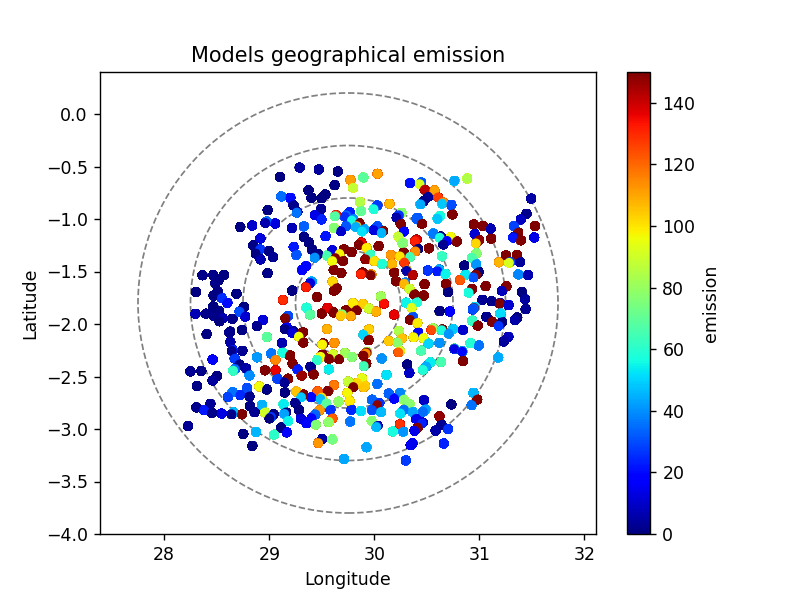

In [93]:
# Centre des coordonnées (exemple)
center_latitude = y0
center_longitude = x0

# Création des rayons avec un pas de 0.5 jusqu'à un certain maximum
max_radius = 2
radii = np.arange(0.5, max_radius + 0.5, 0.5)

# Création du graphique
fig, ax = plt.subplots()

# Dessiner les cercles
for radius in radii:
    circle = plt.Circle((center_longitude, center_latitude), radius, fill=False, color='grey', linestyle='dashed')
    ax.add_patch(circle)

# Ajouter les points de données
data_train.plot(kind="scatter", x="longitude", y="latitude", c="emission", cmap=plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150, ax=ax)

# Paramètres du graphique
ax.set_aspect('equal', adjustable='datalim')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Models geographical emission', fontsize=12)

# Afficher le graphique
plt.show()

Ajouter les caractéristique latitude et longitude pour mieux identifier les villes de forte consomation (la distribution n'est pas parfaitement circulaire)

<IPython.core.display.Javascript object>


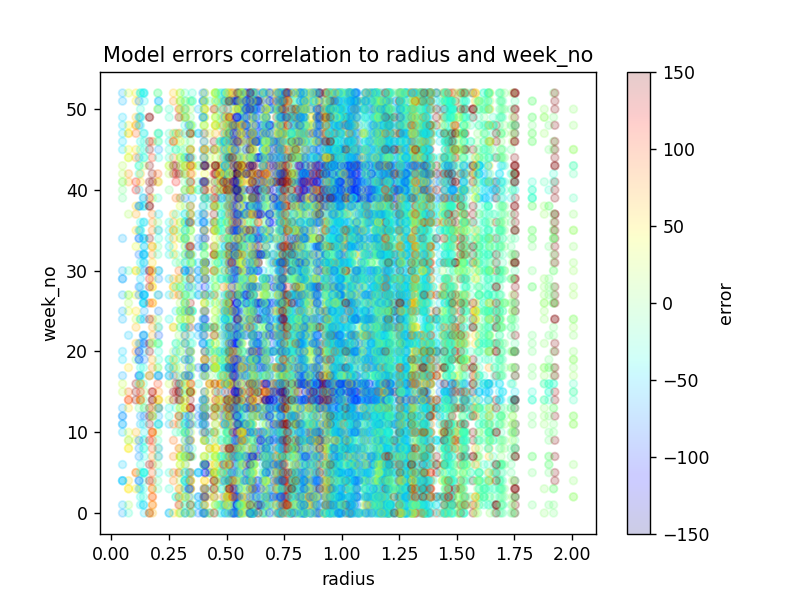

In [94]:
emission_error_correlation(result_lin_reg)

On observe que les semaine de forte consomation sont moins facilement prédictible. On peut ainsi intégrer un paramètre qui combine le rayon et le fait qu'il s'agit d'une semaine de forte consomation comme cette idée avait déjà pu être abordé dans la partie **2.6 Les caractéristiques temporelles et les semaines de surconsomations**

#### Fit 2

In [94]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 

<IPython.core.display.Javascript object>


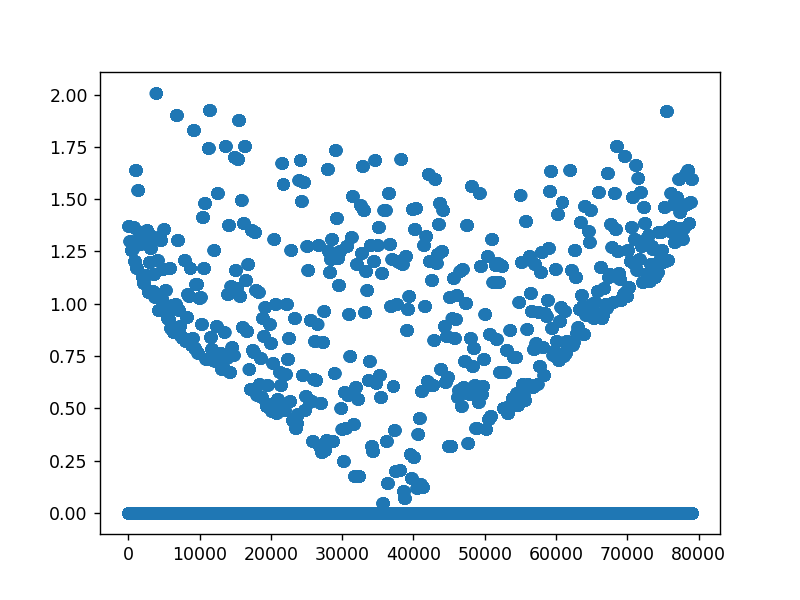

In [95]:
plt.figure()
plt.scatter(data_train.index, data_train['radius * high_emission_week'])
plt.show()

In [96]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'radius * high_emission_week']

In [97]:
y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [98]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [99]:
# Créer et entraîner le modèle
linear_regressor = LinearRegression()
linear_regressor.fit(X_train, y_train)

# Prédire sur l'ensemble de test
y_pred = linear_regressor.predict(X_test)

In [100]:
# Afficher les coefficients
print(f"Coefficient (pente) : {linear_regressor.coef_}")
print(f"Ordonnée à l'origine : {linear_regressor.intercept_}")

# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Coefficient (pente) : [ -7.70460354  22.5975807  -32.37676604  35.21153872 -26.77827677]
Ordonnée à l'origine : 82.37861301238485
Erreur quadratique moyenne (RMSE) : 122.13
Score R² : 0.09


<IPython.core.display.Javascript object>


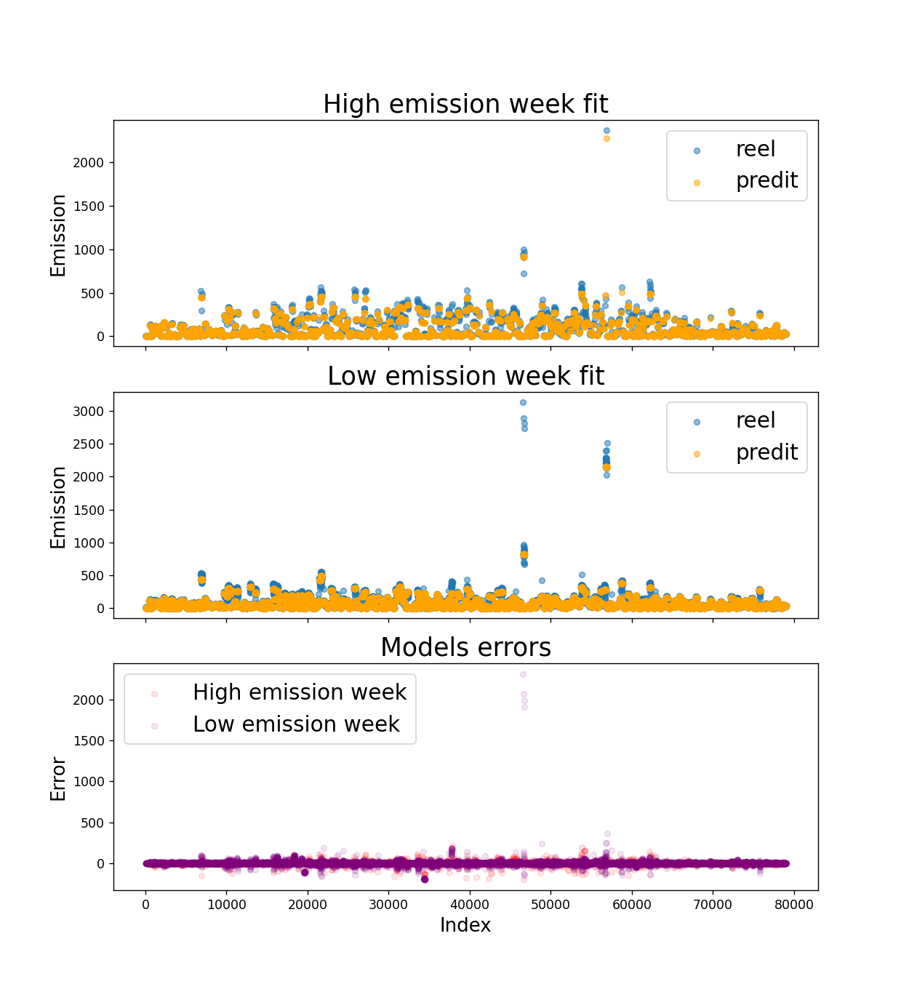

In [123]:
result_lin_reg = result_df(data_train, X ,y_test ,y_pred)
check_model(result_lin_reg)

<IPython.core.display.Javascript object>


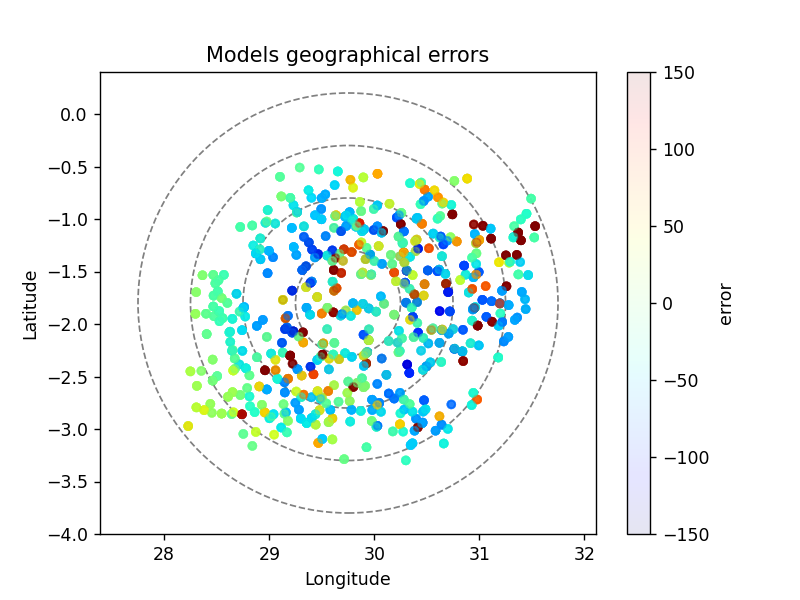

<IPython.core.display.Javascript object>


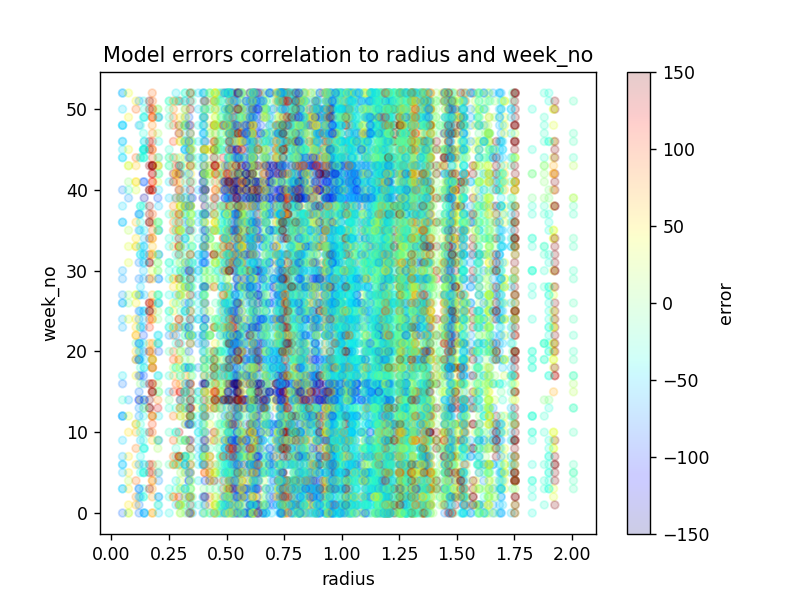

In [122]:
geographical_emission_error(result_lin_reg)
emission_error_correlation(result_lin_reg)

Cherchons à mieux comprendre la relation entre **rayon** et **emission**

In [54]:
data_group_rayon = data_train[data_train['high_emission_week']<=0.5].groupby(['radius', 'week_no'])['emission'].mean()

# Convert the result back to a DataFrame if needed
data_group_rayon = data_group_rayon.reset_index()
data_group_rayon

,radius,week_no,emission
0,0.048042,0,84.231020
1,0.048042,1,96.233502
2,0.048042,2,99.360750
3,0.048042,3,99.791799
4,0.048042,4,101.546683
...,...,...,...
22225,2.007379,48,4.988613
22226,2.007379,49,4.982809
22227,2.007379,50,5.228267
22228,2.007379,51,5.096012


<IPython.core.display.Javascript object>


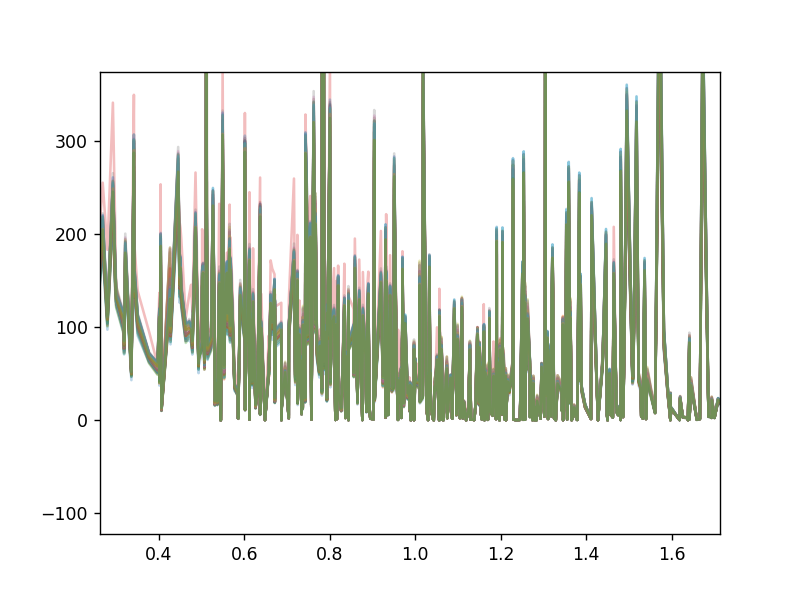

In [55]:
plt.figure()
for i in range(53):
    df = data_group_rayon[data_group_rayon['week_no']==i]
    plt.plot(df['radius'], df['emission'], alpha=0.3, label=f'week {i}')
plt.show()

Conclusion les emissions carbonne son ultra dépendant du rayon mais pas de façon linéaire. Le modèle est sous-ajusté (underfitting).

Ainsi le choix de la régression linéaire n'est peut être pas le choix le plus pertinent

- **K Nearest Neighbors (KNN)** devrait bien marché puisqu'il prédirait des valeurs d'émission similaire à celle ayant un rayon et un week_no similaire.

- **Support Vector Machine (SVM)** devrait donner un bon résultat aussi en cherchant à déterminer une frontière au figure que l'on a pu voir entre rayon, week_no et emission qui graphiquement avait un patterne assez prévisible

En dernier recourt nous chercherons à améliorer le modèle en ayant recourt à un **Neural Network**

### 3. K Nearest Neighbors

In [106]:
from sklearn.neighbors import KNeighborsRegressor

#### Fit 1

In [107]:
features_list = ['radius', 'high_emission_week']

In [108]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [109]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [110]:
# Create and train the KNN regressor
knn_regressor = KNeighborsRegressor(n_neighbors=5)
knn_regressor.fit(X_train, y_train)

# Make predictions on the test data
y_pred = knn_regressor.predict(X_test)

In [113]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 39.73
Score R² : 0.90


<IPython.core.display.Javascript object>


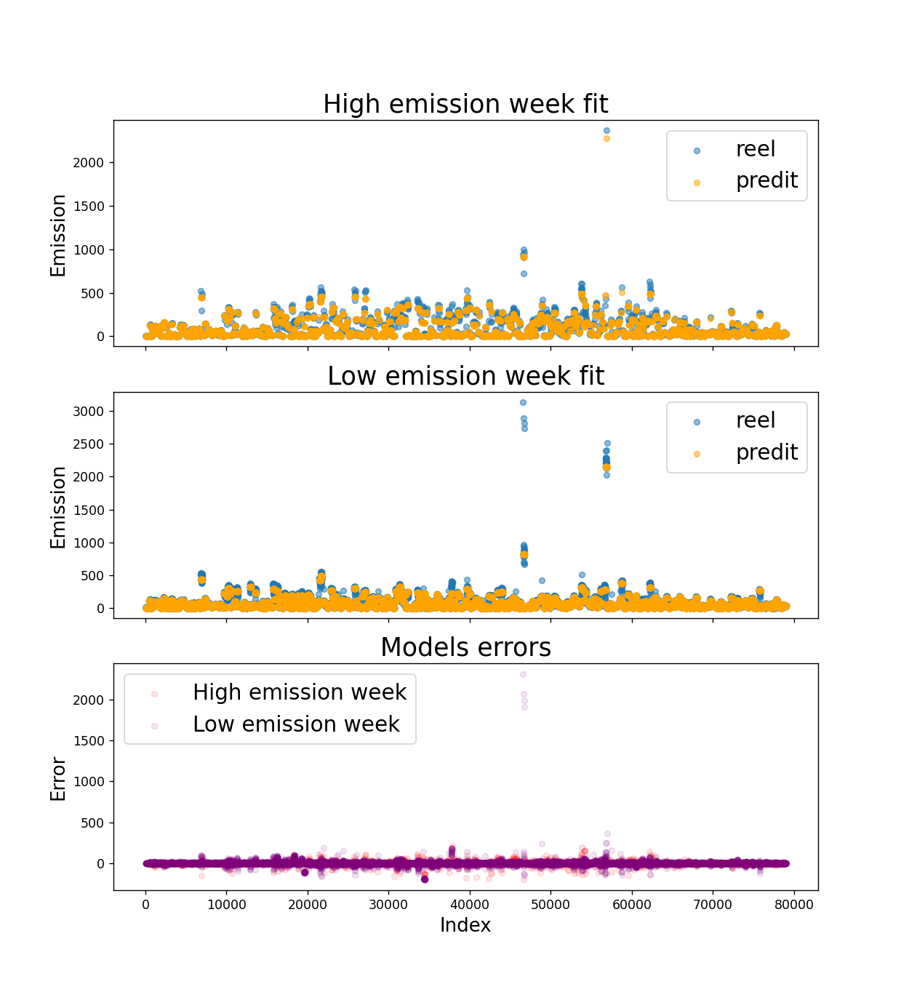

In [120]:
result_knn = result_df(data_train, X ,y_test ,y_pred)

check_model(result_knn)

<IPython.core.display.Javascript object>


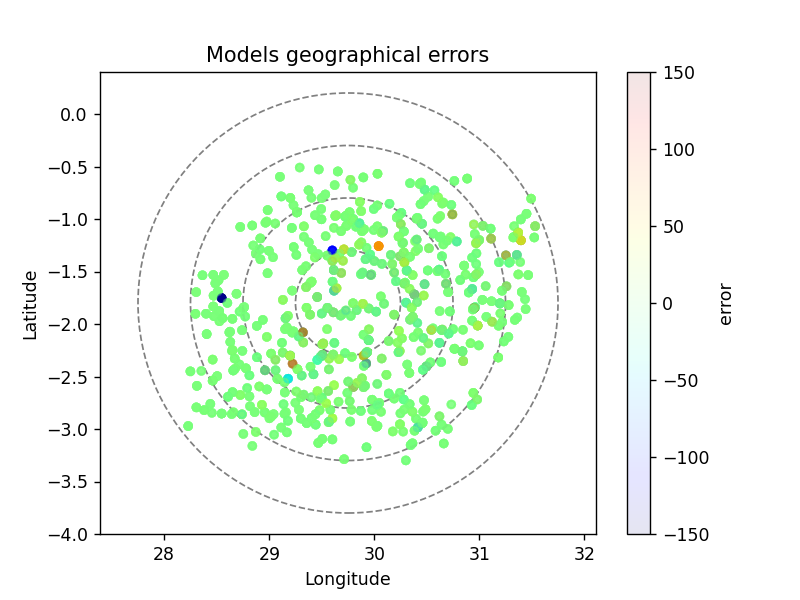

<IPython.core.display.Javascript object>


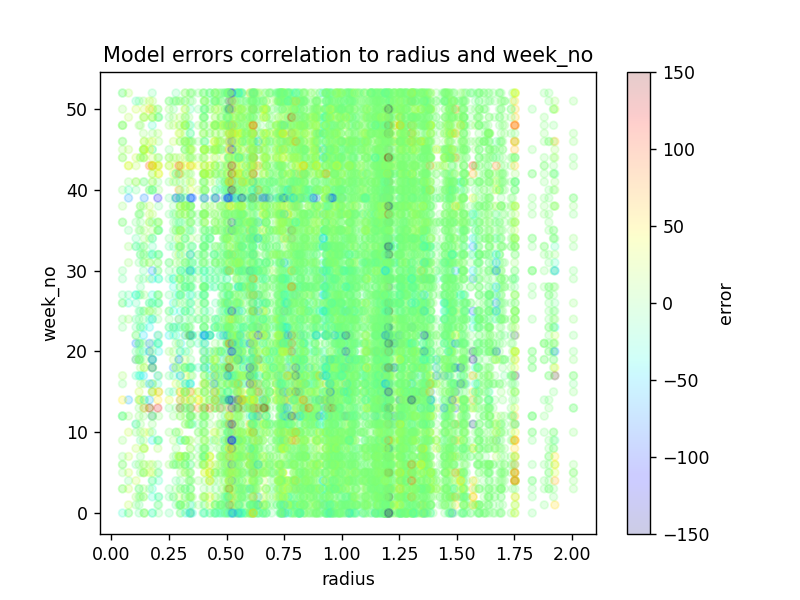

In [121]:
geographical_emission_error(result_knn)
emission_error_correlation(result_knn)

Ca s'ajuste beaucoup mieux !

#### Fit 2

In [263]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 

features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

In [264]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
#X=data_train.copy().drop('emission', axis='columns')
X_transformed = num_pipeline.fit_transform(X)

In [265]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [266]:
# Create and train the KNN regressor
knn_regressor = KNeighborsRegressor(n_neighbors=5)
knn_regressor.fit(X_train, y_train)

# Make predictions on the test data
y_pred = knn_regressor.predict(X_test)

In [267]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 42.18
Score R² : 0.89


<IPython.core.display.Javascript object>


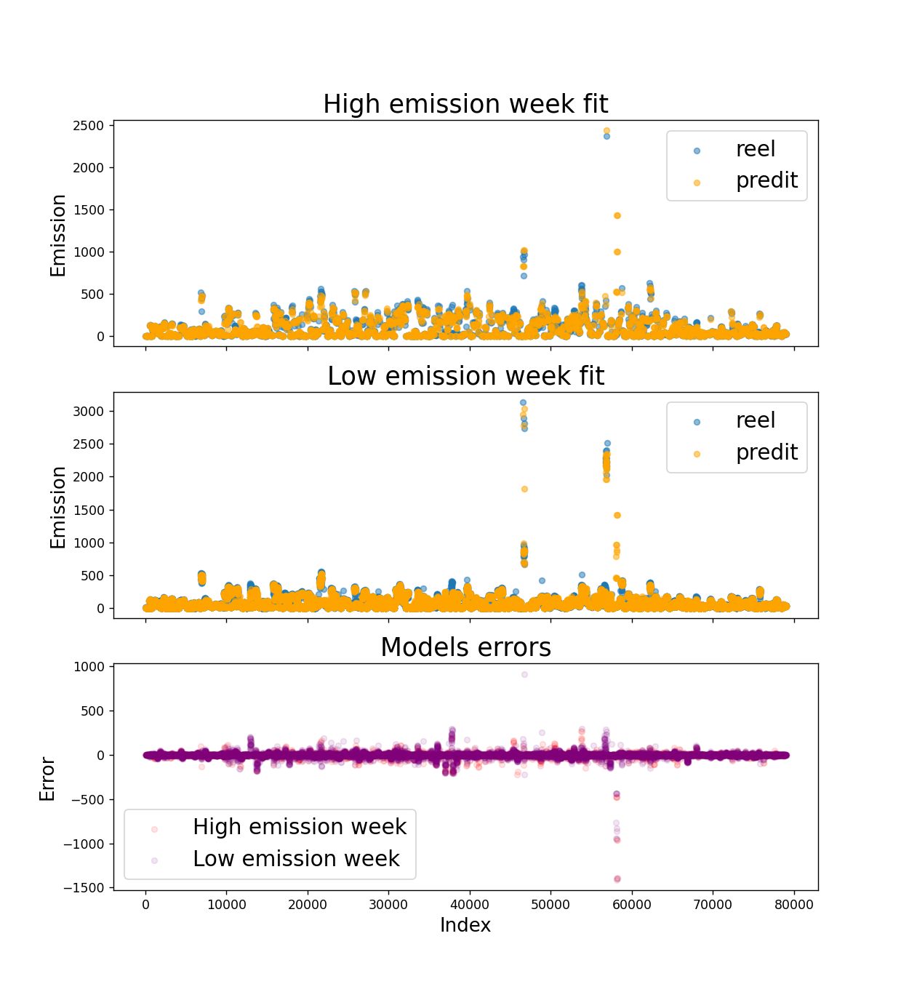

In [268]:
result_knn = result_df(data_train, X ,y_test ,y_pred)

check_model(result_knn)

<IPython.core.display.Javascript object>


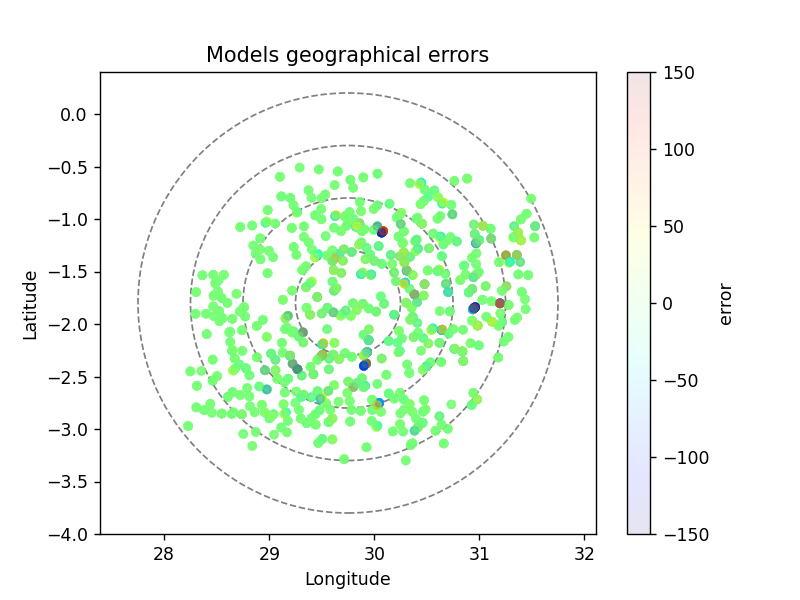

<IPython.core.display.Javascript object>


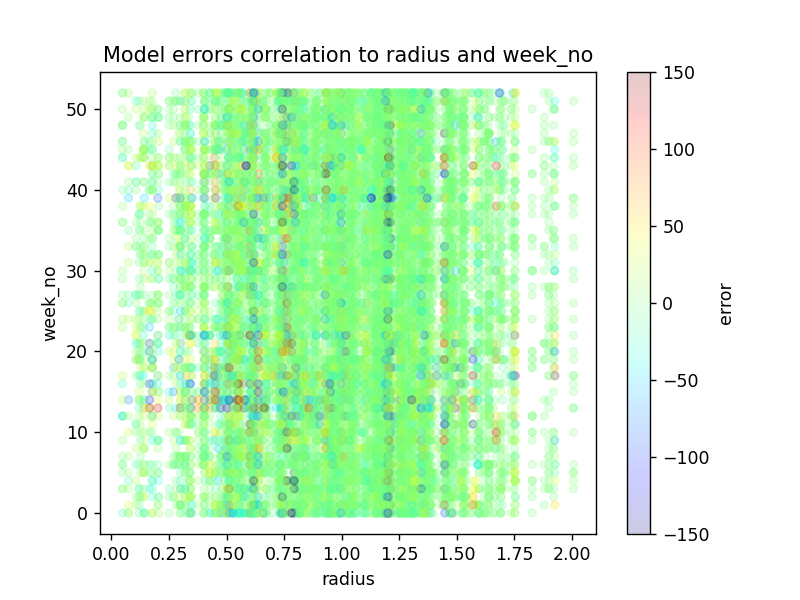

In [269]:
geographical_emission_error(result_knn)
emission_error_correlation(result_knn)

Ce modèle donne des un moins bon résultat lorsque l'on considère davantage de caractéristique, cependant il peut rester une bonne option si le modèle précédent était en surapprentissage.

### 4. Support Vector Machine

In [126]:
from sklearn.svm import SVR

Par analogie à une reconnaissance de visage ou une reconnaissance de chiffre manuscrit, l'intérêt de cette approche sera que le modèle intègre le patterne de ce graphique d'une façon plus précise que le modèle KNN:

<IPython.core.display.Javascript object>


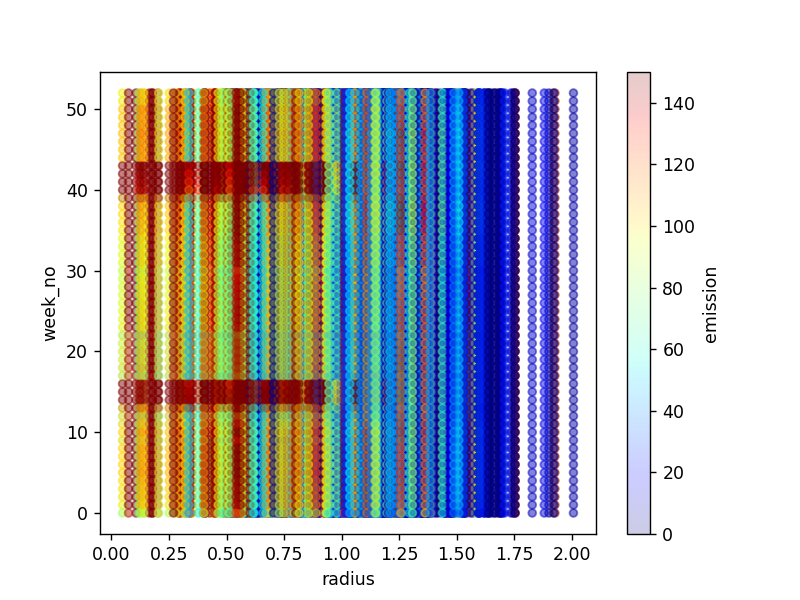

In [125]:
# You can adjust the number of bins for color sensitivity
data_train.plot(kind="scatter", x="radius", y="week_no", c="emission", cmap= plt.get_cmap("jet"), colorbar=True, vmin=0, vmax=150, alpha=0.2)
plt.show()

La forme étant relativement complexe nous emploirons le SVR avec un noyaux RBF (Radial Basis Function)

In [129]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 

features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

In [130]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [131]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

#### RBF

In [132]:
# Create and train the KNN regressor
svr_rbf = SVR(kernel="rbf", C=100, gamma=0.1, epsilon=0.1)
svr_rbf.fit(X_train, y_train)

# Make predictions on the test data
y_pred = svr_rbf.predict(X_test)

In [133]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 121.33
Score R² : 0.11


<IPython.core.display.Javascript object>


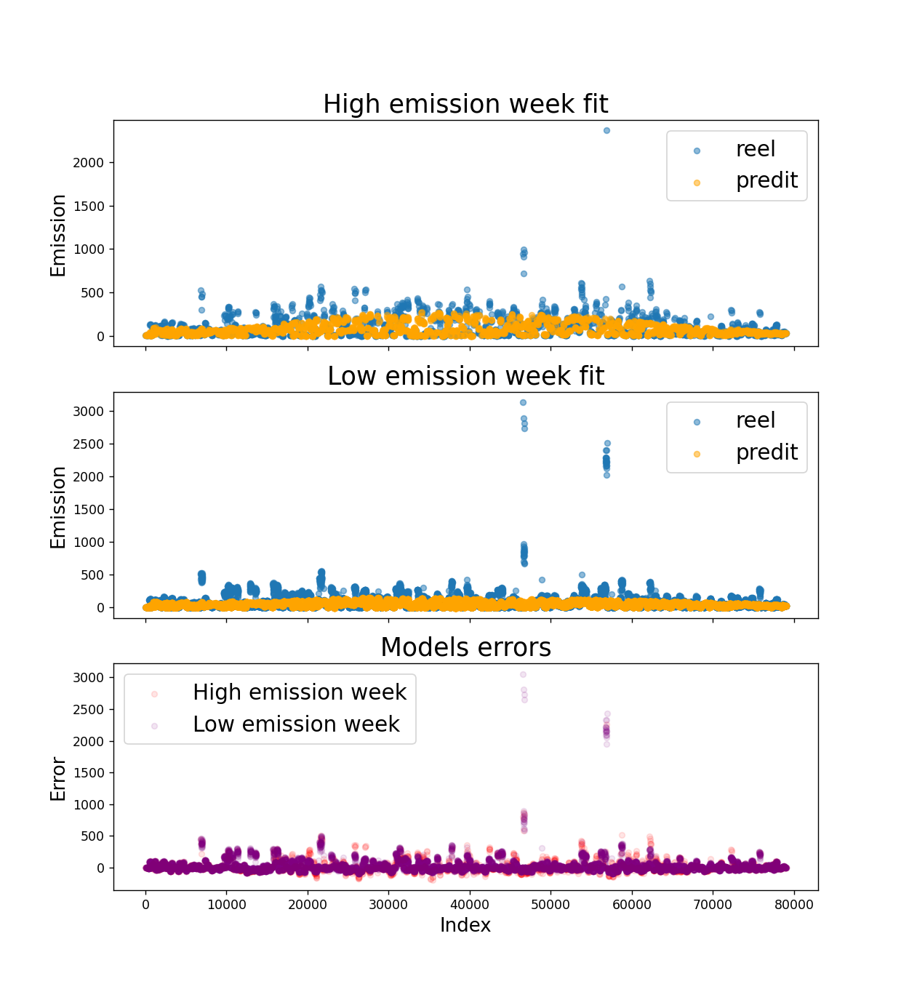

In [134]:
result_svm = result_df(data_train, X ,y_test ,y_pred)

check_model(result_svm)

<IPython.core.display.Javascript object>


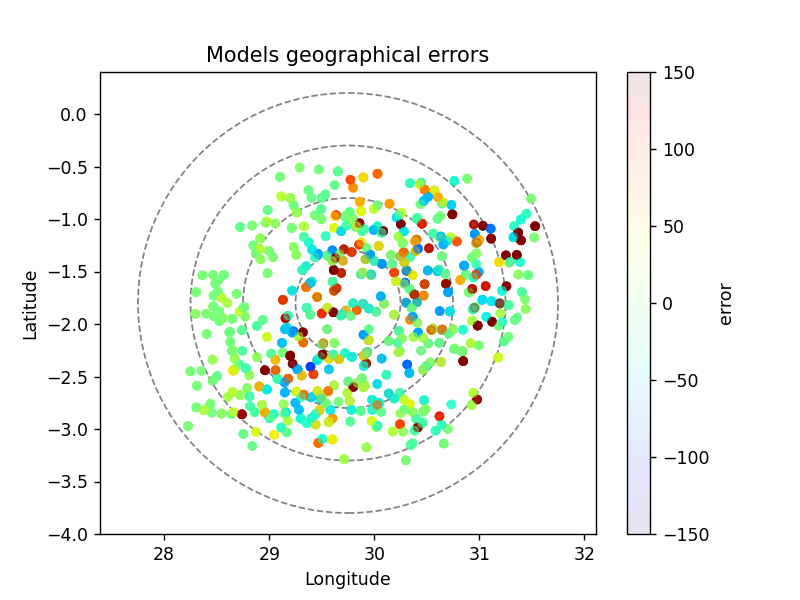

<IPython.core.display.Javascript object>


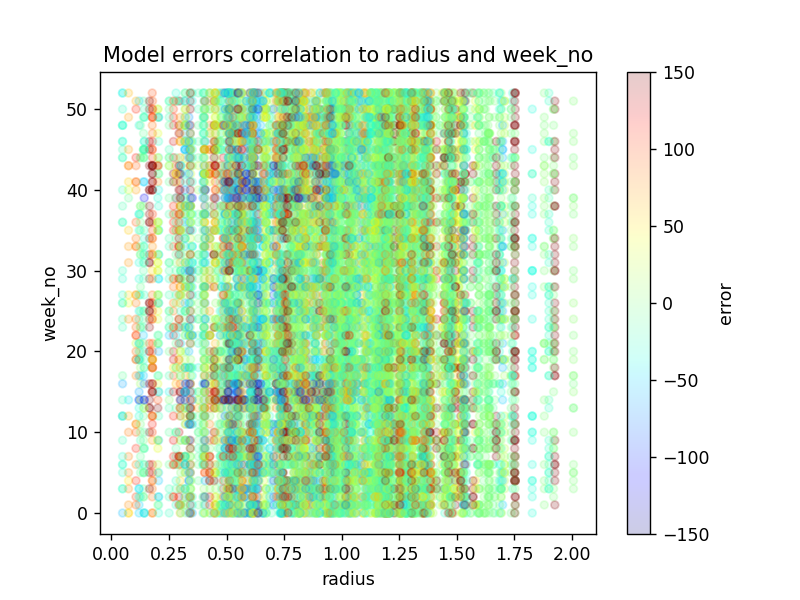

In [135]:
geographical_emission_error(result_svm)
emission_error_correlation(result_svm)

Comme pour la Régression Linéaire, il semblerait que ce modèle soit moins adapté à notre type de donée.

De plus, contrairement aux modèles précédents il est de complexité bien plus importante...

### 5. Gradient Boosting

In [136]:
from sklearn.ensemble import GradientBoostingRegressor

When max_depth > number of feature then the same feature can be used multiple times in different parts of the tree.It is useful when the relationship between features and target is non-linear (which we have clearly observed previously)

#### Fit 1

In [139]:
features_list = ['radius', 'high_emission_week']

In [140]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [141]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [142]:
# Create and train the KNN regressor
model_gbr =GradientBoostingRegressor(n_estimators=5, learning_rate=0.1, max_depth=5)
model_gbr.fit(X_train, y_train)

# Make predictions on the test data
y_pred = model_gbr.predict(X_test)

In [143]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 99.32
Score R² : 0.40


#### Fit 2

In [144]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 

features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

In [145]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [146]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [147]:
# Create and train the KNN regressor
model_gbr =GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=5)
model_gbr.fit(X_train, y_train)

# Make predictions on the test data
y_pred = model_gbr.predict(X_test)

In [148]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 37.40
Score R² : 0.91


<IPython.core.display.Javascript object>


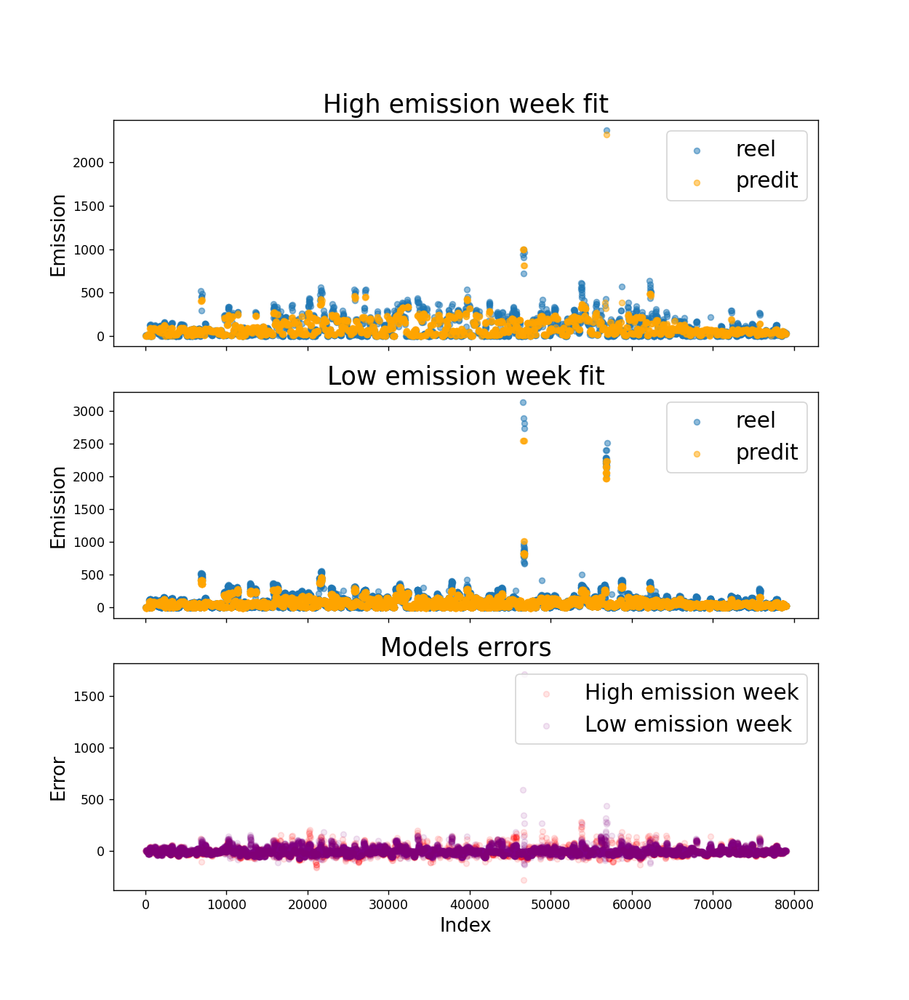

In [149]:
result_gbr = result_df(data_train, X ,y_test ,y_pred)

check_model(result_gbr)

C:\Users\sebas\AppData\Local\Temp\ipykernel_10564\1725903248.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


<IPython.core.display.Javascript object>


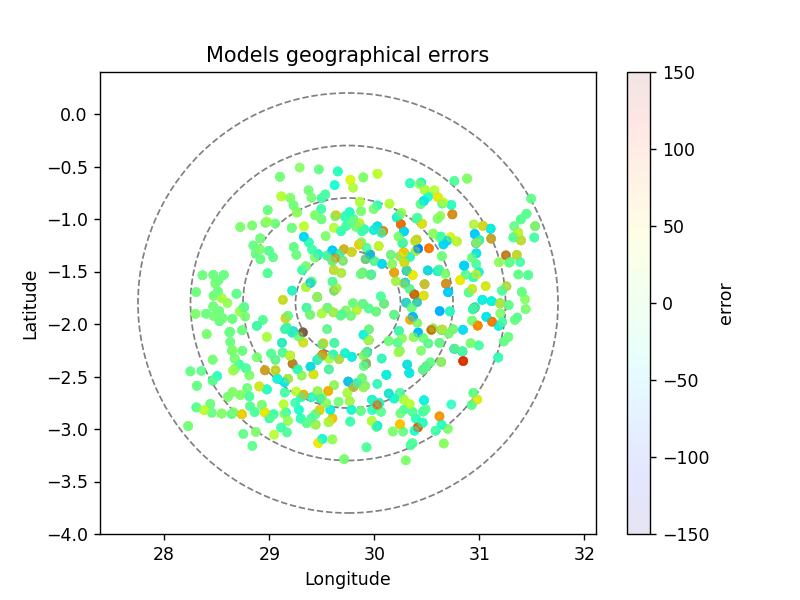

<IPython.core.display.Javascript object>


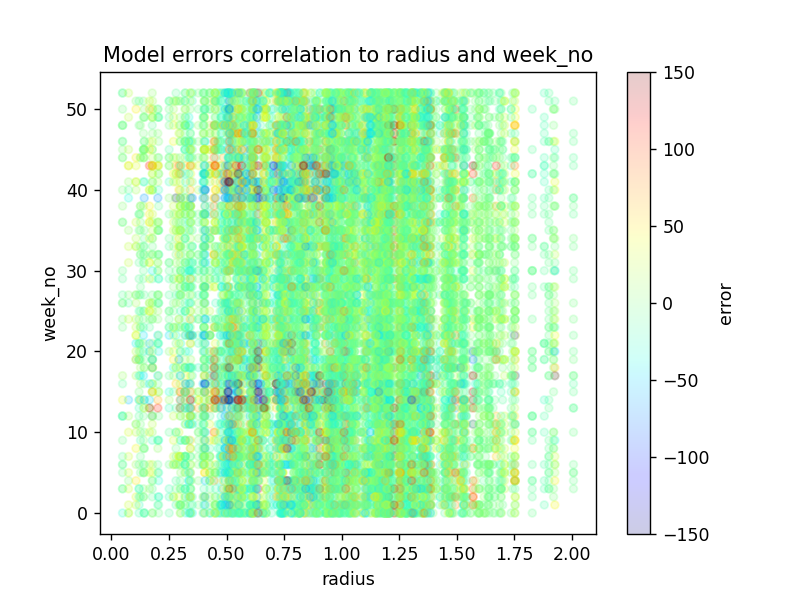

In [150]:
geographical_emission_error(result_gbr)
emission_error_correlation(result_gbr)

On remarque que le modèle comprend bien les tendance globale mais pas les variations locale. Pour ne pas qu'il fasse de l'underfitting il a fallu augmenter n_estimators (le nombre d'arbre de décision). Augmenter max_depth (la taille des arbres de décision peut générer de l'overfitting très rapidement comme on a choisit de n'utiliser pas beaucoup de caractéristiques).

Ce modèle est pertinent et comme le KNN il faudra faire attention à l'overfitting

### 6. Random Forest

In [151]:
from sklearn.ensemble import RandomForestRegressor

#### Fit 1

In [152]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 

features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

In [153]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [154]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [155]:
# Create and train the KNN regressor
rf_regressor = RandomForestRegressor(n_estimators=120, max_depth=5, random_state=42)
rf_regressor.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_regressor.predict(X_test)

In [156]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 64.68
Score R² : 0.75


<IPython.core.display.Javascript object>


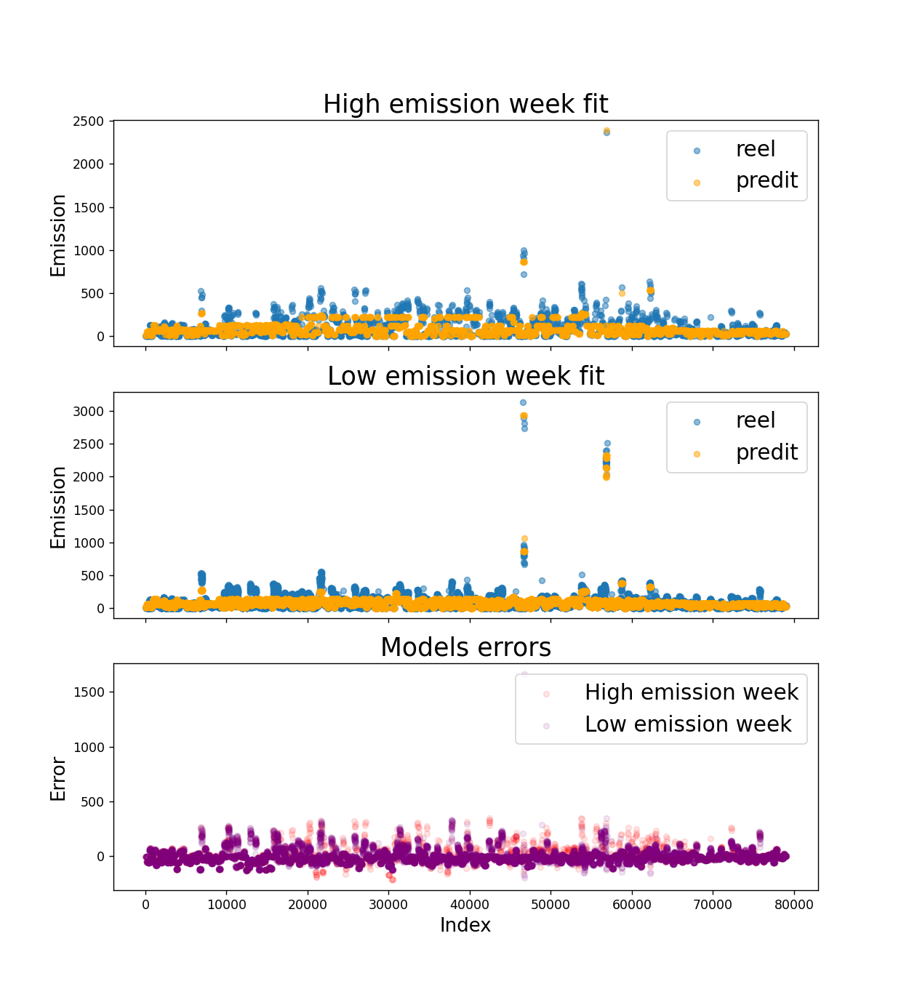

In [157]:
result_rf = result_df(data_train, X ,y_test ,y_pred)

check_model(result_rf)

Comme on pouvait s'y attendre random forest est moins précis et identifie moins bien les variation mais et aussi moins suceptible de faire l'overfitting comme grandient boosting ...

Le modèle est donc plutôt bon puisqu'il semble bien prédire les émission carbone à l'aide de 5/6 courbes de tendances seulement.

<IPython.core.display.Javascript object>


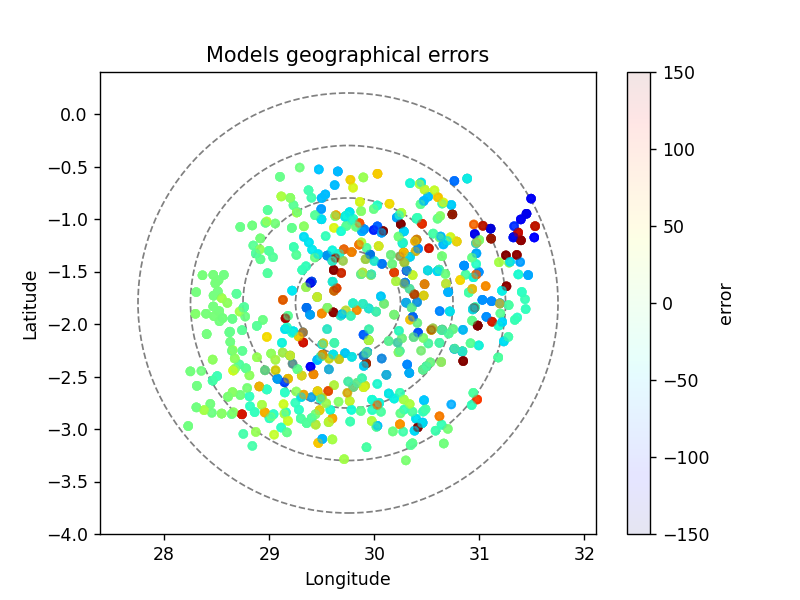

<IPython.core.display.Javascript object>


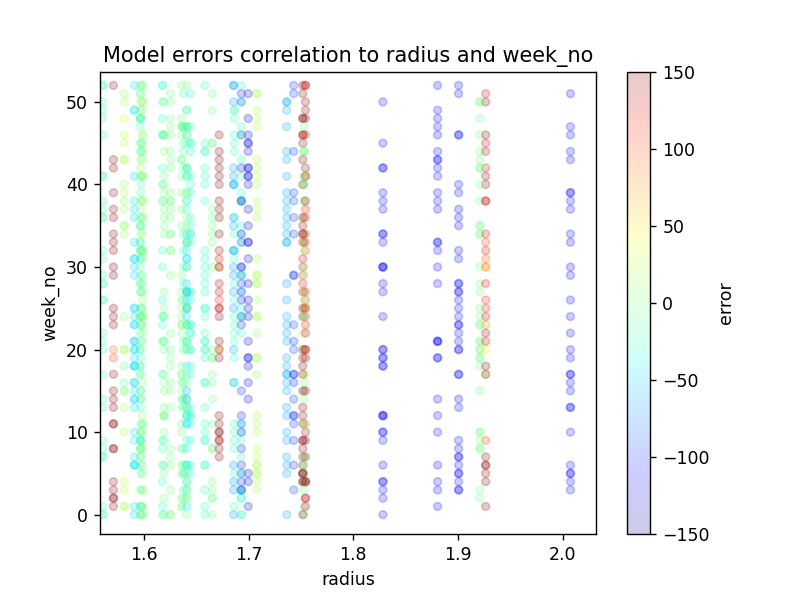

In [158]:
geographical_emission_error(result_rf)
emission_error_correlation(result_rf)

In [164]:
fig, ax = plt.subplots()
result_rf.plot(kind="scatter", x="radius", y="week_no", c="error", cmap= plt.get_cmap("jet"), 
            colorbar=True, vmin=-150, vmax=150, ax=ax, alpha=0.2)
ax.set_title('Model errors correlation to radius and week_no', fontsize=12)
plt.plot([1.67]* len(result_rf), result_rf["week_no"], c="purple")
plt.show()

<IPython.core.display.Javascript object>

On remaque qu'on pourrait améliorer ce modèle en rajoutant une disjonction de cas Rayon > 1.67

#### Fit 2

In [170]:
data_train['radius * high_emission_week'] = data_train['radius'] * data_train['high_emission_week'] 
data_train['high radius'] = 1*(data_train['radius'] > 1.67)

features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week', 'high radius']

In [171]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [172]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [173]:
# Create and train the KNN regressor
rf_regressor = RandomForestRegressor(n_estimators=120, max_depth=5, random_state=42)
rf_regressor.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_regressor.predict(X_test)

In [174]:
# Évaluer la performance
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)
print(f"Erreur quadratique moyenne (RMSE) : {rmse:.2f}")
print(f"Score R² : {r2:.2f}")

Erreur quadratique moyenne (RMSE) : 64.68
Score R² : 0.75


<IPython.core.display.Javascript object>


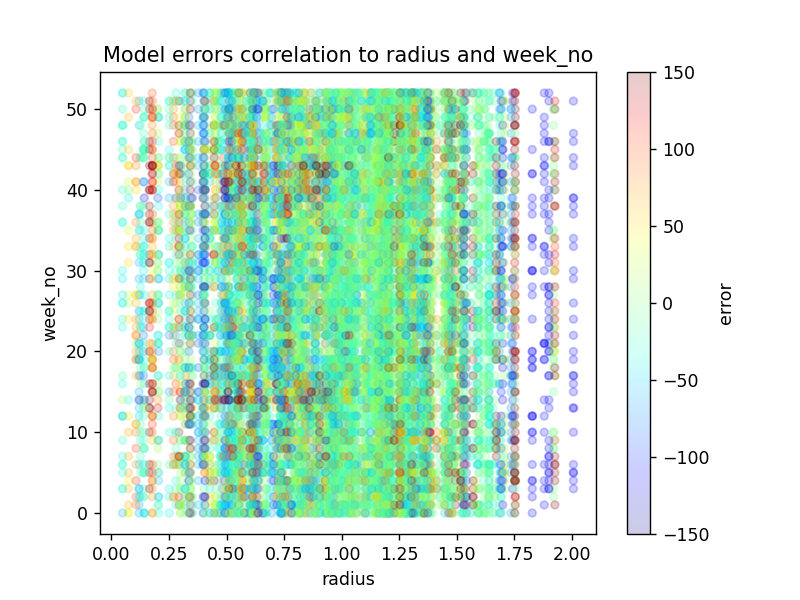

In [176]:
result_rf = result_df(data_train, X ,y_test ,y_pred)
emission_error_correlation(result_rf)

Ca ne change rien ...

### 7. Neural Network

In [212]:
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam

Commencons par tester un réseau de Neuronnes avec l'ensemble des caractéristiques

In [213]:
y=data_train['emission'].copy()
X=data_train.copy().drop('emission', axis='columns')
X_transformed = num_pipeline.fit_transform(X)

In [214]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [215]:
model_nn = keras.Sequential([
    keras.layers.Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    keras.layers.Dense(32, activation='relu'),
    keras.layers.Dense(1)  # 1 sortie pour prédiction continue
])

In [216]:
model_nn.compile(optimizer='adam', loss='mse', metrics=['mae'])

model_nn.fit(X_train, y_train, epochs=10, batch_size=16, validation_data=(X_test, y_test))

y_pred = model_nn.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))  # RMSE
r2 = r2_score(y_test, y_pred)  # Coefficient de détermination

print(f"RMSE sur le test set : {rmse:.2f}")
print(f"R² sur le test set : {r2:.4f}")  # R² proche de 1 = bon modèle

Epoch 1/10
3952/3952 [==============================] - 5s 1ms/step - loss: 20587.6875 - mae: 64.1795 - val_loss: 14477.4805 - val_mae: 60.7849
Epoch 2/10
3952/3952 [==============================] - 4s 1ms/step - loss: 19483.0137 - mae: 60.9246 - val_loss: 14106.3125 - val_mae: 57.0966
Epoch 3/10
3952/3952 [==============================] - 5s 1ms/step - loss: 19295.6855 - mae: 60.3495 - val_loss: 14017.7920 - val_mae: 57.8167
Epoch 4/10
3952/3952 [==============================] - 5s 1ms/step - loss: 19109.1445 - mae: 60.1609 - val_loss: 14022.2939 - val_mae: 59.7598
Epoch 5/10
3952/3952 [==============================] - 4s 1ms/step - loss: 18830.8438 - mae: 60.1576 - val_loss: 13642.4697 - val_mae: 57.7535
Epoch 6/10
3952/3952 [==============================] - 4s 1ms/step - loss: 18469.2949 - mae: 60.1207 - val_loss: 13490.4795 - val_mae: 57.3606
Epoch 7/10
3952/3952 [==============================] - 4s 1ms/step - loss: 18106.9707 - mae: 59.9316 - val_loss: 13704.9072 - val_mae: 

<IPython.core.display.Javascript object>


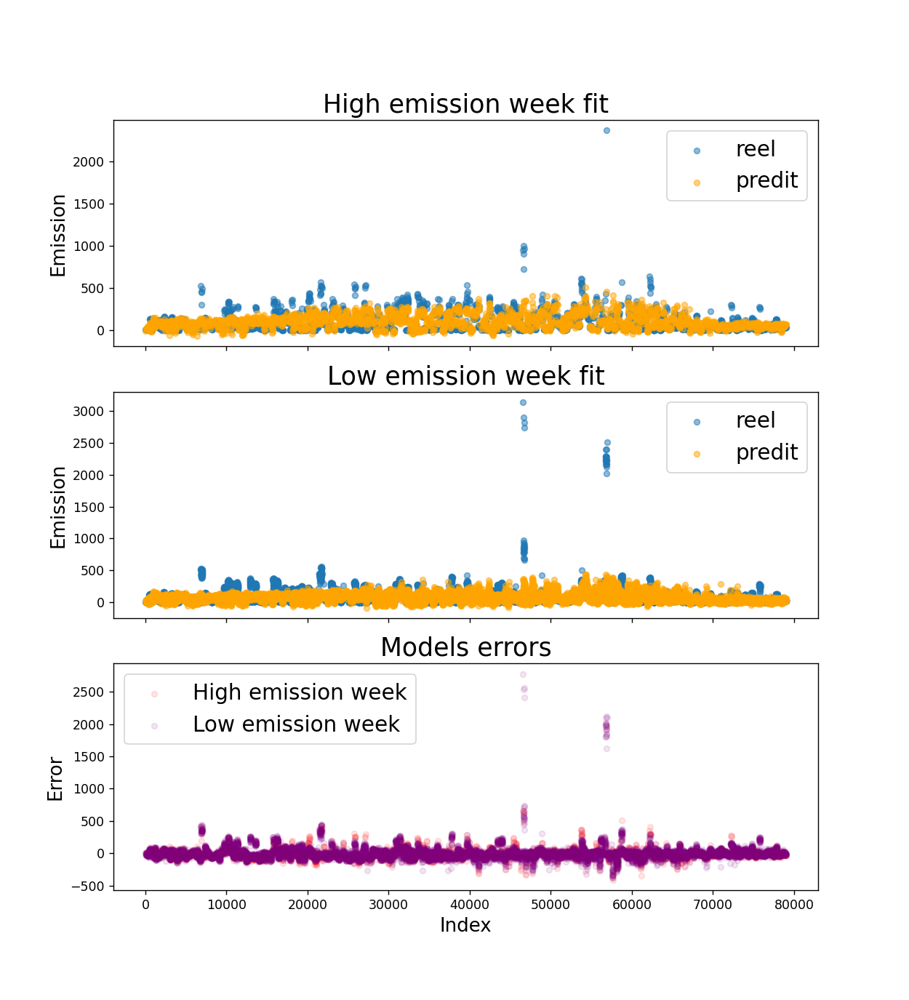

In [217]:
result_nn = result_df(data_train, X ,y_test ,y_pred)

check_model(result_nn)

<IPython.core.display.Javascript object>


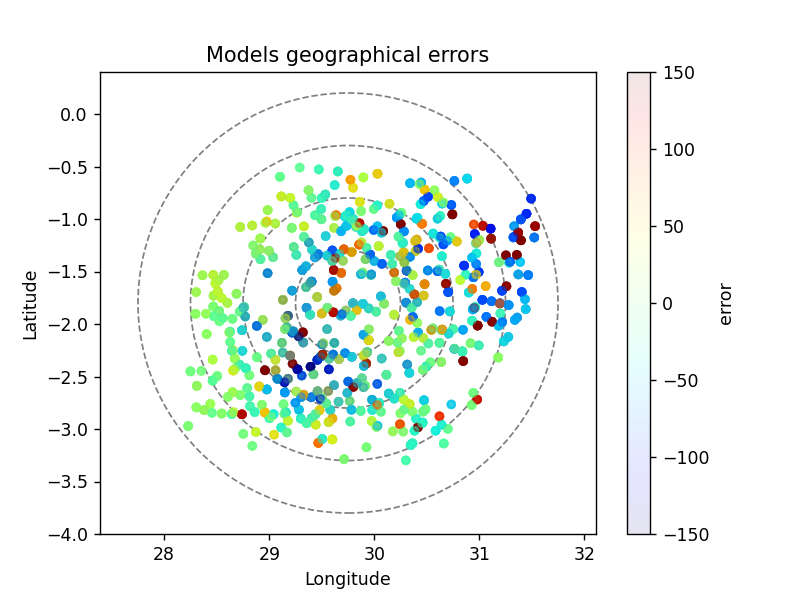

<IPython.core.display.Javascript object>


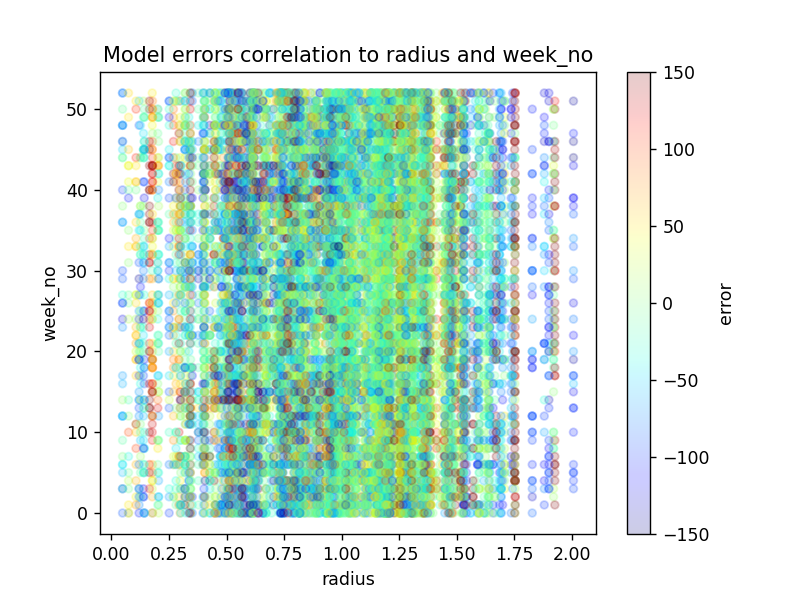

In [218]:
geographical_emission_error(result_nn)
emission_error_correlation(result_nn)

### Fit 2

**Identifions les caractéristiques utilent à la prédiction des emissions CO2**

On mélange les lignes, colonnes par colonnes. Quand on mélange les données d'une caractéristique, sa relation avec la donnée à prédire sera détruite. Ainsi si les erreurs comisent par le modèle change beaucoup alors c'est bien qu'il exite une forte coorélation entre la caractéristique est la qualité du modèle.  

In [219]:
def permutation_importance(model, X_test, y_test, feature_index, n_repeats=5):
    """Perturbe une seule feature et mesure l'impact sur la prédiction"""
    X_test_permuted = X_test.copy()
    baseline_rmse = np.sqrt(mean_squared_error(y_test, model.predict(X_test)))

    importance_scores = []
    for _ in range(n_repeats):
        np.random.shuffle(X_test_permuted[:, feature_index])#we only keep colomn_name feature
        rmse_permuted = np.sqrt(mean_squared_error(y_test, model.predict(X_test_permuted)))
        importance_scores.append(rmse_permuted - baseline_rmse)

    return np.mean(importance_scores)

In [221]:
# Calcul de l'importance pour chaque variable
feature_importances = [permutation_importance(model_nn, X_test, y_test, i) for i in range(X_test.shape[1])] 

494/494 [==============================] - 0s 800us/step


494/494 [==============================] - 0s 782us/step
Feature latitude impact the RMSE of = 7.7855
Feature longitude impact the RMSE of = 7.7855
Feature year impact the RMSE of = 7.7855
Feature week_no impact the RMSE of = 7.7855
Feature SulphurDioxide_SO2_column_number_density impact the RMSE of = 7.7855
Feature SulphurDioxide_SO2_column_number_density_amf impact the RMSE of = 7.7855
Feature SulphurDioxide_SO2_slant_column_number_density impact the RMSE of = 7.7855
Feature SulphurDioxide_cloud_fraction impact the RMSE of = 7.7855
Feature SulphurDioxide_sensor_azimuth_angle impact the RMSE of = 7.7855
Feature SulphurDioxide_sensor_zenith_angle impact the RMSE of = 7.7855
Feature SulphurDioxide_solar_azimuth_angle impact the RMSE of = 7.7855
Feature SulphurDioxide_solar_zenith_angle impact the RMSE of = 7.7855
Feature SulphurDioxide_SO2_column_number_density_15km impact the RMSE of = 7.7855
Feature CarbonMonoxide_CO_column_number_density impact the RMSE of = 7.7855
Feature CarbonMono

In [227]:
pd.set_option('display.max_rows', 78)

In [228]:
classify_features_nn_model = pd.DataFrame(index = X.columns)
classify_features_nn_model["score"] = feature_importances
classify_features_nn_model = classify_features_nn_model.sort_values(by='score', ascending=False)
classify_features_nn_model

,score
radius,62.378816
longitude,23.476944
latitude,14.803555
high_emission_week,6.635703
Cloud_surface_albedo,5.852344
high radius,3.821519
radius * high_emission_week,3.801328
Ozone_sensor_zenith_angle,3.331693
UvAerosolIndex_sensor_azimuth_angle,1.547961
UvAerosolIndex_sensor_zenith_angle,1.410495


Les caractéristiques ayant un bon scores sont celles que l'on a l'habitude de tester. On peut également ajouter à nos modèles :
- Cloud_surface_albedo
- Ozone_sensor_zenith_angle

Gardons les features dont la suppression baisse le RMSE pour un seuil donnée

In [240]:
seuil = 1
features_list = classify_features_nn_model[classify_features_nn_model["score"]>seuil].index
features_list

In [242]:
y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [243]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [244]:
model_nn = keras.Sequential([
    keras.layers.Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    keras.layers.Dense(32, activation='relu'),
    keras.layers.Dense(1)  # 1 sortie pour prédiction continue
])

In [259]:
model_nn.compile(optimizer='adam', loss='mse', metrics=['mae'])

history = model_nn.fit(X_train, y_train, epochs=100, batch_size=16, validation_data=(X_test, y_test))

Epoch 1/100
3952/3952 [==============================] - 5s 1ms/step - loss: 4324.6919 - mae: 38.5113 - val_loss: 3846.1201 - val_mae: 37.6616
Epoch 2/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4384.5342 - mae: 38.6547 - val_loss: 4604.4062 - val_mae: 42.0709
Epoch 3/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4351.9443 - mae: 38.4403 - val_loss: 4142.6343 - val_mae: 42.3770
Epoch 4/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4295.4355 - mae: 38.2474 - val_loss: 3639.9177 - val_mae: 36.5107
Epoch 5/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4301.1230 - mae: 38.2773 - val_loss: 4464.5894 - val_mae: 42.2353
Epoch 6/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4265.0283 - mae: 38.1768 - val_loss: 3682.7463 - val_mae: 36.9263
Epoch 7/100
3952/3952 [==============================] - 4s 1ms/step - loss: 4290.1997 - mae: 38.0315 - val_loss: 3805.4177 - val_mae: 39.5772

Epoch 58/100
3952/3952 [==============================] - 4s 1ms/step - loss: 3822.4380 - mae: 35.9891 - val_loss: 3298.8591 - val_mae: 36.5235
Epoch 59/100
3952/3952 [==============================] - 4s 1ms/step - loss: 3820.4585 - mae: 35.7735 - val_loss: 3465.5339 - val_mae: 36.2840
Epoch 60/100
3952/3952 [==============================] - 5s 1ms/step - loss: 3845.8210 - mae: 36.1038 - val_loss: 3350.0476 - val_mae: 34.6431
Epoch 61/100
3952/3952 [==============================] - 5s 1ms/step - loss: 3821.2134 - mae: 35.6915 - val_loss: 3789.9841 - val_mae: 37.4174
Epoch 62/100
3952/3952 [==============================] - 4s 1ms/step - loss: 3831.9504 - mae: 35.6947 - val_loss: 3906.5381 - val_mae: 37.8335
Epoch 63/100
3952/3952 [==============================] - 4s 1ms/step - loss: 3825.8167 - mae: 35.7963 - val_loss: 3468.5652 - val_mae: 36.9375
Epoch 64/100
3952/3952 [==============================] - 5s 1ms/step - loss: 3828.8467 - mae: 35.7466 - val_loss: 3460.8882 - val_mae: 

In [256]:
y_pred = model_nn.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))  # RMSE
r2 = r2_score(y_test, y_pred)  # Coefficient de détermination

print(f"RMSE sur le test set : {rmse:.2f}")
print(f"R² sur le test set : {r2:.4f}")  # R² proche de 1 = bon modèle

494/494 [==============================] - 0s 872us/step
RMSE sur le test set : 62.65
R² sur le test set : 0.7614


In [260]:
df =pd.DataFrame(history.history)
df

,loss,mae,val_loss,val_mae
0,4324.691895,38.511322,3846.120117,37.661602
1,4384.534180,38.654701,4604.406250,42.070923
2,4351.944336,38.440296,4142.634277,42.377048
3,4295.435547,38.247391,3639.917725,36.510662
4,4301.123047,38.277252,4464.589355,42.235283
...,...,...,...,...
95,3684.622803,34.809238,3344.650391,34.925873
96,3655.252686,34.916451,3726.181396,36.698345
97,3681.909424,34.997959,3455.210693,35.555130
98,3633.515381,34.666996,3223.484131,35.032188


<IPython.core.display.Javascript object>


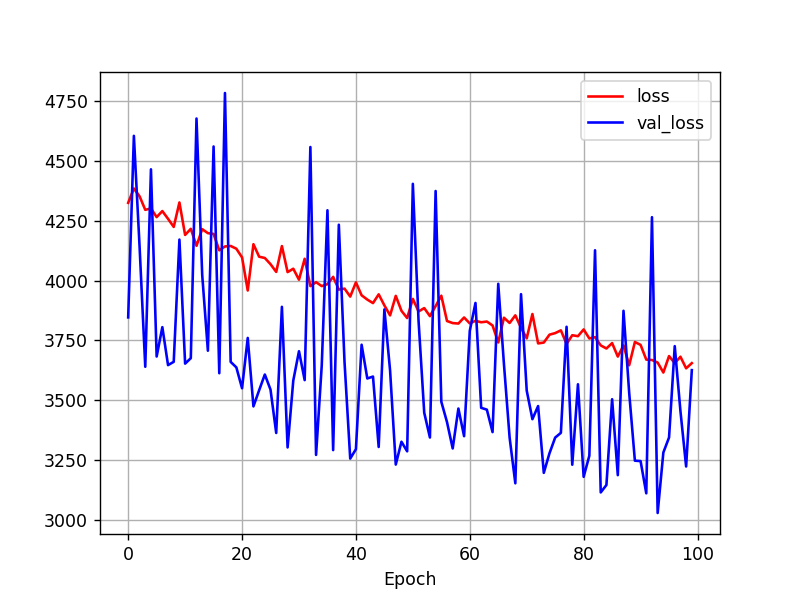

<AxesSubplot:xlabel='Epoch'>

In [261]:
df.loc[:,["loss","val_loss"]].plot( grid=True, xlabel="Epoch", style=["r-","b-"])

<IPython.core.display.Javascript object>


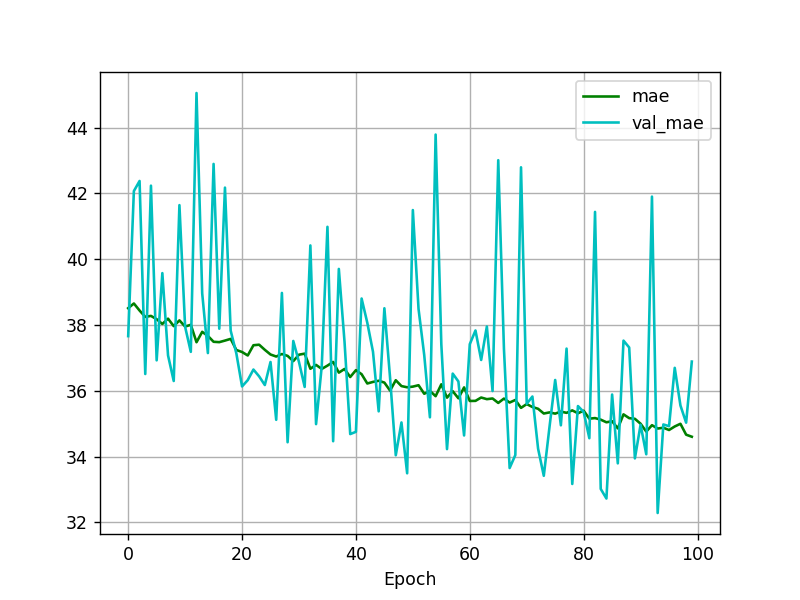

<AxesSubplot:xlabel='Epoch'>

In [262]:
df.loc[:,["mae","val_mae"]].plot( grid=True, xlabel="Epoch", style=["g-","c-"])

Observations :
- Mean Absolut Error (MAE) décroit à chaque itération pour les données d'entrainement: Le modèle apprend à minimiser l'erreur sur les données d'entraînement, ce qui indique qu'il améliore ses prédictions pour les données qu'il a vues.
- Les fortes variations de Mean Absolut Error (MAE) à chaque itération pour les données de validation: indiquent qu'il pourrait ne pas bien se généraliser aux données non vues. C'est peut être un signe de surapprentissage (overfitting).

<mark> On peut l'éviter en modifiant les paramètres du réseau de neuronne </mark>

## Partie 5 : Recherches des hyperparamètres

Nous nous concentrerons sur les meilleurs modèles :
- K Nearest Neighbors
- Gradient Boosting
- Random Forest


Nous payerons de l'attention à ce que les modèles tester ne soit pas en surapprentissage (overfitting).

Comme annoncé dans la partie de séparation des données nous prioriserons une séparation des données de façon chronologique dans cette partie (bien qu'il pourra être intéressant de la comparer avec une séparation aléatoire).

In [177]:
from sklearn.model_selection import cross_validate

### 1. K Nearest Neighbors

In [25]:
from sklearn.neighbors import KNeighborsRegressor

L'objectif de cette partie est de déterminer la valeur de l'hyperparamètre K (le nombre de voisin nécessaire à une prédiction)

Comme souvent il va falloir trouver un compromis entre biais et variance :
- Un **petit K** permet d'avoir un modèle de variance importante et le modèle s'adapte bien au donnée d'entrainement, peut être trop et prédit moins bien les données de validation. Dans ce cas le modèle est surentraîné : on dit qu'il fait de l'**overfitting**
-  Un **grand K** permet d'avoir un modèle de grand biais : il généralise mieux le modèle et donc prédit bien les données de validation mais risque de moins bien prédire les variations. Un modèle trop simple et qui ne capture plus bien les tendances des données est sous-entraîné : on dit qu'il fait de l'**underfitting**

#### Séparation aléatoirement

In [61]:
features_list = ['radius', 'high_emission_week']

y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_split(X_transformed, y, test_size=0.2, random_state=42)

In [62]:
# Liste des différentes valeurs de K à tester
k_range = range(1,40)

In [63]:
df_error= pd.DataFrame(index= k_range)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

# Essayer K de 1 à 20
for k in k_range:
    knn = KNeighborsRegressor(n_neighbors=k)
    knn.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = knn.predict(X_train)
    val_predictions = knn.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[k, "rmse_train_errors"] = train_rmse
    df_error.at[k, "rmse_val_errors"] = val_rmse
    df_error.at[k, "r2_train_errors"] = train_r2
    df_error.at[k, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


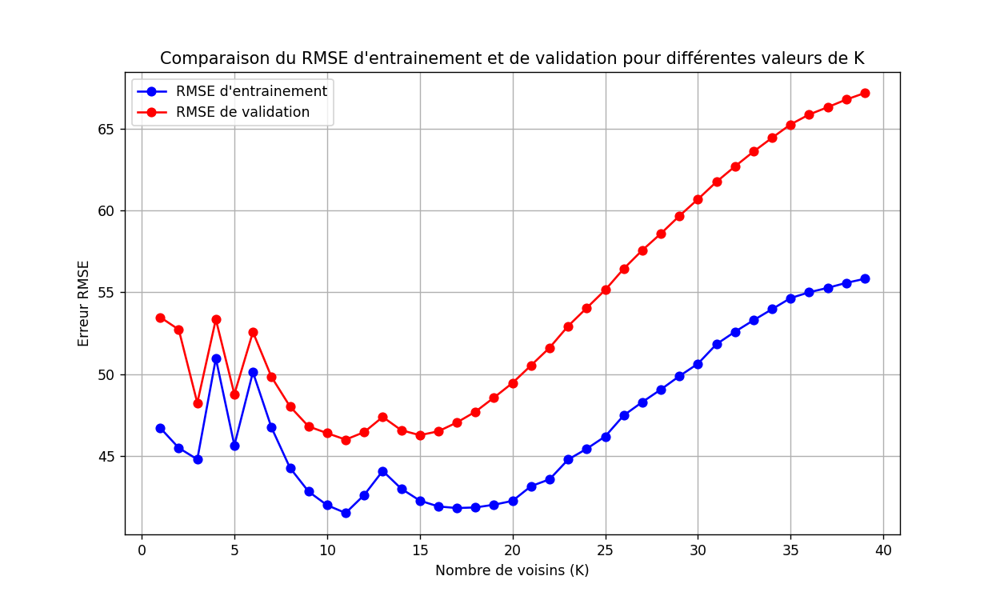

In [64]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('Nombre de voisins (K)')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de K')
plt.legend()
plt.grid(True)
plt.show()

- Pour K <= 6 : le modèle à une trop grande variance et les données de validations sont mal prédites
- Pour K >= 20 : le modèle à un biais trop important et ce met à trop généraliser le modèle et prédit mal les données d'entrainement

Les meilleurs K sont 11 et 17

<IPython.core.display.Javascript object>


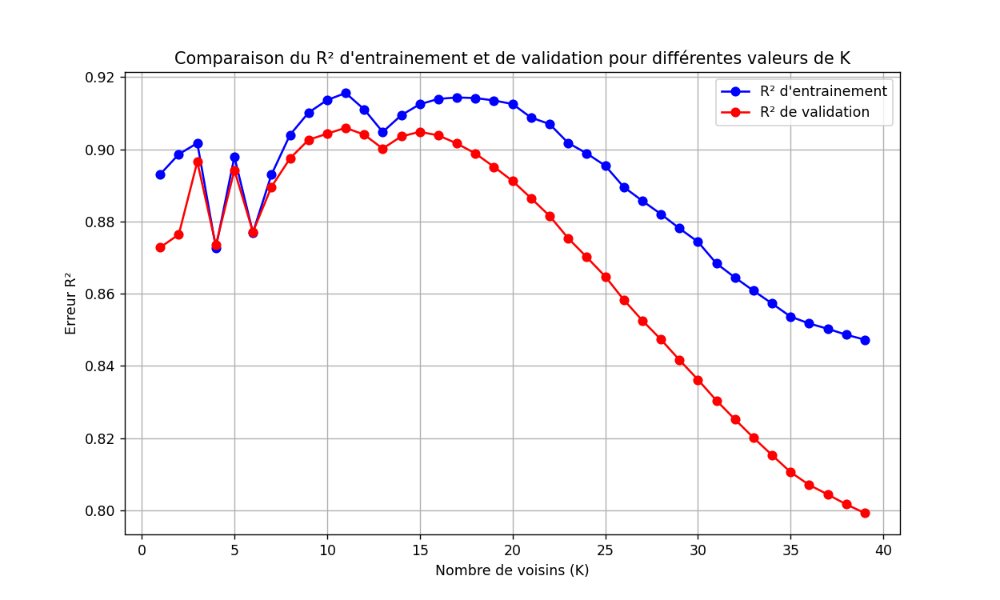

In [65]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('Nombre de voisins (K)')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de K')
plt.legend()
plt.grid(True)
plt.show()

Un K trop faible pourrait entrainer un surapprentissage.

In [66]:
print(f'Le K qui minimise le RMSE est : {df_error["rmse_val_errors"].idxmin()}')
print(f'Le K qui maximise le R² est : {df_error["r2_val_errors"].idxmax()}')

Le K qui minimise le RMSE est : 11
Le K qui maximise le R² est : 11


#### Séparation chronologiquement

In [127]:
features_list = ['radius', 'high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [128]:
# Liste des différentes valeurs de K à tester
k_range = range(1,40)

In [129]:
df_error= pd.DataFrame(index= k_range)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

# Essayer K de 1 à 20
for k in k_range:
    knn = KNeighborsRegressor(n_neighbors=k)
    knn.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = knn.predict(X_train)
    val_predictions = knn.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[k, "rmse_train_errors"] = train_rmse
    df_error.at[k, "rmse_val_errors"] = val_rmse
    df_error.at[k, "r2_train_errors"] = train_r2
    df_error.at[k, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


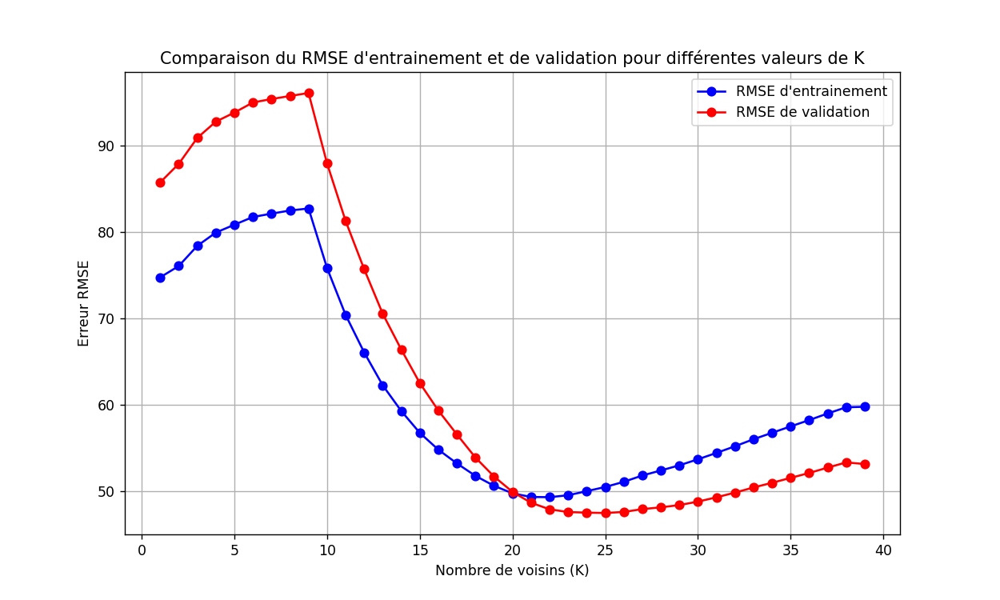

In [130]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('Nombre de voisins (K)')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de K')
plt.legend()
plt.grid(True)
plt.show()

- Pour K <= 9 : le modèle à une trop grande variance et les données de validations sont mal prédites
- Pour K >= 25 : le modèle à un biais trop important et ce met à trop généraliser le modèle et prédit mal les données d'entrainement

On remarque qu'on a plus de mal à prédire les données de validation puisqu'on les à choisit chronologiquement et donc potentiellement moins proche des données d'entrainement.

Cette séparation de donnée est plus approprié que la distribution aléatoire et devra donc peser plus lourd dans la balance en ce qui concerne le choix de l'hyperparamètre K.

<IPython.core.display.Javascript object>


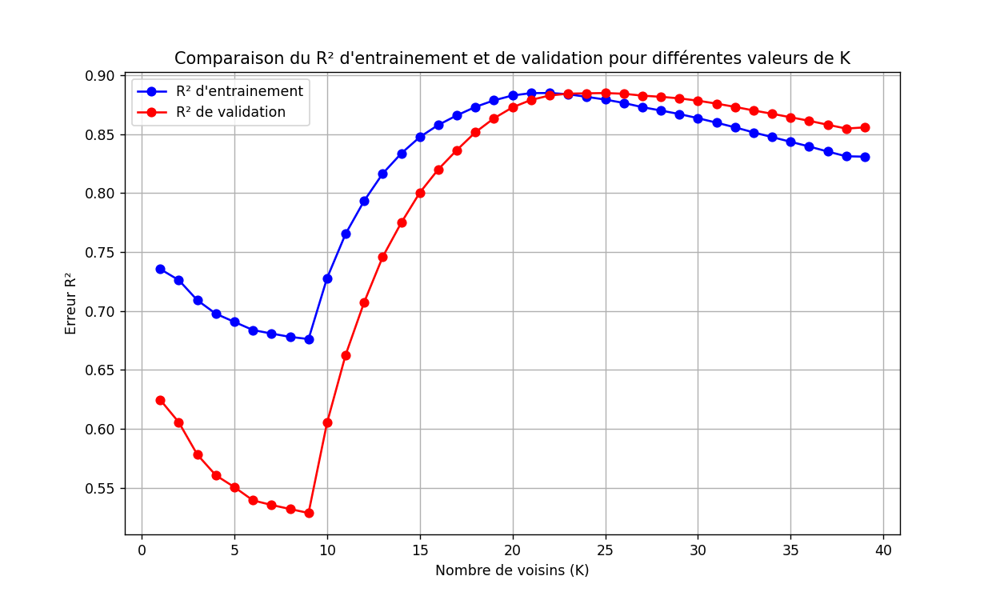

In [131]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('Nombre de voisins (K)')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de K')
plt.legend()
plt.grid(True)
plt.show()

In [132]:
print(f'Le K qui minimise le RMSE est : {df_error["rmse_val_errors"].idxmin()}')
print(f'Le K qui maximise le R² est : {df_error["r2_val_errors"].idxmax()}')

Le K qui minimise le RMSE est : 25
Le K qui maximise le R² est : 25


**K = 19** semble être un bon choix d'hyperparamètre qui s'adapte au deux distribution de donnée et permet de faire un bon compromis entre biais et variance.

In [133]:
df_error[df_error.index==19]

,rmse_train_errors,rmse_val_errors,r2_train_errors,r2_val_errors
19,50.643014,51.722407,0.878629,0.8634


- rmse_val_errors = 51.7
- r2_val_errors = 0.86

### 2. Gradient Boosting

In [73]:
from sklearn.ensemble import GradientBoostingRegressor

Nous résonnnerons analogiquement pour trouver un compromis entre biais et variance pour les mêmes raisons que vu précédement

#### Learning Rate

Séparation chronologiquement

In [80]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [102]:
learning_rate= [0.01, 0.05, 0.1, 0.2, 0.3, 0.5, 0.75, 1, 1.25, 1.5, 1.6, 1.7, 1.8, 1.9]
n_estimators=75
max_depth=5

In [103]:
df_error= pd.DataFrame(index= learning_rate)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

for lr in learning_rate:
    gbr = GradientBoostingRegressor(n_estimators=n_estimators, learning_rate=lr, max_depth=max_depth)
    gbr.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = gbr.predict(X_train)
    val_predictions = gbr.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[lr, "rmse_train_errors"] = train_rmse
    df_error.at[lr, "rmse_val_errors"] = val_rmse
    df_error.at[lr, "r2_train_errors"] = train_r2
    df_error.at[lr, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


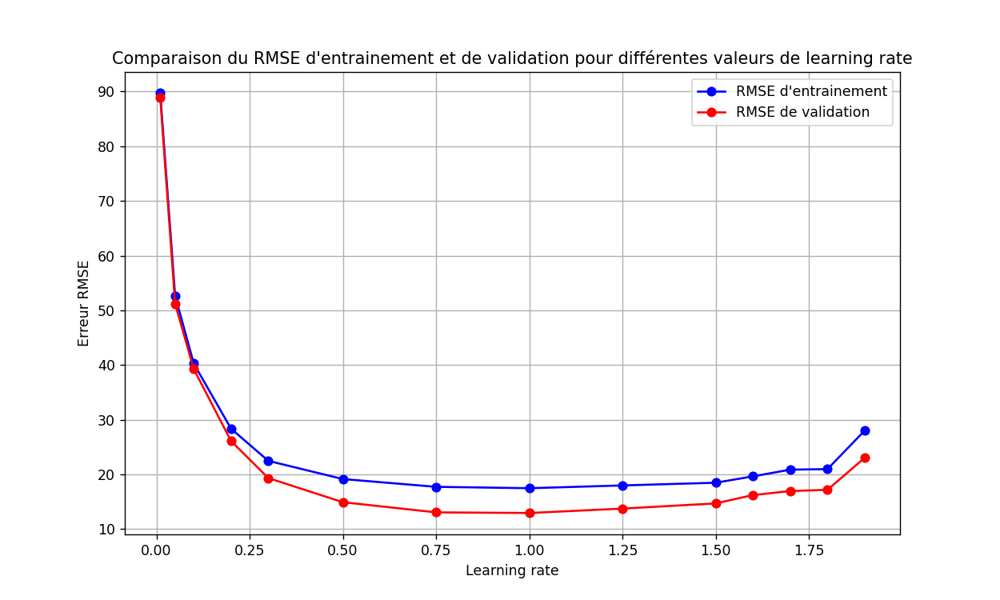

In [104]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('Learning rate')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de learning rate')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


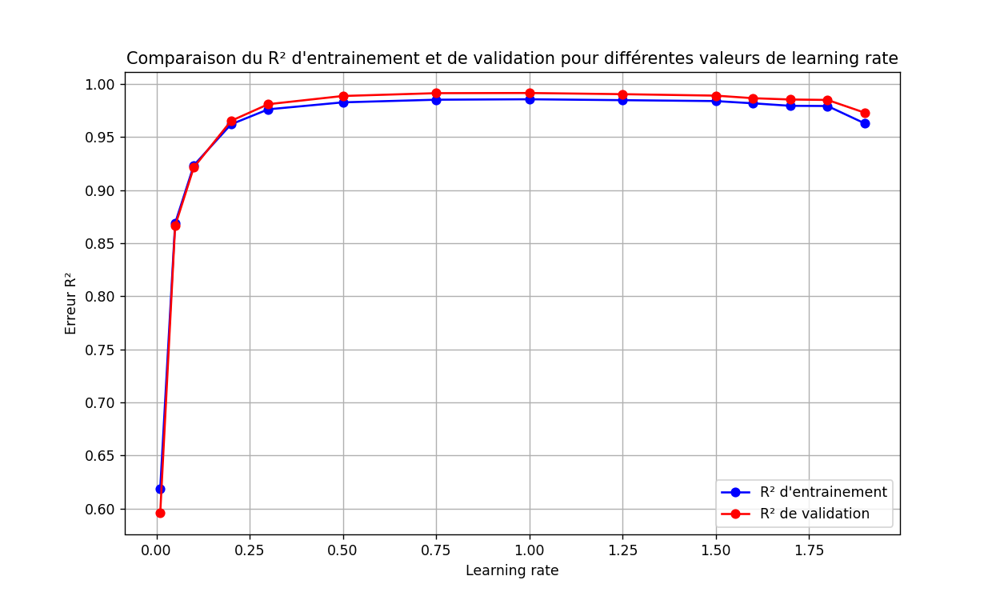

In [105]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('Learning rate')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de learning rate')
plt.legend()
plt.grid(True)
plt.show()

#### n_estimators

Séparation chronologiquement

In [134]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [135]:
learning_rate= 1
n_estimators=range(10,200, 20)
max_depth=5

In [136]:
df_error= pd.DataFrame(index= n_estimators)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

for e in n_estimators:
    gbr = GradientBoostingRegressor(n_estimators=e, learning_rate=learning_rate, max_depth=max_depth)
    gbr.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = gbr.predict(X_train)
    val_predictions = gbr.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[e, "rmse_train_errors"] = train_rmse
    df_error.at[e, "rmse_val_errors"] = val_rmse
    df_error.at[e, "r2_train_errors"] = train_r2
    df_error.at[e, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


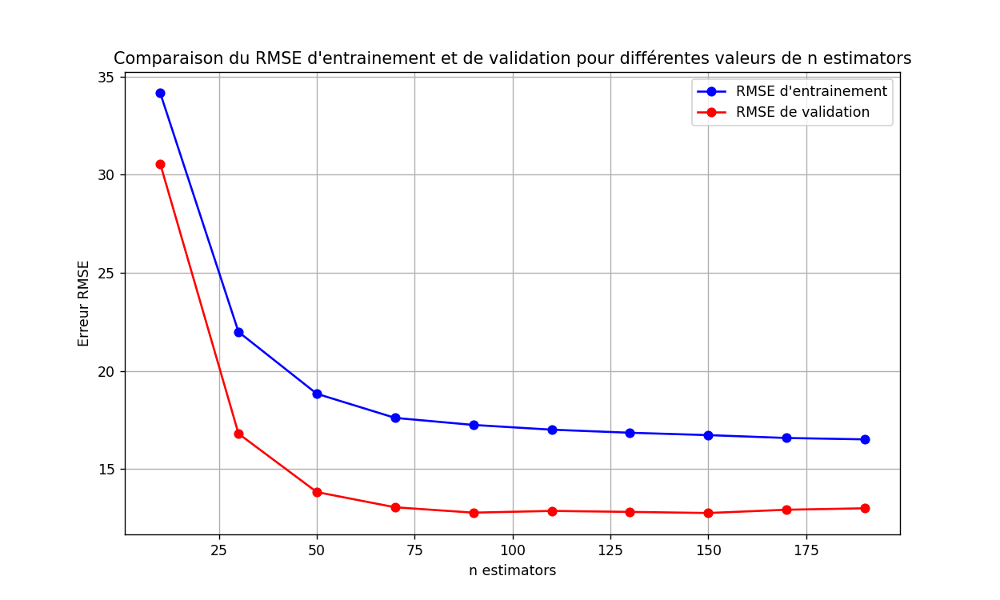

In [137]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('n estimators')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de n estimators')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


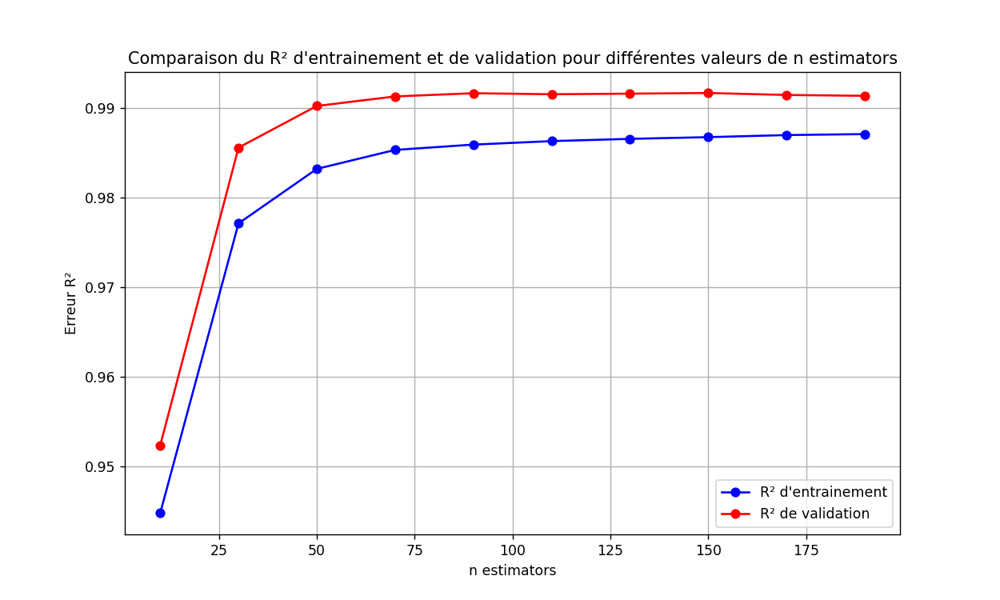

In [138]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('n estimators')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de n estimators')
plt.legend()
plt.grid(True)
plt.show()

#### max_depth

Séparation chronologiquement

In [139]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [140]:
learning_rate= 1
n_estimators=75
max_depth= range(1,20)

In [141]:
df_error= pd.DataFrame(index= max_depth)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

for md in max_depth:
    gbr = GradientBoostingRegressor(n_estimators=n_estimators, learning_rate=learning_rate, max_depth=md)
    gbr.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = gbr.predict(X_train)
    val_predictions = gbr.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[md, "rmse_train_errors"] = train_rmse
    df_error.at[md, "rmse_val_errors"] = val_rmse
    df_error.at[md, "r2_train_errors"] = train_r2
    df_error.at[md, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


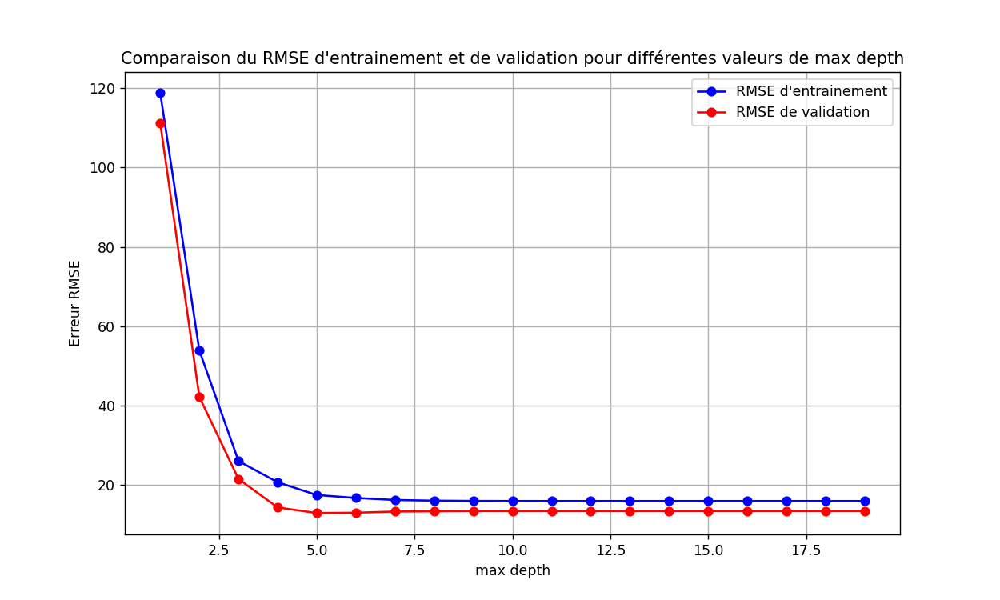

In [142]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('max depth')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de max depth')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


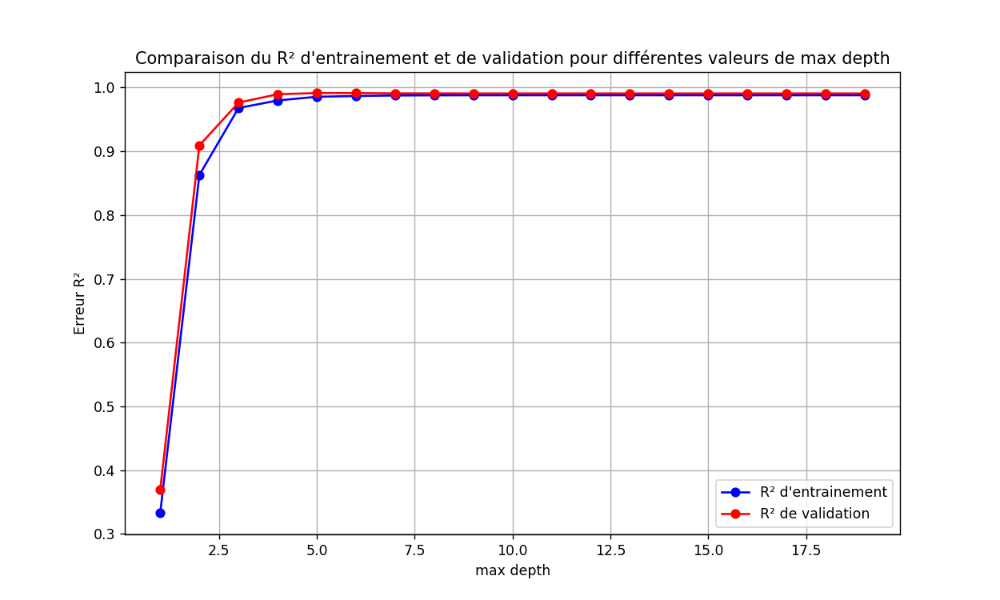

In [143]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('max depth')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de max depth')
plt.legend()
plt.grid(True)
plt.show()

On choisit les hyperparamètres:
- learning_rate = 1
- n_estimators = 75
- max_depth = 5

In [144]:
df_error[df_error.index==5]

,rmse_train_errors,rmse_val_errors,r2_train_errors,r2_val_errors
5,17.480246,12.947014,0.98554,0.991441


- rmse_val_errors = 12.9
- r2_val_errors = 0.99

### 3. Random Forest

In [115]:
from sklearn.ensemble import RandomForestRegressor

#### n_estimators

Séparation chronologiquement

In [116]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [157]:
n_estimators=range(10,200, 20)
max_depth=15

In [158]:
df_error= pd.DataFrame(index= n_estimators)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

for e in n_estimators:
    rfr = RandomForestRegressor(n_estimators=e, max_depth=max_depth, random_state=42)
    rfr.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = rfr.predict(X_train)
    val_predictions = rfr.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[e, "rmse_train_errors"] = train_rmse
    df_error.at[e, "rmse_val_errors"] = val_rmse
    df_error.at[e, "r2_train_errors"] = train_r2
    df_error.at[e, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


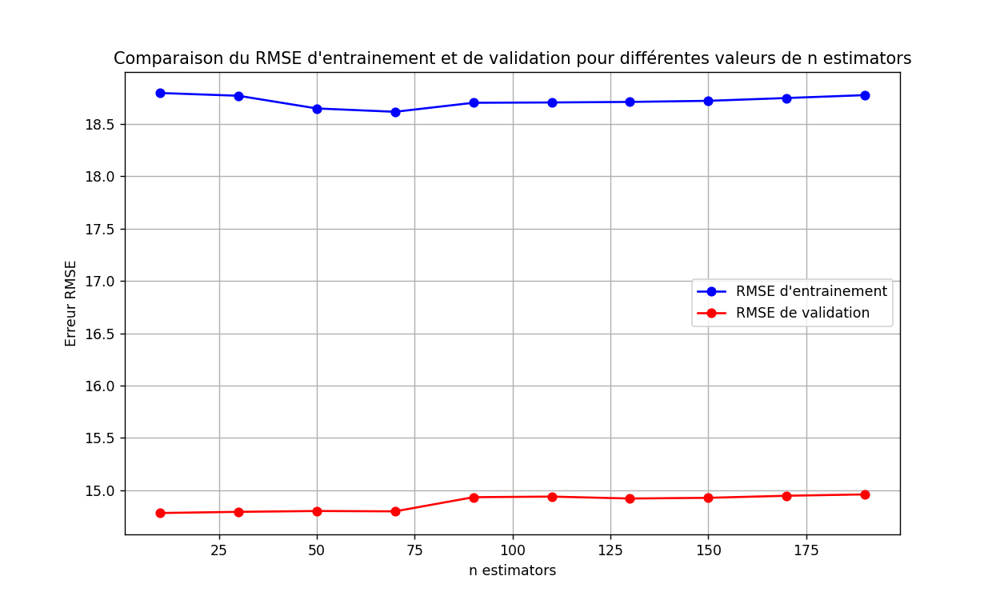

In [159]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('n estimators')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de n estimators')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


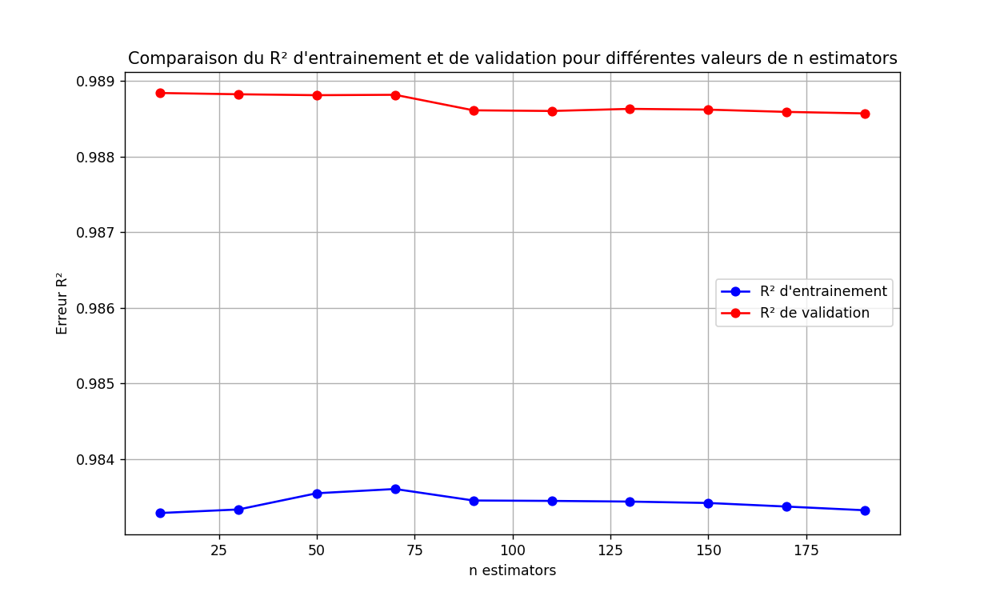

In [160]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('n estimators')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de n estimators')
plt.legend()
plt.grid(True)
plt.show()

#### max_depth

Séparation chronologiquement

In [151]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

X_train, X_val, y_train, y_val = train_test_chrono_split(X_transformed, y)

In [161]:
learning_rate= 1
n_estimators=70
max_depth= range(1,20)

In [162]:
df_error= pd.DataFrame(index= max_depth)
df_error ["rmse_train_errors"] = 0
df_error ["rmse_val_errors"] = 0

df_error ["r2_train_errors"] = 0
df_error ["r2_val_errors"] = 0

for md in max_depth:
    rfr = RandomForestRegressor(n_estimators=n_estimators, max_depth=md, random_state=42)
    rfr.fit(X_train, y_train)

    # Calcul de l'erreur d'entraînement et de validation
    train_predictions = rfr.predict(X_train)
    val_predictions = rfr.predict(X_val)
    
    train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
    val_rmse = mean_squared_error(y_val, val_predictions, squared=False)
    
    train_r2 = r2_score(y_train, train_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    df_error.at[md, "rmse_train_errors"] = train_rmse
    df_error.at[md, "rmse_val_errors"] = val_rmse
    df_error.at[md, "r2_train_errors"] = train_r2
    df_error.at[md, "r2_val_errors"] = val_r2

<IPython.core.display.Javascript object>


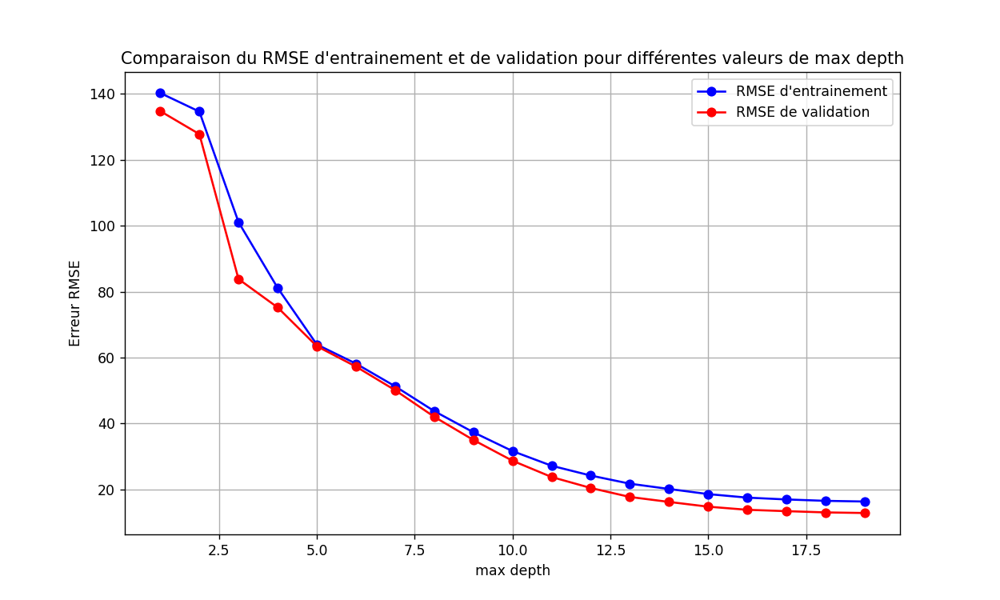

In [163]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["rmse_train_errors"], label='RMSE d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["rmse_val_errors"], label='RMSE de validation', color='red', marker='o')
plt.xlabel('max depth')
plt.ylabel('Erreur RMSE')
plt.title('Comparaison du RMSE d\'entrainement et de validation pour différentes valeurs de max depth')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


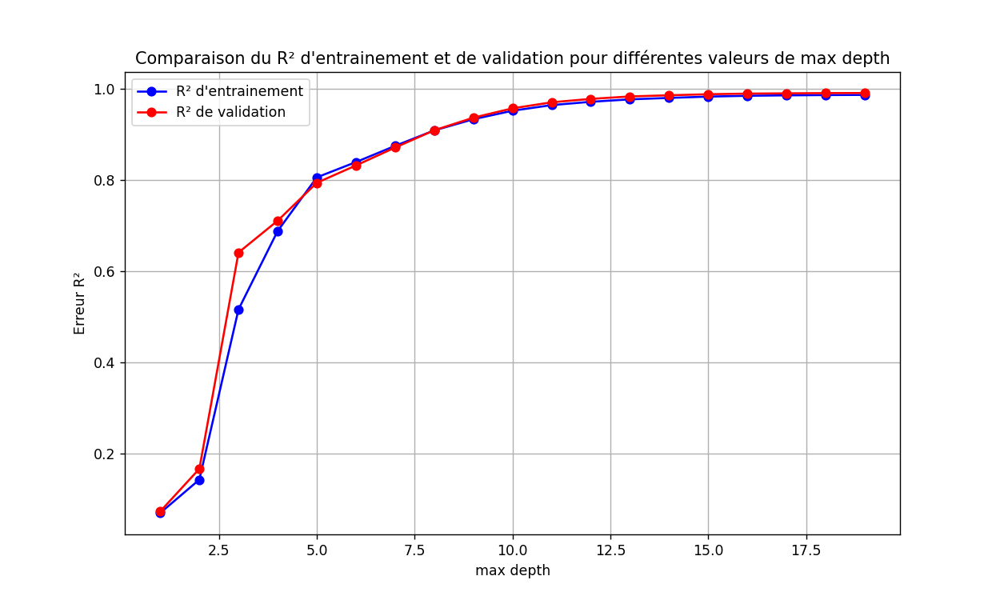

In [164]:
# Tracer les courbes d'erreur
plt.figure(figsize=(10, 6))
plt.plot(df_error.index, df_error["r2_train_errors"], label='R² d\'entrainement', color='blue', marker='o')
plt.plot(df_error.index, df_error["r2_val_errors"], label='R² de validation', color='red', marker='o')
plt.xlabel('max depth')
plt.ylabel('Erreur R²')
plt.title('Comparaison du R² d\'entrainement et de validation pour différentes valeurs de max depth')
plt.legend()
plt.grid(True)
plt.show()

On choisit les hyperparamètres :
- n_estimators = 70
- max_depth = 15

Avec un max_depth > 15 il y a un risque d'overfitting sans vraiment augmenter la performance du modèle.

In [165]:
df_error[df_error.index==15]

,rmse_train_errors,rmse_val_errors,r2_train_errors,r2_val_errors
15,18.6146,14.79898,0.983602,0.988817


- rmse_val_errors = 14.8
- r2_val_errors = 0.99

## Partie 6 : Comparaisons des différents modèles

### 1. Cross Validation

Utilise cross_val_score pour tester si la performance se généralise bien.

On n'ulisera pas Cross Validation pour comparer les modèles puisqu'on privilégie une distribution chronologique à une distribution aléatoire.

In [173]:
from sklearn.model_selection import cross_validate

#### 1. K Nieghbors Regressor best model

In [174]:
from sklearn.neighbors import KNeighborsRegressor

In [175]:
features_list = ['radius', 'high_emission_week']

y=data_train['emission'].copy()
X=data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [176]:
model_knr = KNeighborsRegressor(n_neighbors=19)

In [177]:
KNR_cv = cross_validate(estimator=model_knr, X=X_transformed, y=y, cv=10,scoring='neg_mean_squared_error',return_train_score=True)
score_knr=np.sqrt(abs(KNR_cv['test_score']))
score_knr

array([76.0660788 , 48.29677067, 46.31482383, 50.57042409, 63.61108407,
       53.8027548 , 50.18650424, 45.31188055, 54.50845978, 49.34475585])

KNN:
- rmse_val_errors = 51.7
- r2_val_errors = 0.86

Pas d'overfitting !

#### 2. Gradient Boosting Regressor best model

In [180]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [181]:
model_gbr = GradientBoostingRegressor(n_estimators=75, learning_rate=1, max_depth=5)

In [183]:
gradient_boosting_cv = cross_validate(estimator=model_gbr, X=X_transformed, y=y, cv=10,scoring='neg_mean_squared_error',return_train_score=True)
score_gbr=np.sqrt(abs(gradient_boosting_cv['test_score']))
score_gbr

array([25.79618669, 23.10515544, 16.89801774, 23.23928045, 43.16222927,
       16.61596098, 18.40937207, 27.38280979, 11.58083292, 14.90500344])

Gradient Boosting:
- rmse_val_errors = 12.9
- r2_val_errors = 0.99

Modèle un peu sur-estimé mais fonctionne bien !

#### 3. Random Forest Regressor best model

In [187]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y =data_train['emission'].copy()
X =data_train[features_list].copy()
X_transformed = num_pipeline.fit_transform(X)

In [188]:
model_rfr = RandomForestRegressor(n_estimators=70, max_depth=15, random_state=42)

In [189]:
random_forest_cv = cross_validate(estimator=model_rfr, X=X_transformed, y=y, cv=10, scoring='neg_mean_squared_error',return_train_score=True)
score_rfr=np.sqrt(abs(random_forest_cv['test_score']))
score_rfr

array([23.44843913, 25.04861819, 18.76537399, 18.94227097, 42.78056299,
       18.29422845, 19.10587347, 26.49506224, 13.6712212 , 16.50536964])

Random Forest
- rmse_val_errors = 14.8
- r2_val_errors = 0.99

Modèle un peu sur-estimé mais fonctionne bien !

### 2. Comparaison des modèles

#### Comparaison graphique

<IPython.core.display.Javascript object>


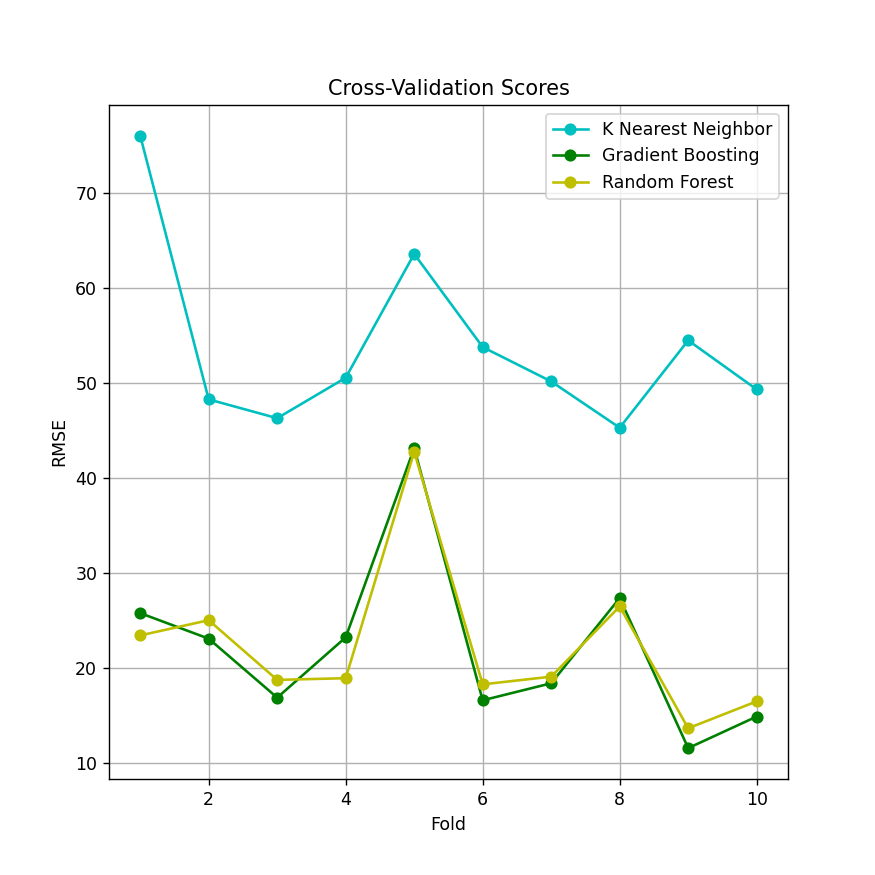

In [190]:
# Plot cross-validation scores
plt.figure(figsize=(7, 7))
plt.plot(np.arange(1, 11), score_knr, marker='o', linestyle='-', color='c', label='K Nearest Neighbor')
plt.plot(np.arange(1, 11), score_gbr, marker='o', linestyle='-', color='g', label='Gradient Boosting')
plt.plot(np.arange(1, 11), score_rfr, marker='o', linestyle='-', color='y', label='Random Forest')
plt.title('Cross-Validation Scores')
plt.xlabel('Fold')
plt.ylabel('RMSE')
plt.legend()
plt.grid(True)
plt.show()

Gradient Boosting et Random forest sont les deux meilleurs modèles. Départageons les.

#### Comparaison des modèles 2 à 2

In [191]:
def compare(cv1, cv2):
    scores = cv2 - cv1
    n = 0
    for score in scores:
        if score > 0:
            n += 1
    return n

In [194]:
compare(score_rfr, score_gbr)

4

In [198]:
score_rfr.mean() > score_gbr.mean()

True

Le meilleur modèle est donc **gradient boosting**.

### 3. Final submission 

In [201]:
data_test = pd.read_csv("test.csv")
data_test.head()

,ID_LAT_LON_YEAR_WEEK,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,...,Cloud_cloud_top_pressure,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle
0,ID_-0.510_29.290_2022_00,-0.51,29.29,2022,0,NaN,NaN,NaN,NaN,NaN,...,36022.027344,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583
1,ID_-0.510_29.290_2022_01,-0.51,29.29,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,...,48539.737242,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380
2,ID_-0.510_29.290_2022_02,-0.51,29.29,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,...,34133.080469,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361
3,ID_-0.510_29.290_2022_03,-0.51,29.29,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,...,50854.991076,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774
4,ID_-0.510_29.290_2022_04,-0.51,29.29,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,...,46594.685145,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807


#### Séparons les caractéristiques et l'étiquette pour les données d'entrainement

In [202]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

y_train =data_train['emission'].copy()
X_train =data_train[features_list].copy()
X_train_transformed = num_pipeline.fit_transform(X_train)

#### Séparons les caractéristiques et l'étiquette pour les données test

In [203]:
#ajout du rayon au donnée test
x0 = 29.75
y0 = -1.8
radius = np.sqrt( (data_test['longitude']-x0)**2 + (data_test['latitude']-y0)**2 )
data_test["radius"]= radius

#ajout des semaines de forte consommation
data_test['high_emission_week']= ((data_test['week_no']>=14) * (data_test['week_no']<=16) + (data_test['week_no']>=39) * (data_test['week_no']<=43))*1 

#ajout de la caractéristique combinée
data_test['radius * high_emission_week'] = data_test['radius'] * data_test['high_emission_week'] 

In [205]:
features_list = ['latitude', 'longitude','radius', 'high_emission_week', 'week_no', 'radius * high_emission_week']

X_test =data_test[features_list].copy()
X_test_transformed = num_pipeline.fit_transform(X_test)

#### On entraine notre meilleur modèle

In [207]:
best_model = GradientBoostingRegressor(n_estimators=75, learning_rate=1, max_depth=5)
best_model.fit(X_train_transformed, y_train)

predictions = best_model.predict(X_test_transformed)

 #### Faire une submission Kaggle

In [208]:
#Create a  DataFrame with the passengers ids and our prediction regarding whether they survived or not
submission = pd.DataFrame({'ID_LAT_LON_YEAR_WEEK':data_test['ID_LAT_LON_YEAR_WEEK'],'emission':predictions})

#Visualize the first 5 rows
submission.head()

,ID_LAT_LON_YEAR_WEEK,emission
0,ID_-0.510_29.290_2022_00,5.986939
1,ID_-0.510_29.290_2022_01,0.498962
2,ID_-0.510_29.290_2022_02,3.490842
3,ID_-0.510_29.290_2022_03,3.317360
4,ID_-0.510_29.290_2022_04,4.505577


In [209]:
#Convert DataFrame to a csv file that can be uploaded
#This is saved in the same directory as your notebook
filename = "CO2 Emission Rwanda prediction.csv"

submission.to_csv(filename,index=False)

print('Saved file: ' + filename)

Saved file: CO2 Emission Rwanda prediction.csv


In [210]:
!kaggle competitions submit -c playground-series-s3e20 -f "CO2 Emission Rwanda prediction.csv" -m first_submission

400 - Bad Request



  0%|          | 0.00/1.03M [00:00<?, ?B/s]
  8%|7         | 80.0k/1.03M [00:00<00:01, 731kB/s]
 17%|#6        | 176k/1.03M [00:00<00:01, 871kB/s] 
 49%|####9     | 520k/1.03M [00:00<00:00, 1.98MB/s]
100%|##########| 1.03M/1.03M [00:01<00:00, 981kB/s]


Il ne semble pas que la competition de prediction soit encore ouvert donc on ne pourra pas obtenir un score évaluant notre modèle